In [ ]:
# !pip install --upgrade --pre xgboost # Needed for gpu used with feature_weights, at least on kaggle.

In [1]:
from __future__ import print_function
from __future__ import division

from typing import List, Optional, Iterable, Union, Dict

import os
import pandas as pd
import numpy as np
import re
import itertools


from matplotlib import pyplot as plt
import seaborn as sns

from sklearn import metrics
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error, mean_squared_error

import xgboost as xgb
from xgboost.sklearn import XGBClassifier
import optuna

import copy
from itertools import combinations

from numba import cuda

from warnings import filterwarnings
filterwarnings('ignore')

from scipy.signal import medfilt

import pickle

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.


/home/tfc/anaconda3/envs/DD_dengue/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import torch

# Check if CUDA (GPU) is available
if torch.cuda.is_available():
    # Get the number of GPUs available
    num_gpus = torch.cuda.device_count()
    print(f"Number of GPUs available: {num_gpus}")

    # Iterate over available GPUs and print their names
    for i in range(num_gpus):
        gpu_name = torch.cuda.get_device_name(i)
        print(f"GPU {i}: {gpu_name}")
else:
    print("CUDA is not available. Running on CPU.")

Number of GPUs available: 1
GPU 0: NVIDIA GeForce RTX 4080 SUPER


### Helpers

In [3]:
def preprocess(df_features_or: pd.DataFrame,
               labels=None,
               features_to_keep: Optional[Iterable[str]] = None,
               lagged_features: Optional[Union[Iterable[str],Dict[str, Iterable[str]]]] = None,
               fillna: Optional[str] = None,
               circular_weekofyear: bool = False,
               feature_lags=None,
               label_lags=None):
    '''
    Add lagged features or target values as needed, accounting for existence of two cities in dataset.
    fillna: Fill NaN approach, e.g. 'ffill'. None to not fill.
    '''

    df_features = df_features_or.copy()
    df_features = df_features.reset_index()

    if features_to_keep is not None:         # Filter features
        feature_names = features_to_keep + ['city']
        df_features = df_features[feature_names]
    else:
        feature_names = list(df_features.columns)

    if fillna is not None:                   # Fill NaNs
        df_features.fillna(method=fillna, inplace=True)

    # Convert city feature to categorical and one hot encode
    df_features["city"] = df_features["city"].astype("category")
    df_features = pd.get_dummies(df_features, columns=['city'], drop_first=True)

    # Create circular week of year. #TEMP: update again
    if circular_weekofyear:
        df_features['weekofyear1'] = np.sin((df_features['weekofyear']-1)/51*2*np.pi)
        df_features['weekofyear2'] = np.cos((df_features['weekofyear']-1)/51*2*np.pi)
        df_features.drop(columns=['weekofyear'],inplace=True)
        # df_features['weekofyear'] = np.sin((df_features['weekofyear']-1)/51*np.pi)
        
    # Split cities before adding lags
    sj_features = df_features[df_features['city_sj']]
    iq_features = df_features[~df_features['city_sj']]

    if labels is not None:
        sj_labels = labels[df_features['city_sj']]
        iq_labels = labels[~df_features['city_sj']]
    else:
        sj_labels = None        
        iq_labels = None

    # Lagged feature/labels creation
    if (lagged_features is not None) or (label_lags is not None):
        # Add lagged features
        if isinstance(lagged_features,dict):                # Do individual lags for different features
            for feat, feat_lags in lagged_features.items():
                sj_features_lagged = sj_features[feat].shift(periods=feat_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feat_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)
        elif isinstance(lagged_features, (list, tuple)):    # All considered features has same lags
            for feat in lagged_features:
                if 'total_cases' in feat:                   # Skip all total_cases features, used when preprocessing pred features
                    continue
                sj_features_lagged = sj_features[feat].shift(periods=feature_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feature_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)

        # Add lagged labels
        if label_lags is not None:
            sj_lagged_labels = sj_labels.shift(periods=label_lags)
            sj_features = pd.concat([sj_features,sj_lagged_labels],axis=1)
            iq_lagged_labels = iq_labels.shift(periods=label_lags)
            iq_features = pd.concat([iq_features,iq_lagged_labels],axis=1)
  
    return sj_features, iq_features, sj_labels, iq_labels

def prep_data(sj_features:pd.DataFrame, iq_features:pd.DataFrame,
              sj_labels:pd.DataFrame, iq_labels:pd.DataFrame,
              folds=6, fold_size=0.15):
    '''
    To prepare multiple folds for k-fold, without randomization to preserve time series sequence.
    sj_features: Dataframe of processed input for San Juan
    iq_features: Dataframe of processed input for Iquitos
    sj_labels: Labels for San Juan
    iq_labels: Labels for Iquitos
    '''

    # K-fold with sequential splits, 6 folds, with early data kept out
    X_train_sj, X_val_sj, y_train_sj, y_val_sj = [], [], [], []
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = [], [], [], []
    sj_size = len(sj_features)
    iq_size = len(iq_features)
    sj_fold_size = round(fold_size*sj_size)
    iq_fold_size = round(fold_size*iq_size)
    sj_train_features_temp = sj_features.copy()
    iq_train_features_temp = iq_features.copy()
    sj_train_labels_temp = sj_labels.copy()
    iq_train_labels_temp = iq_labels.copy()

    for _ in range(folds):
        # Add to X_val
        X_val_sj.append(sj_train_features_temp.iloc[-sj_fold_size:,:])
        sj_train_features_temp.drop(sj_train_features_temp.index[-sj_fold_size:],inplace=True)
        X_val_iq.append(iq_train_features_temp.iloc[-iq_fold_size:,:])
        iq_train_features_temp.drop(iq_train_features_temp.index[-iq_fold_size:],inplace=True)
        
        # Add to y_val
        y_val_sj.append(sj_train_labels_temp.iloc[-sj_fold_size:,:])
        sj_train_labels_temp.drop(sj_train_labels_temp.index[-sj_fold_size:],inplace=True)
        y_val_iq.append(iq_train_labels_temp.iloc[-iq_fold_size:,:])
        iq_train_labels_temp.drop(iq_train_labels_temp.index[-iq_fold_size:],inplace=True)

    # Create X_train and y_train
    X_train_sj_components = copy.deepcopy(X_val_sj)
    X_train_iq_components = copy.deepcopy(X_val_iq)
    y_train_sj_components = copy.deepcopy(y_val_sj)
    y_train_iq_components = copy.deepcopy(y_val_iq)

    for i in range(folds):
        X_train_sj_components_temp = copy.deepcopy(X_train_sj_components)
        X_train_sj_components_temp.pop(i)
        X_train_sj_components_temp.append(copy.deepcopy(sj_train_features_temp))  # Remove 1 fold, add back remainder rows from earlier
        X_train_sj.append(pd.concat(X_train_sj_components_temp))

        y_train_sj_components_temp = copy.deepcopy(y_train_sj_components)
        y_train_sj_components_temp.pop(i)
        y_train_sj_components_temp.append(copy.deepcopy(sj_train_labels_temp))  # Remove 1 fold, add back remainder rows from earlier
        y_train_sj.append(pd.concat(y_train_sj_components_temp))

        X_train_iq_components_temp = copy.deepcopy(X_train_iq_components)
        X_train_iq_components_temp.pop(i)
        X_train_iq_components_temp.append(copy.deepcopy(iq_train_features_temp))  # Remove 1 fold, add back remainder rows from earlier
        X_train_iq.append(pd.concat(X_train_iq_components_temp))

        y_train_iq_components_temp = copy.deepcopy(y_train_iq_components)
        y_train_iq_components_temp.pop(i)
        y_train_iq_components_temp.append(copy.deepcopy(iq_train_labels_temp))  # Remove 1 fold, add back remainder rows from earlier
        y_train_iq.append(pd.concat(y_train_iq_components_temp))

    return X_train_sj, X_val_sj, y_train_sj, y_val_sj, X_train_iq, X_val_iq, y_train_iq, y_val_iq

In [4]:
def create_XGBmodel(eta=0.01,n_estimators=1000,
                    max_depth=5,objective='reg:squarederror',
                    min_child_weight=1.02, gamma=0.51, subsample=0.86,
                    colsample_bytree=0.84, scale_pos_weight=1, seed=42,
                    **kwargs):
    '''
    Create an XGBRegressor model based on availability of GPU
    '''

    try:
        cuda.detect()
        gpu_available = cuda.is_available()
    except:
        gpu_available = False

    if gpu_available:
        return xgb.XGBRegressor(
            tree_method= 'gpu_hist',  # Use GPU accelerated algorithm
            n_gpus=1,
            device='cuda:0',
            learning_rate =eta,
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            gamma=gamma,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            objective= objective,
            scale_pos_weight=scale_pos_weight,
            seed=seed,
            **kwargs)
    else:
        return xgb.XGBRegressor(
            learning_rate =eta,
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            gamma=gamma,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            objective= objective,
            scale_pos_weight=scale_pos_weight,
            seed=seed,
            **kwargs)
    
def modelfit(alg, X_train, y_train, useTrainCV=True, cv_folds=5, early_stopping_rounds=50,trainCV_metrics = 'mae',
             eval_metric = 'mae',report_metric =  metrics.mean_absolute_error, verbose=True,
             weights=None, feature_weights = None):
    '''
    Automatically fit model, with option for using CV to get best n_estimators
    alg: XGBoost model
    weights: Weights for each data point
    feature_weights: Weights for each feature. Used here to reduce weights on lagged labels to reduce reliance on it.
    '''

    xgb_param = alg.get_xgb_params()
    xgtrain = xgb.DMatrix(X_train, label=y_train,feature_weights=feature_weights)
    xgtrain.set_info(feature_weights=feature_weights)

    if weights is not None:
        xgtrain.set_weight(weights)

    if useTrainCV:
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics=trainCV_metrics, early_stopping_rounds=early_stopping_rounds, verbose_eval=False)
        alg.set_params(n_estimators=cvresult.shape[0])
    
    #Fit the algorithm on the data
    alg.fit(X_train, y_train, feature_weights=feature_weights)
        
    #Predict training set:
    X_train_predictions = alg.predict(X_train)
        
    #Print model report:
    if verbose:
        print("\nModel Report")
        print(report_metric)
        print(report_metric(y_train, X_train_predictions))

def get_predictions(model, X_val,
                    label_lags: Optional[Iterable[int]]=None,
                    MC: Optional[int]=None):
    '''
    Get predictions using newly predicted labels as lagged labels.
    model: Trained XGBoost Regressor model
    X_val: Validation features
    label_lags: Label lags, None to signify no lagged labels used
    MC: Positive integer to use Monte Carlo-ish approach, small perturbations at every timestep. Currently only valid for Poisson distribution
    '''

    if label_lags is not None:
        if MC is None:
            X_val_no_lags = X_val.copy()
            lag_label_col_names = ['total_cases_'+str(lag) for lag in label_lags]                     # Lagged label names
            lag_label_col_locs = [X_val_no_lags.columns.get_loc(col) for col in lag_label_col_names]  # Get locations of lagged labels

            pred_val = np.zeros(X_val_no_lags.shape[0])
            for i in range(X_val_no_lags.shape[0]):
                pred_val[i] = model.predict(X_val_no_lags.iloc[i:i+1,:])                    # Predict current value, keep input in required dataframe format
                for k,j in enumerate(label_lags):                                           # Add predicted value to X_val as lagged labels for subsequent rows
                    try:
                        X_val_no_lags.iloc[i+j,lag_label_col_locs[k]] = pred_val[i]
                    except:
                        continue
        else:
            X_val_no_lags = X_val.copy()
            lag_label_col_names = ['total_cases_'+str(lag) for lag in label_lags]
            lag_label_col_locs = [X_val_no_lags.columns.get_loc(col) for col in lag_label_col_names]
            pred_val = np.zeros([X_val_no_lags.shape[0],MC])

            for l in range(MC):
                X_val_no_lags = X_val.copy()
                
                if l%20==0:
                    print(f'Step {l} of {MC} MC simulations')
                for i in range(X_val_no_lags.shape[0]):
                    lambda_ = model.predict(X_val_no_lags.iloc[i:i+1,:])                         # Get poisson lambda parameter
                    pred_val[i,l] = np.random.poisson(lambda_)                                   # Predict current value by taking a sample
                    for k,j in enumerate(label_lags):                                            # Add predicted value to X_val as lagged labels for subsequent rows
                        try:
                            X_val_no_lags.iloc[i+j,lag_label_col_locs[k]] = pred_val[i,l]
                        except:
                            continue
    else:
        pred_val = model.predict(X_val)
    pred_val = np.round(pred_val)
    pred_val = np.clip(pred_val, 0, 10000000)
    
    return pred_val

def eval_and_plot(model,X_train_all,y_train_all,X_val_all,y_val_all,
                  label_lags=None,
                  plot=True,verbose=True, MC=None,get_pred_train=True,
                  two_cities=False, median_filter: Optional[int]=None):
    '''
    Evaluate by predicting validation set and optionally plotting
    X_train: Dataframe of train features. Iterable of two dataframes if two_cities is True
    y_train: Dataframe of train labels. Iterable of two dataframes if two_cities is True
    X_val: Dataframe of val features. Iterable of two dataframes if two_cities is True
    y_val: Dataframe of val labels. Iterable of two dataframes if two_cities is True
    get_pred_train: True to calculate using previously predicted labels as lagged labels
    two_cities: Training model on both cities, requires splitting.
    median_filter: Apply median filtering to results.
    '''

    # If both cities trained together, input should be iterable of two datasets
    if two_cities:
        assert len(X_train_all)==2
        assert len(y_train_all)==2
        assert len(X_val_all)==2
        assert len(y_val_all)==2
    else:
        X_train_all = [X_train_all]
        y_train_all = [y_train_all]
        X_val_all = [X_val_all]
        y_val_all = [y_val_all]

    # Collect values separately for each city
    pred_train_all = []
    pred_val_all = []
    train_mae_all = []
    val_mae_all = []

    for X_train, y_train, X_val, y_val in zip(X_train_all, y_train_all, X_val_all, y_val_all):
        # Get predicted train values
        if get_pred_train:
            pred_train = get_predictions(model, X_train, label_lags, MC=MC)
        else:
            pred_train = model.predict(X_train)

        if median_filter is not None:
            pred_train = medfilt(pred_train,median_filter)

        pred_train = np.round(pred_train)
        pred_train = np.clip(pred_train, 0, 10000000)
        
        train_mae = mean_absolute_error(y_train, pred_train)
        if verbose:
            print("Train MAE:", train_mae)

        # Get prediction validation values
        pred_val = get_predictions(model, X_val, label_lags, MC=MC)

        if median_filter is not None:
            pred_val = medfilt(pred_val,median_filter)

        if MC is None:
            val_mae = mean_absolute_error(y_val, pred_val)
        else:
            val_mae = mean_absolute_error(y_val, np.mean(pred_val,axis=1))
        if verbose:
            print("Val MAE:", val_mae)
        
        pred_train_all.append(pred_train)
        pred_val_all.append(pred_val)
        train_mae_all.append(train_mae)
        val_mae_all.append(val_mae)

    if plot:
        for pred_train, pred_val, y_train, y_val, train_mae, val_mae in zip(pred_train_all, pred_val_all,y_train_all, y_val_all, train_mae_all, val_mae_all):
            fig, axs = plt.subplots(1,2,figsize=(8,2))
            fig2, axs2 = plt.subplots(2,1,figsize=(10,4))
            axs[0].scatter(y_train, pred_train)
            pred_train = pd.Series(pred_train, index=y_train.index)
            axs2[0].plot(np.arange(len(pred_train)), pred_train.sort_index(),marker='.',label='pred');
            axs2[0].plot(np.arange(len(y_train)), y_train.sort_index(),marker='.',label='y');
            axs2[0].legend();
            axs2[0].set_title(f'Training MAE: {train_mae}')


            if MC is None:
                axs[1].scatter(y_val, pred_val)
                pred_val = pd.Series(pred_val, index=y_val.index)
                axs2[1].plot(np.arange(len(pred_val)), pred_val.sort_index(),marker='.',label='pred');
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),marker='.',label='y');
                axs2[1].legend();
                axs2[1].set_title(f'Validation MAE: {val_mae}')
            else:
                axs[1].scatter(y_val, np.mean(pred_val,axis=1))
                            
                for l in range(MC):
                    axs2[1].plot(np.arange(pred_val.shape[0]), pred_val[:,l],alpha=0.2,color='grey');
                axs2[1].plot(np.arange(pred_val.shape[0]), np.mean(pred_val,axis=1),color='red');                
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),color='k',marker='.');
            fig.tight_layout()
            fig2.tight_layout()
            
        if not two_cities: # Unpacking directly if individually trained
            pred_train_all, pred_val_all, train_mae_all, val_mae_all = pred_train_all[0], pred_val_all[0], train_mae_all[0], val_mae_all[0]

    return pred_train_all, pred_val_all, train_mae_all, val_mae_all

## Data

In [5]:
# Load the provided data
# datapath = '/kaggle/input/data' # kaggle
datapath = r'./data' # local
train_features_or = pd.read_csv(datapath+'/dengue_features_train.csv',
                             index_col=[1,2])
train_features_or.reset_index(inplace=True)

test_features_or = pd.read_csv(datapath+'/dengue_features_test.csv',
                             index_col=[1,2])
test_features_or.reset_index(inplace=True)

test_features_aug_or = pd.read_csv(datapath+'/dengue_features_test2.csv',
                             index_col=[1,2])
test_features_aug_or.reset_index(inplace=True)

train_labels = pd.read_csv(datapath+'/dengue_labels_train.csv',
                           index_col=[1,2])
train_labels = train_labels.reset_index()
train_labels.drop(columns=['city','year','weekofyear'],inplace=True)

# Rearranging features for clearer viewing with heatmap
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]

## Decorrelate by feature weights

### Reference: SquaredError Split Cities

#### San Juan - weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

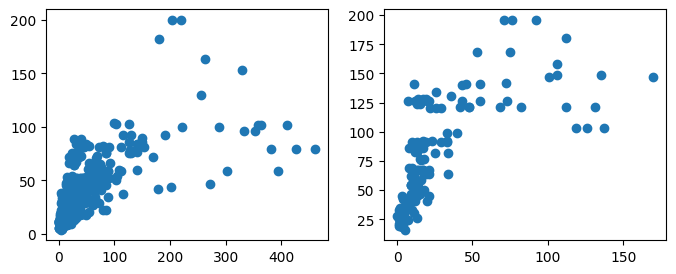

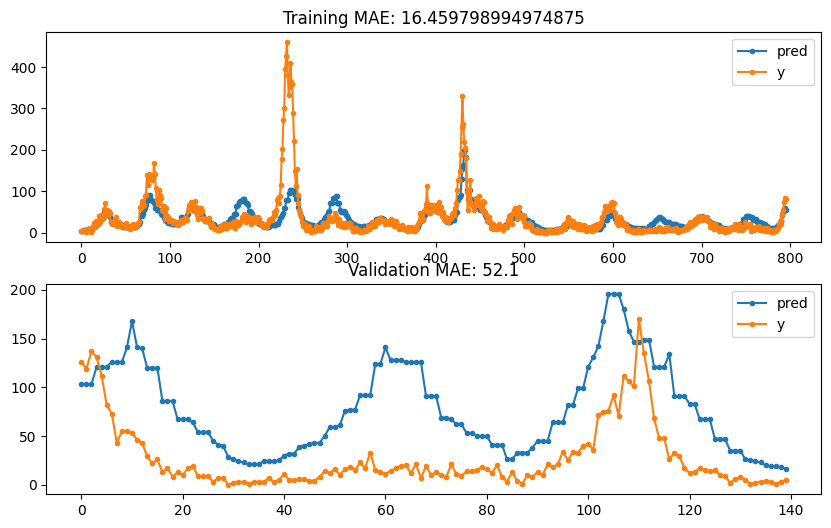

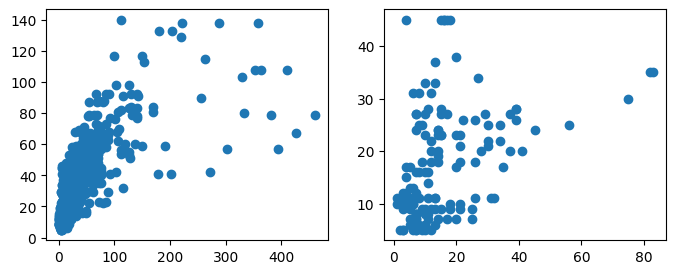

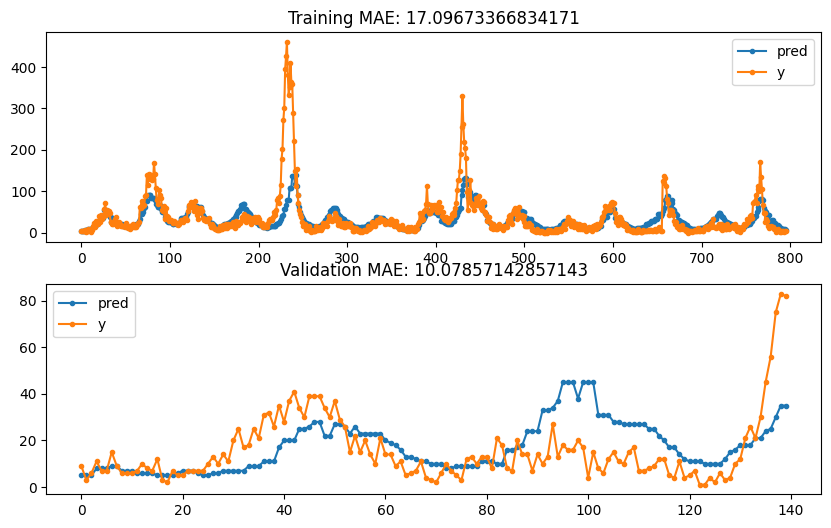

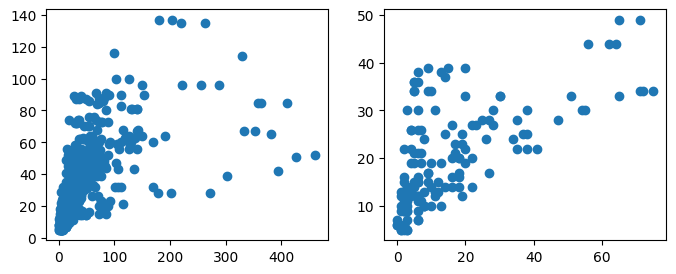

...

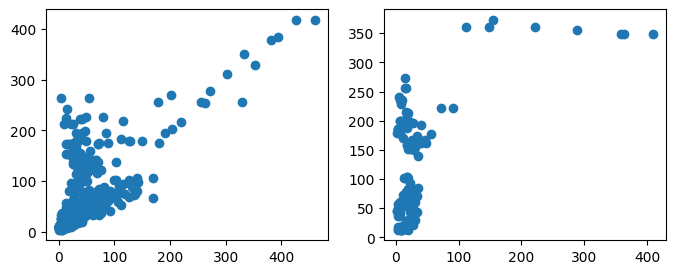

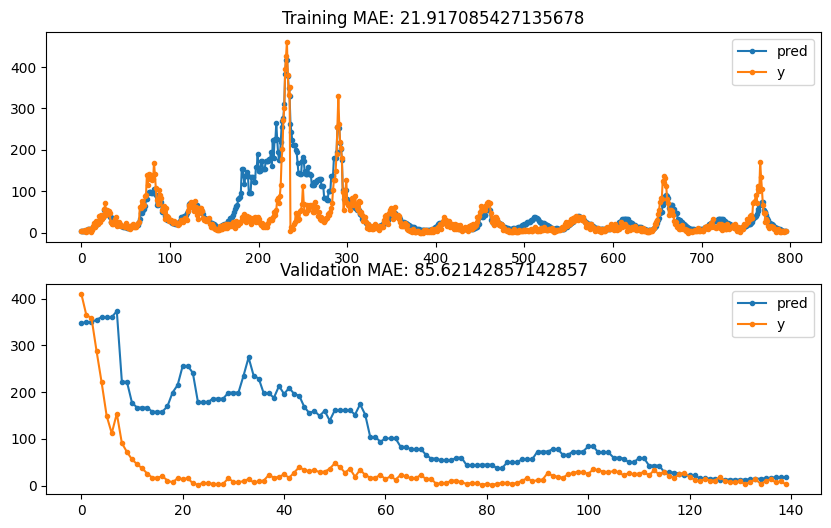

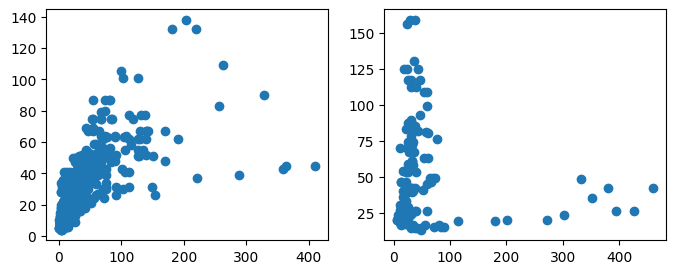

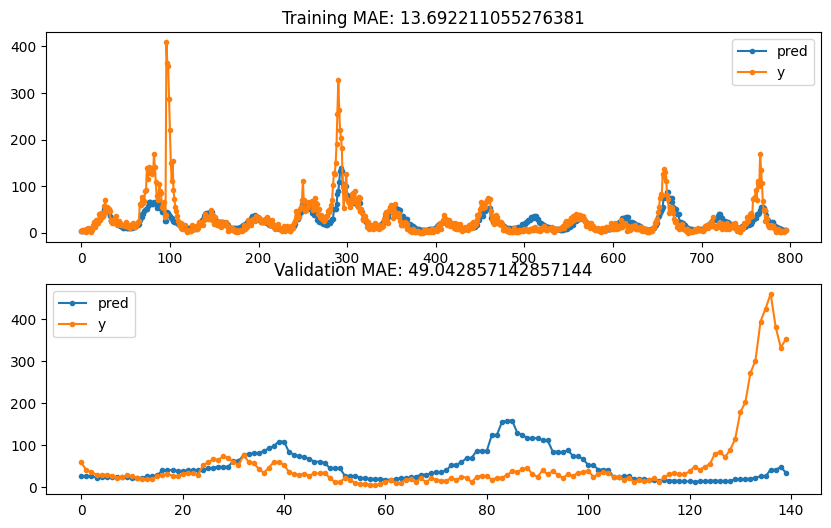

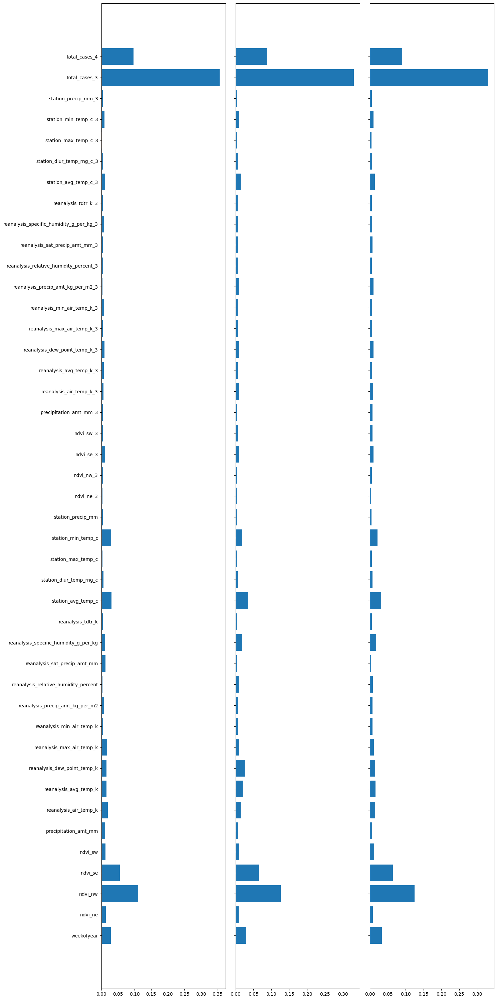

In [14]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))
    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Plot feature importances for three folds
fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
importances = xg_reg_sj[0].feature_importances_
feat_imp = X_train_sj[0].columns
ax2[0].barh(feat_imp,importances)

importances = xg_reg_sj[1].feature_importances_
feat_imp = X_train_sj[1].columns
ax2[1].barh(feat_imp,importances)

importances = xg_reg_sj[2].feature_importances_
feat_imp = X_train_sj[2].columns
ax2[2].barh(feat_imp,importances)

fig2.tight_layout()

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


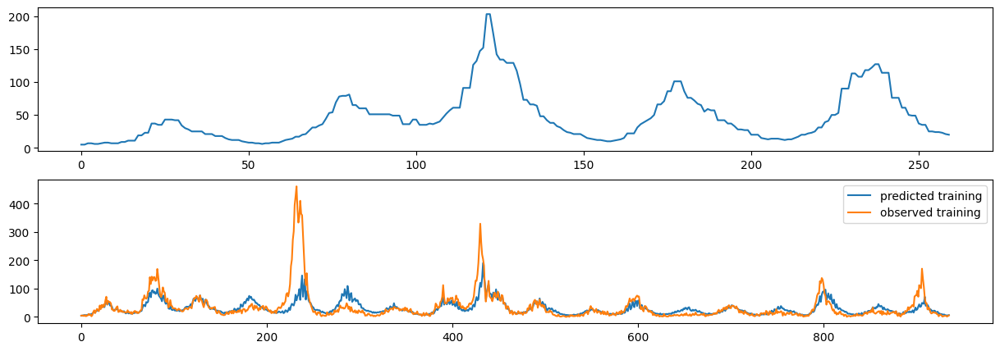

In [9]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = feature_names

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj','weekofyear_3'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100
else:
    lagged_label_names = []

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None)
sj_pred_features_aug.drop(columns='weekofyear_3',inplace=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### San Juan - Circular weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

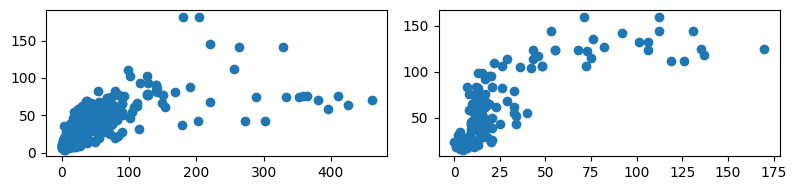

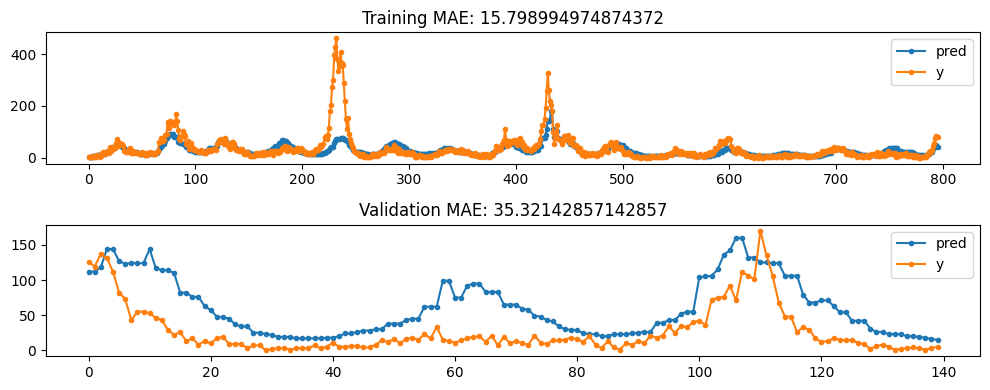

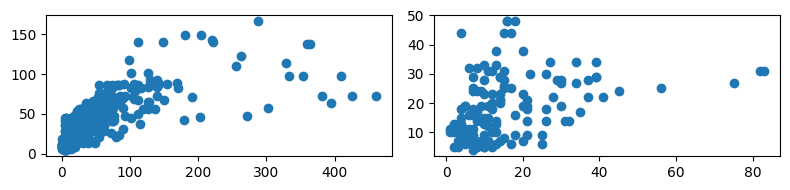

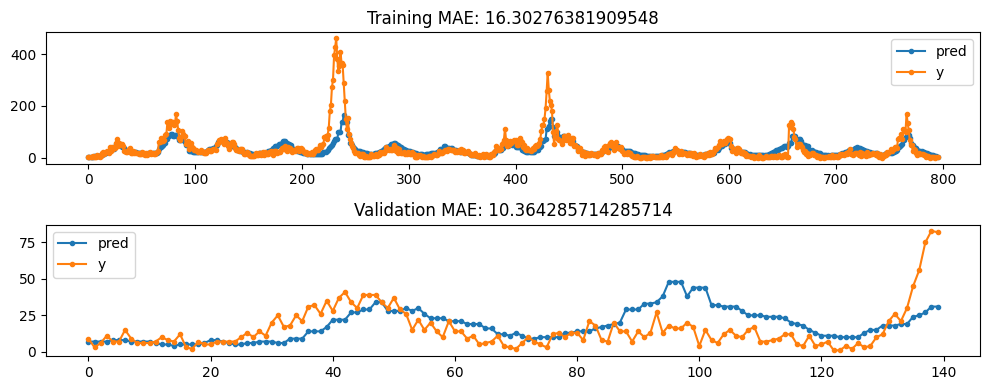

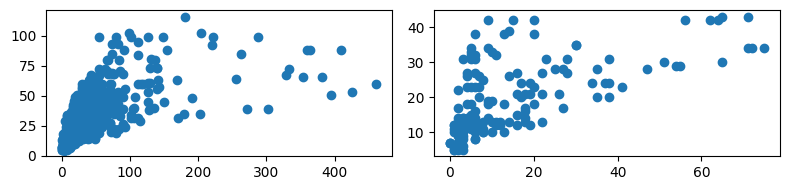

...

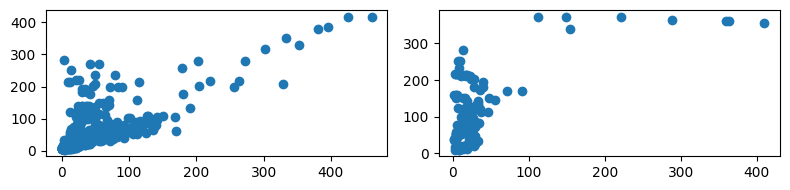

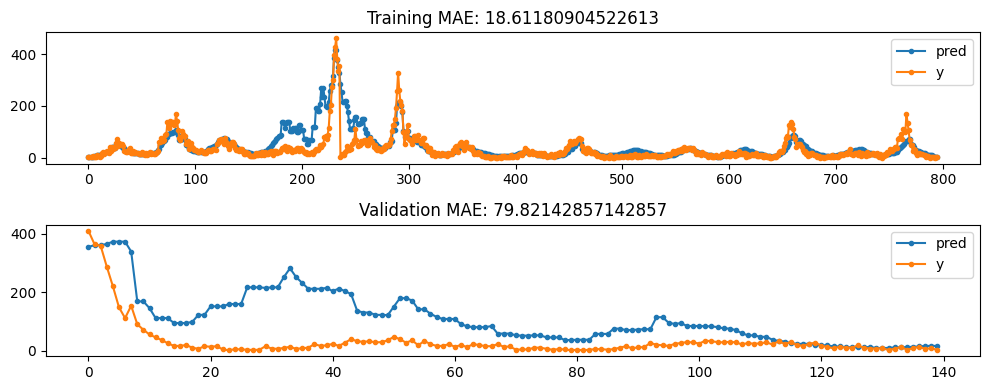

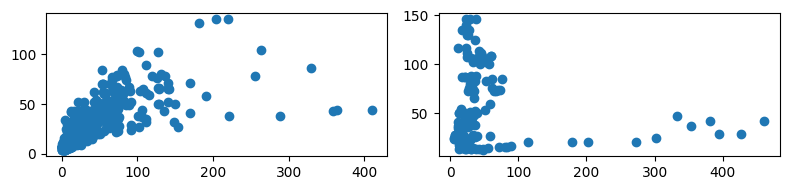

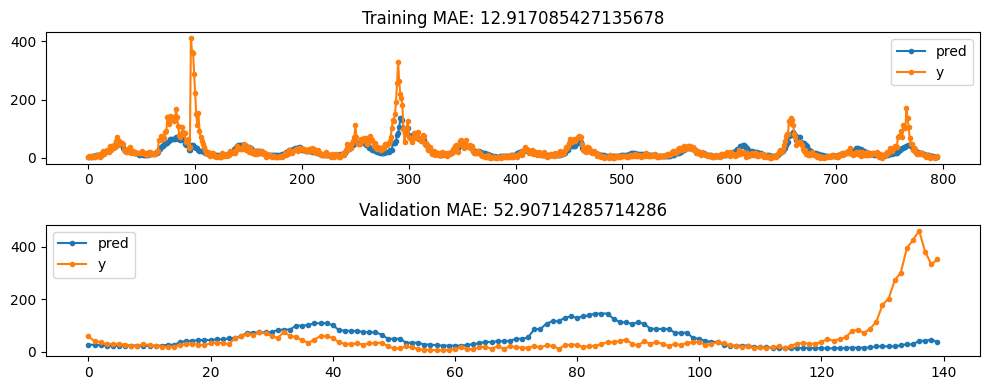

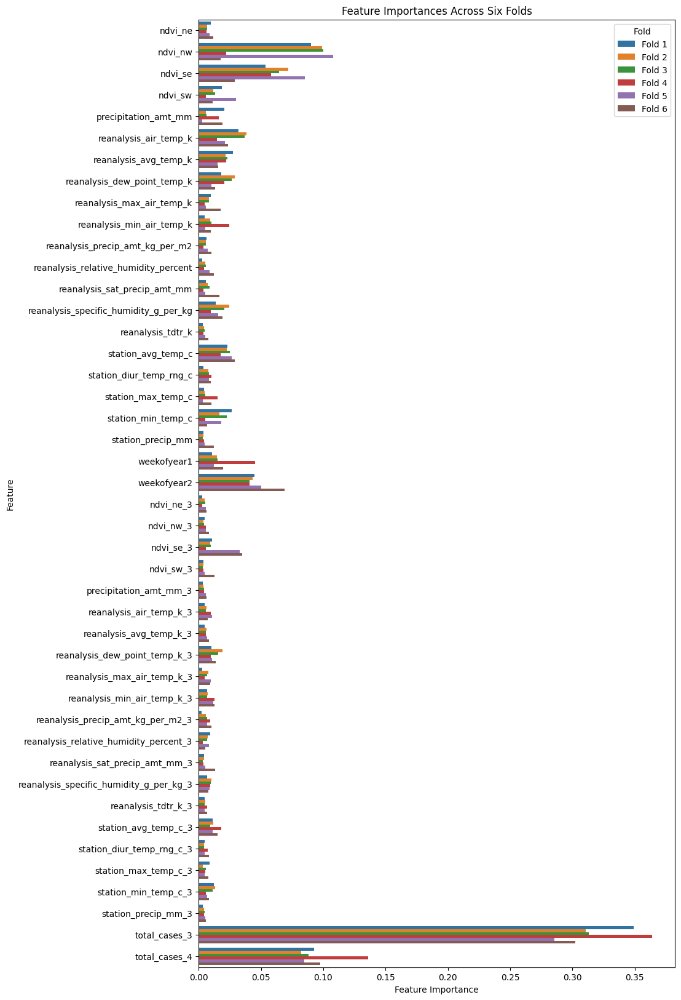

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


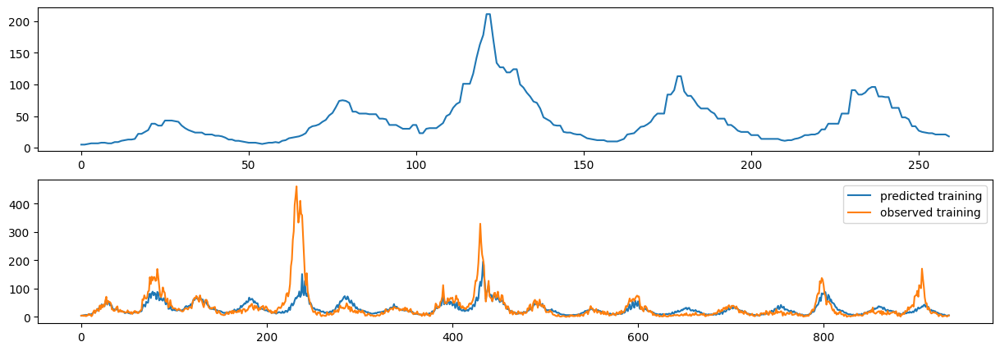

In [21]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
# label_lags=None
# feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d599

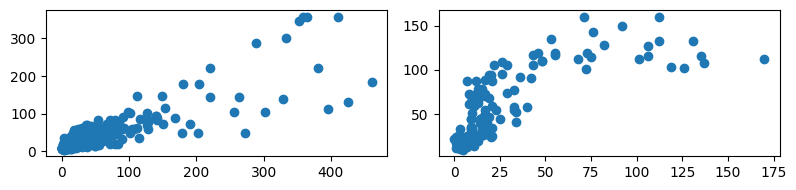

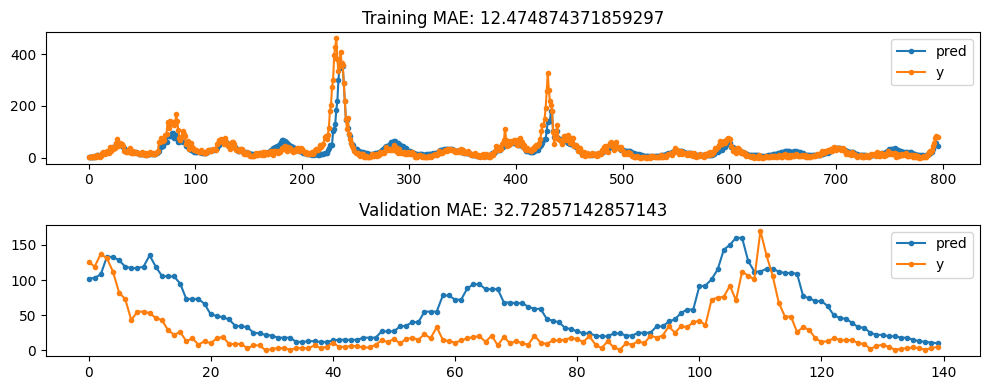

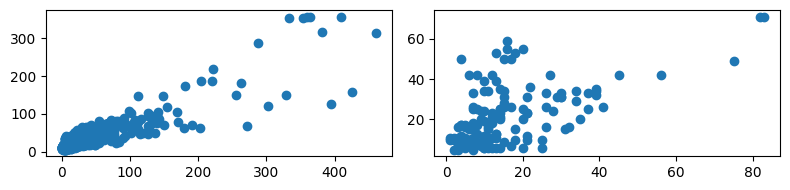

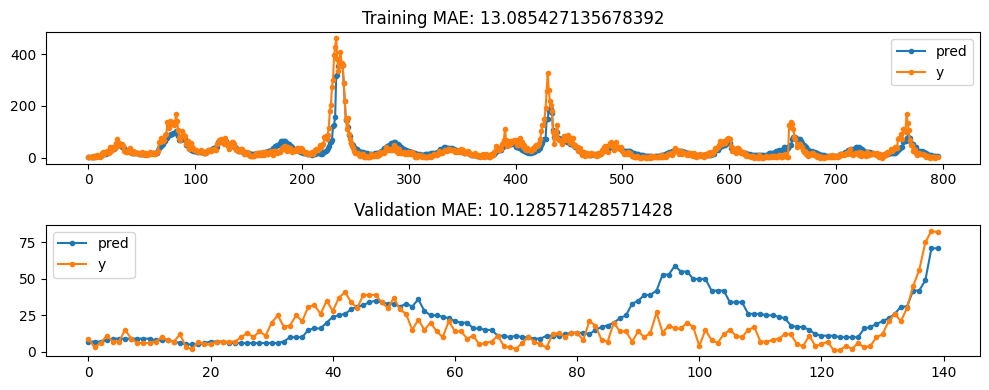

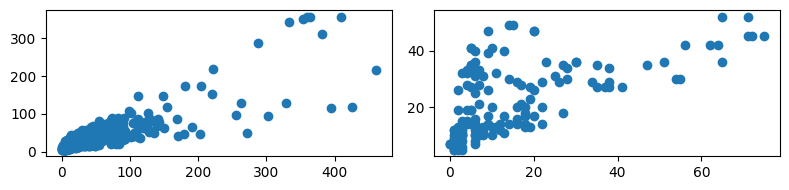

...

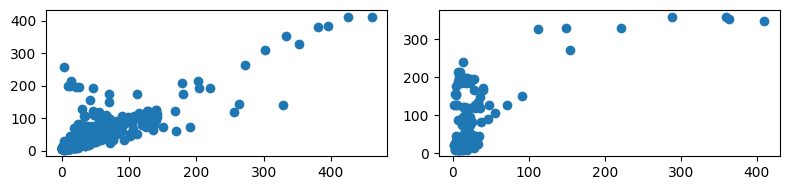

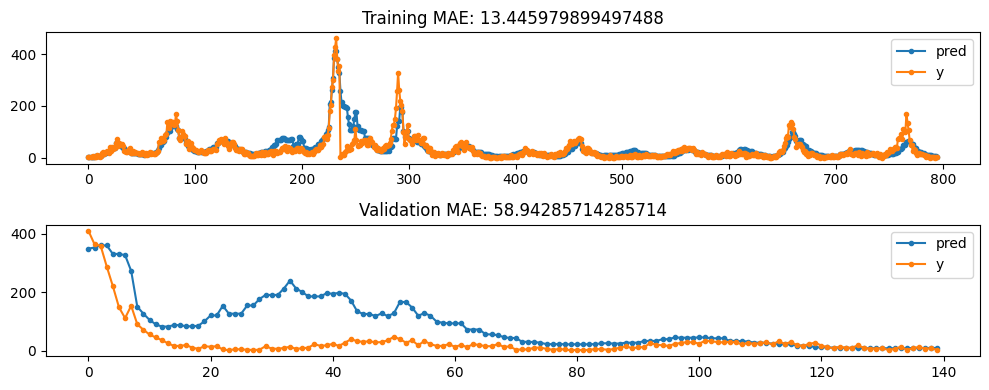

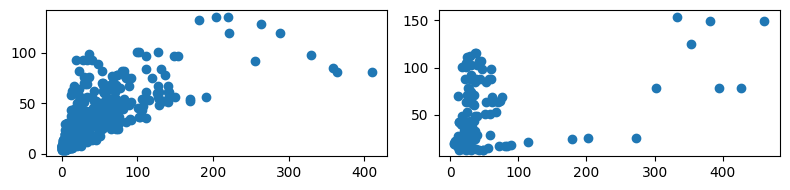

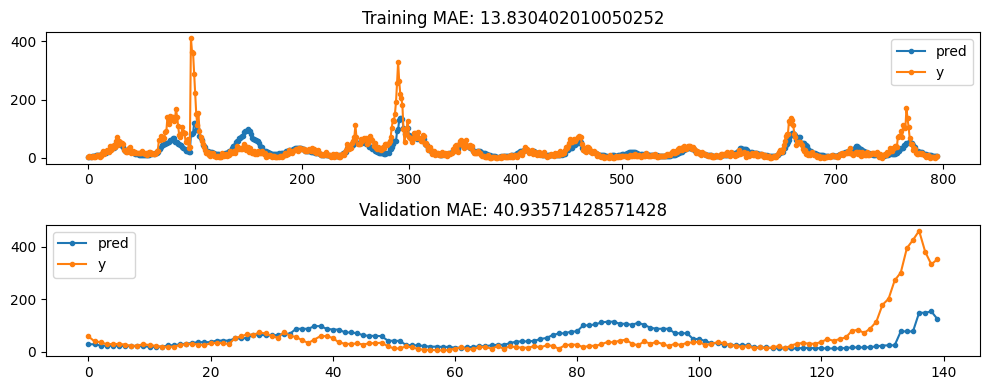

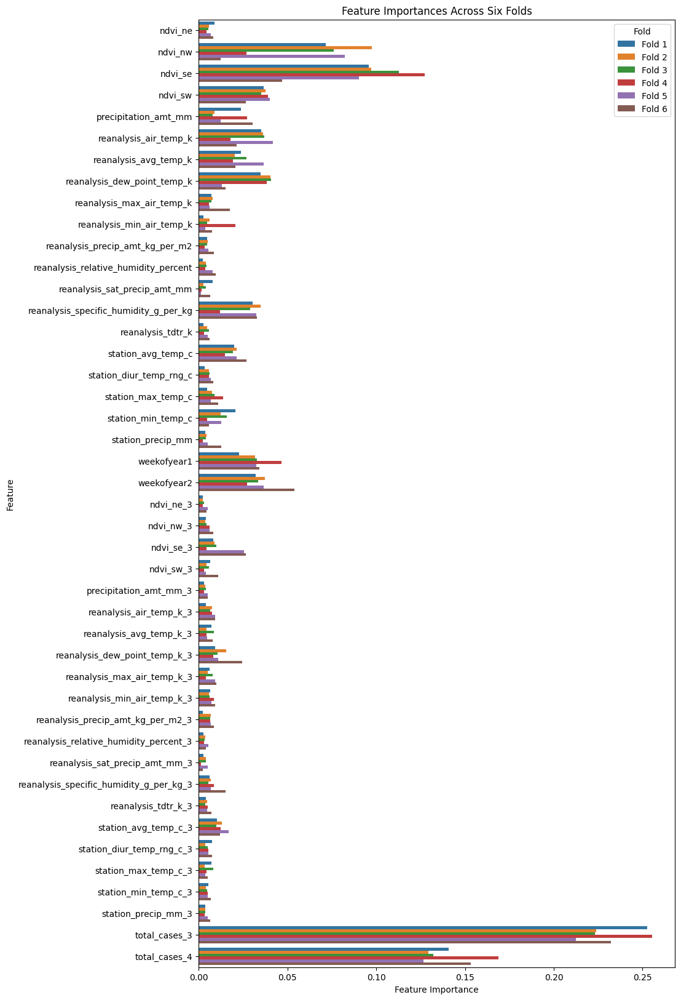

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


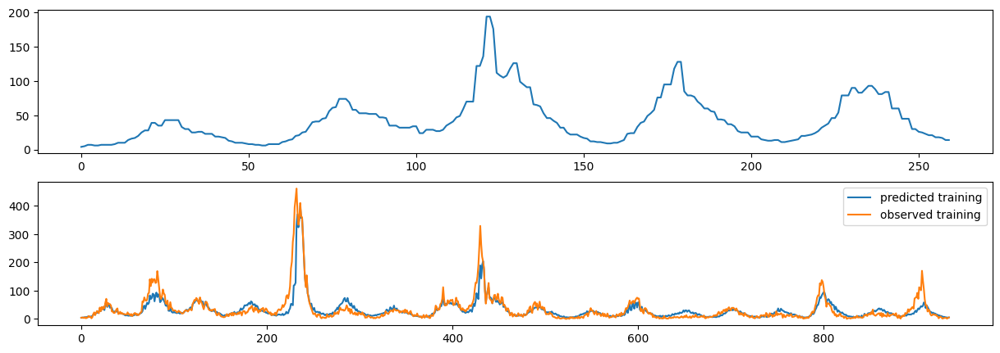

In [6]:
# Baseline for comparison in refined model
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
# label_lags=None
# feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 50

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

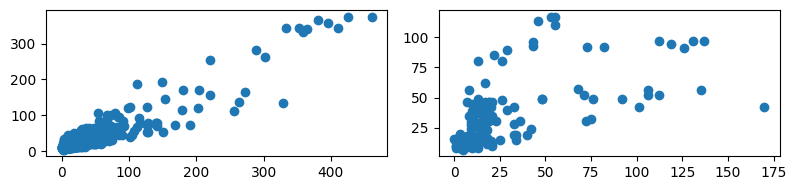

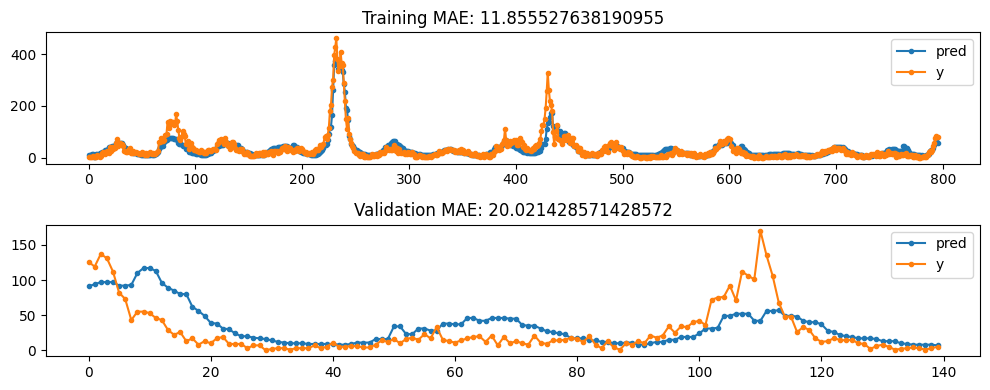

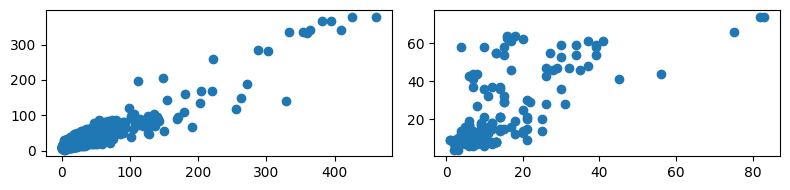

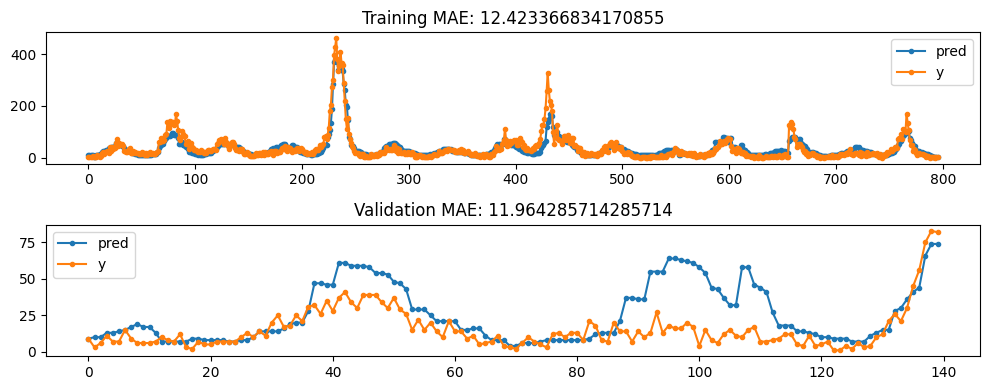

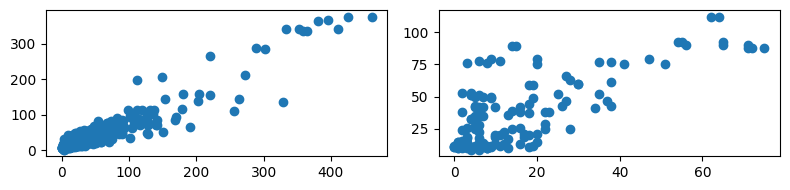

...

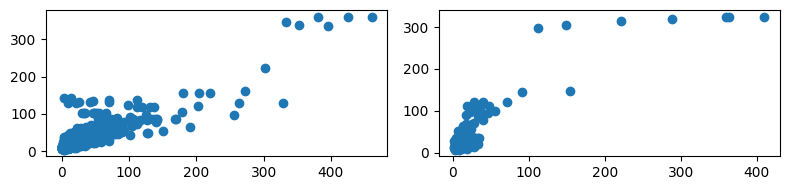

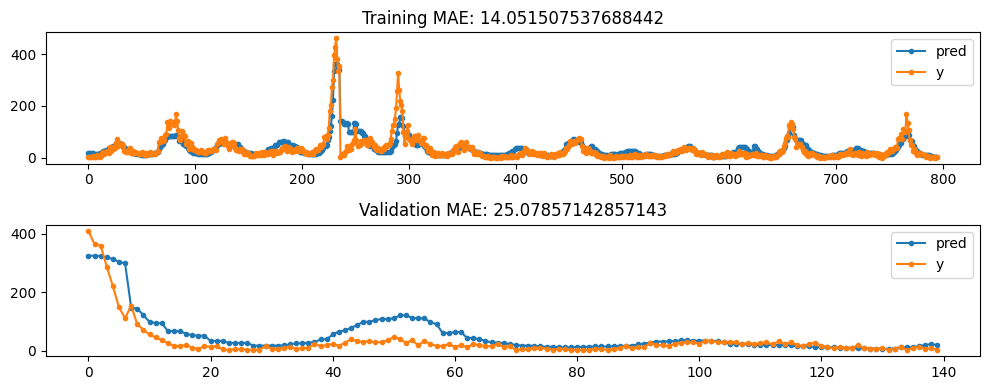

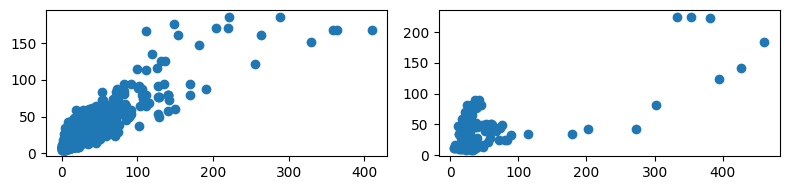

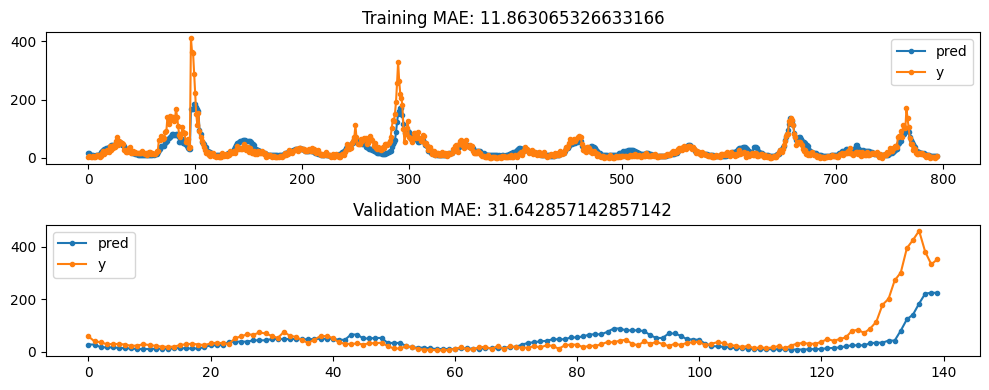

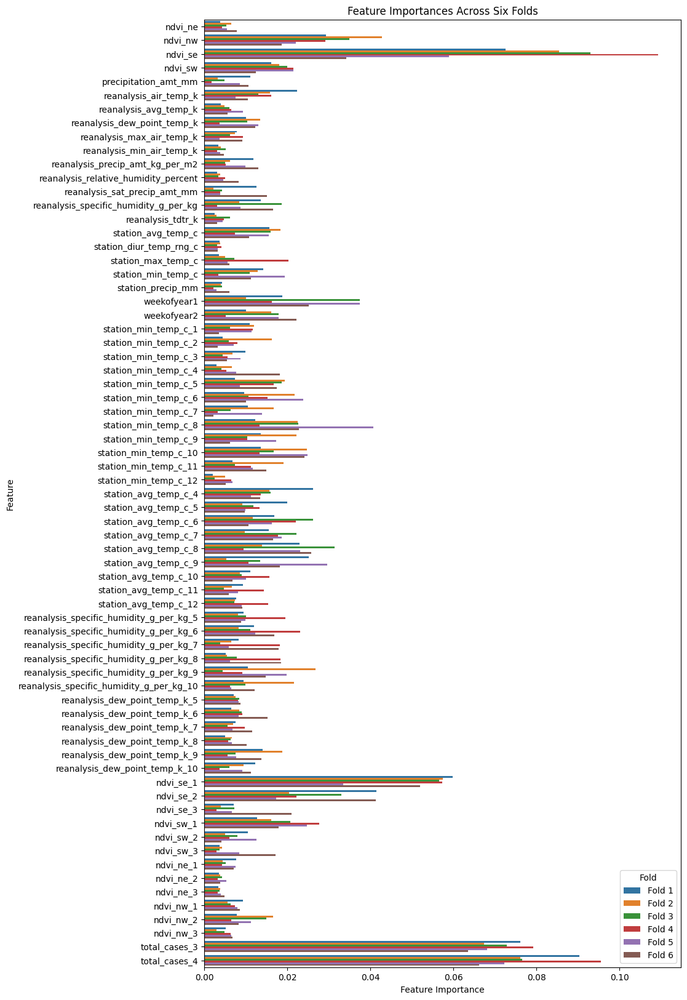

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


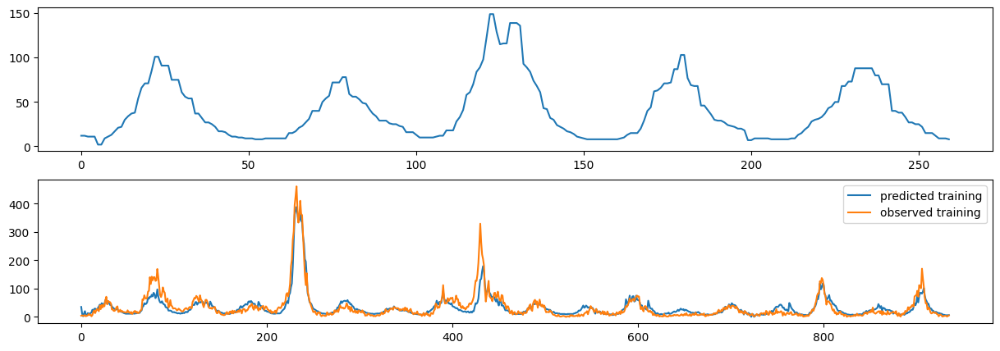

In [29]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### Iquitos - weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

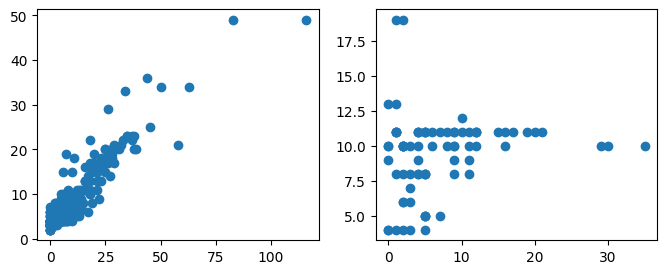

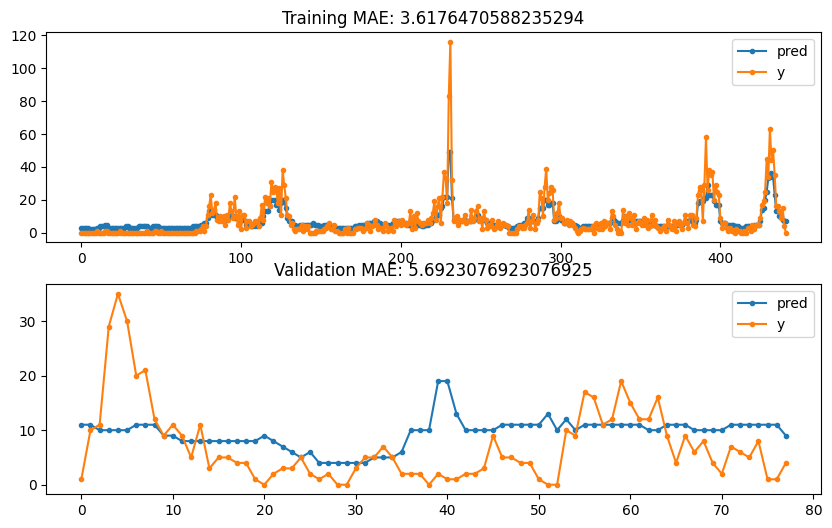

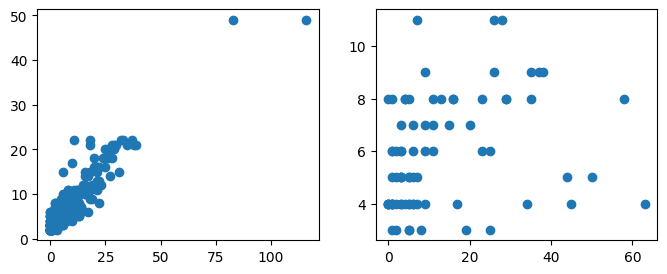

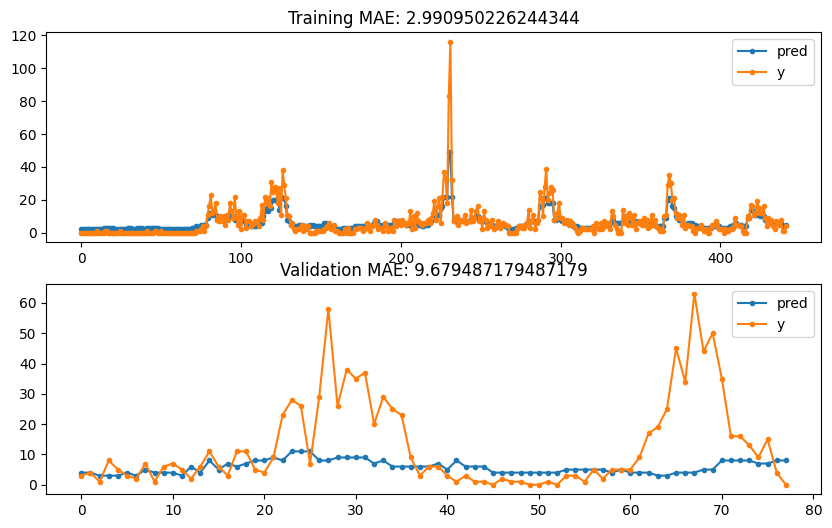

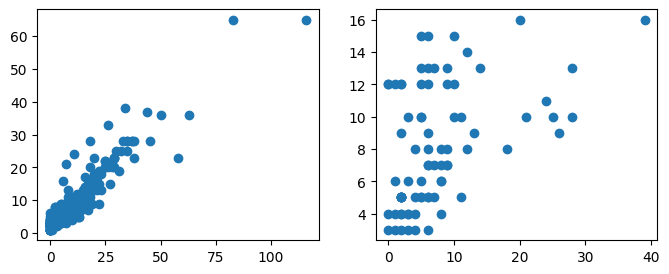

...

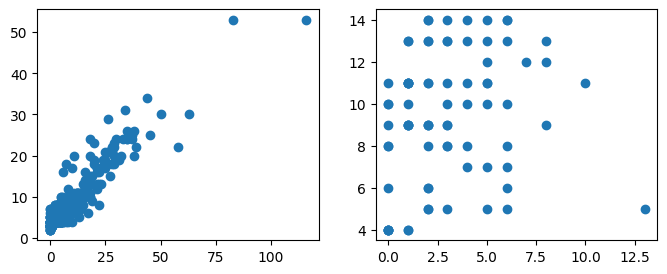

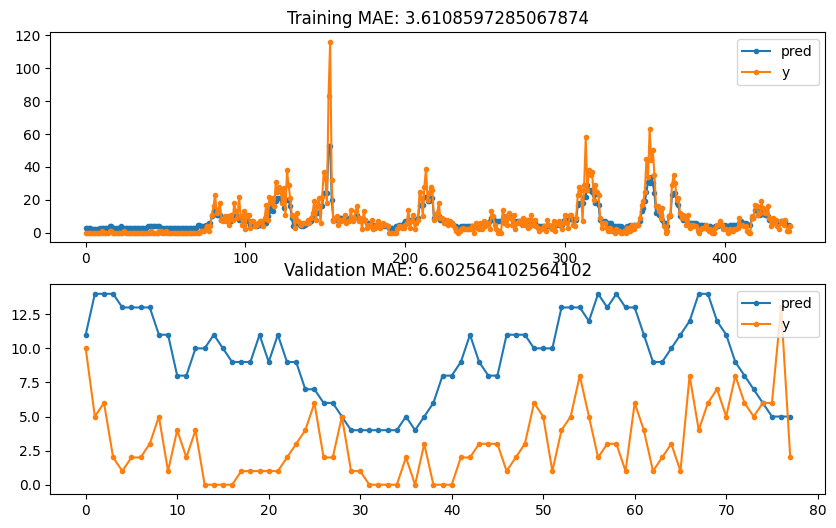

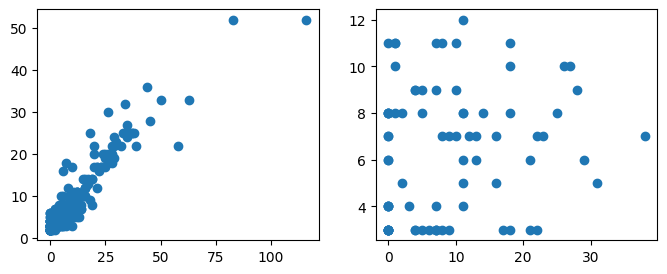

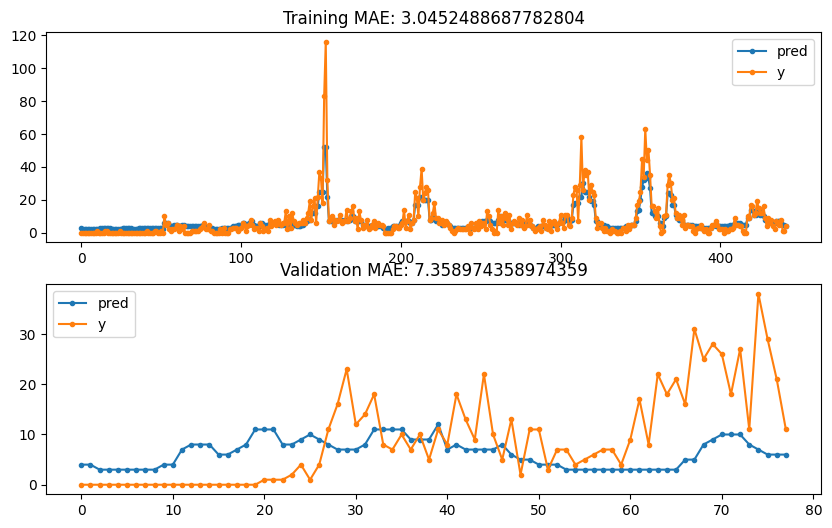

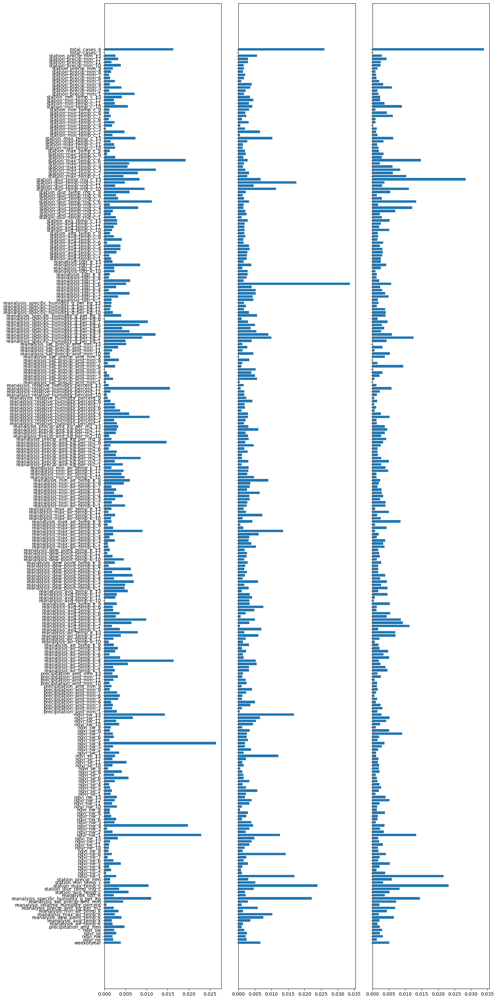

In [22]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
feature_weights[-len(label_lags):] = 0.1

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=6,
                                     objective='reg:squarederror',
                                     reg_alpha=10,reg_lambda=1))
    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold],y_train_iq[fold],
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=True)
    
# Plot feature importances for three folds
fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
importances = xg_reg_iq[0].feature_importances_
feat_imp = X_train_iq[0].columns
ax2[0].barh(feat_imp,importances)

importances = xg_reg_iq[1].feature_importances_
feat_imp = X_train_iq[1].columns
ax2[1].barh(feat_imp,importances)

importances = xg_reg_iq[2].feature_importances_
feat_imp = X_train_iq[2].columns
ax2[2].barh(feat_imp,importances)

fig2.tight_layout()

#### Iquitos - Circular weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

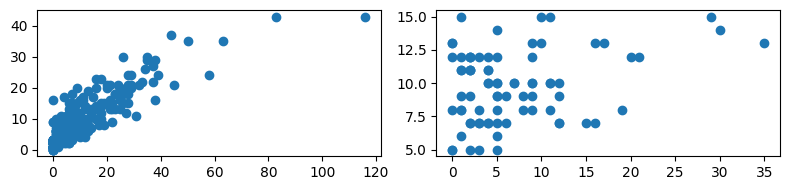

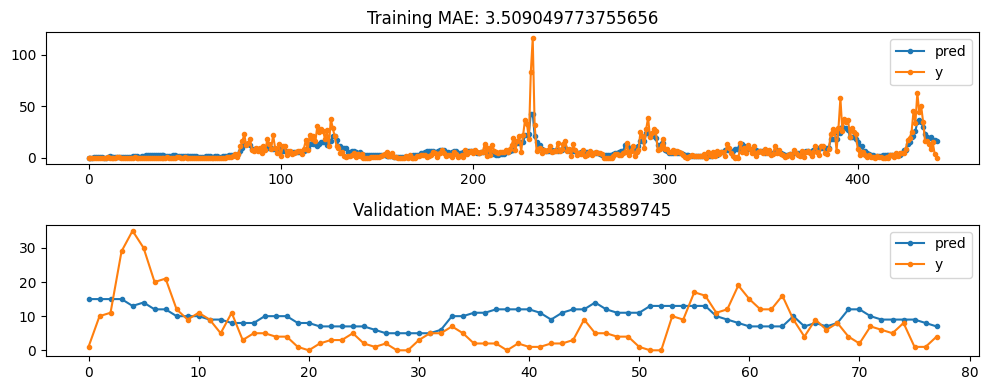

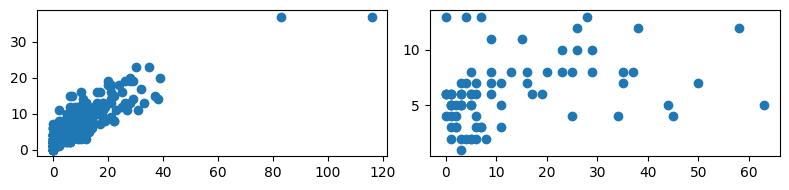

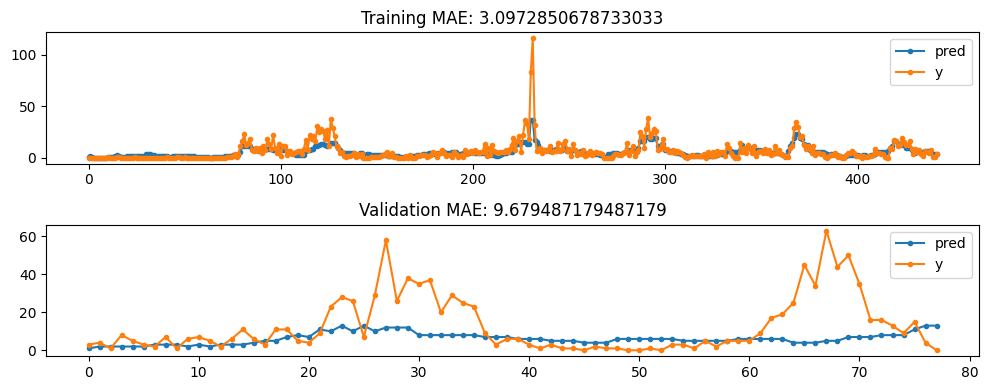

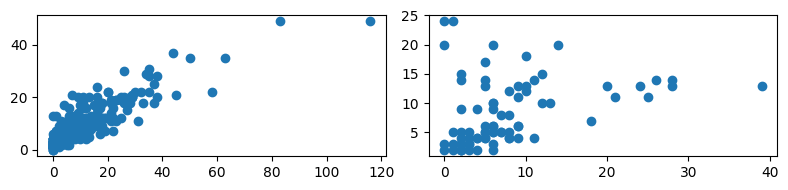

...

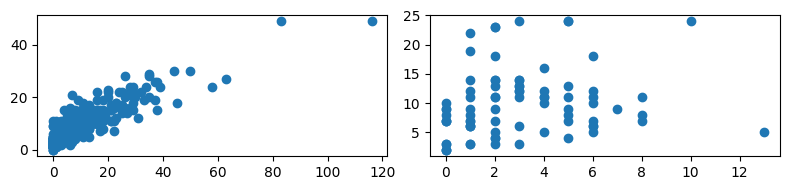

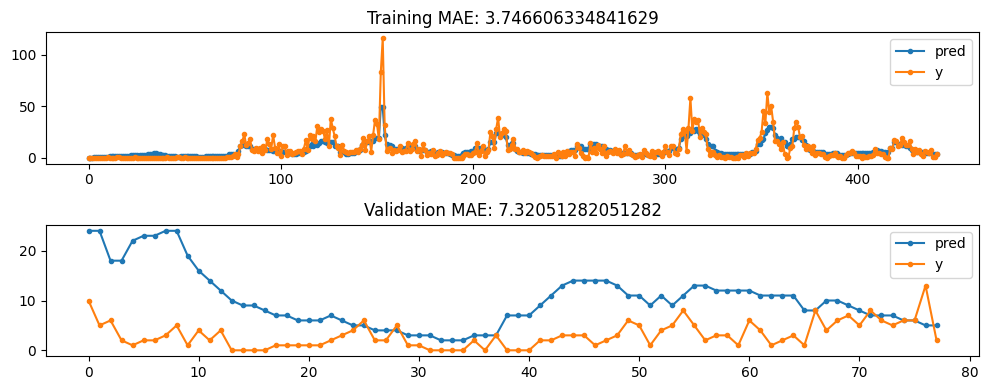

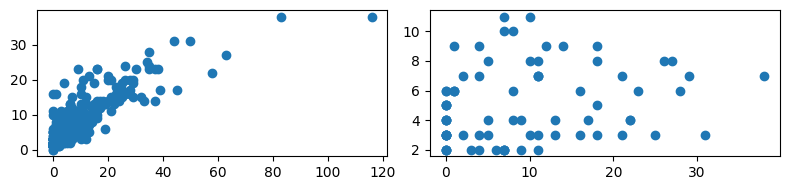

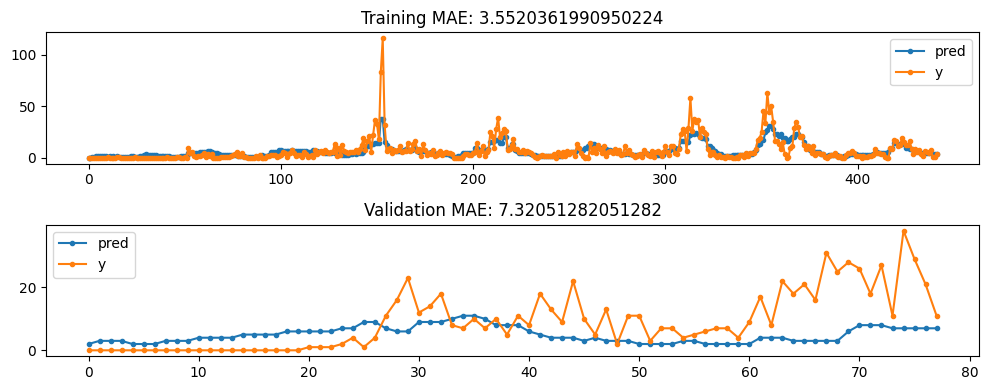

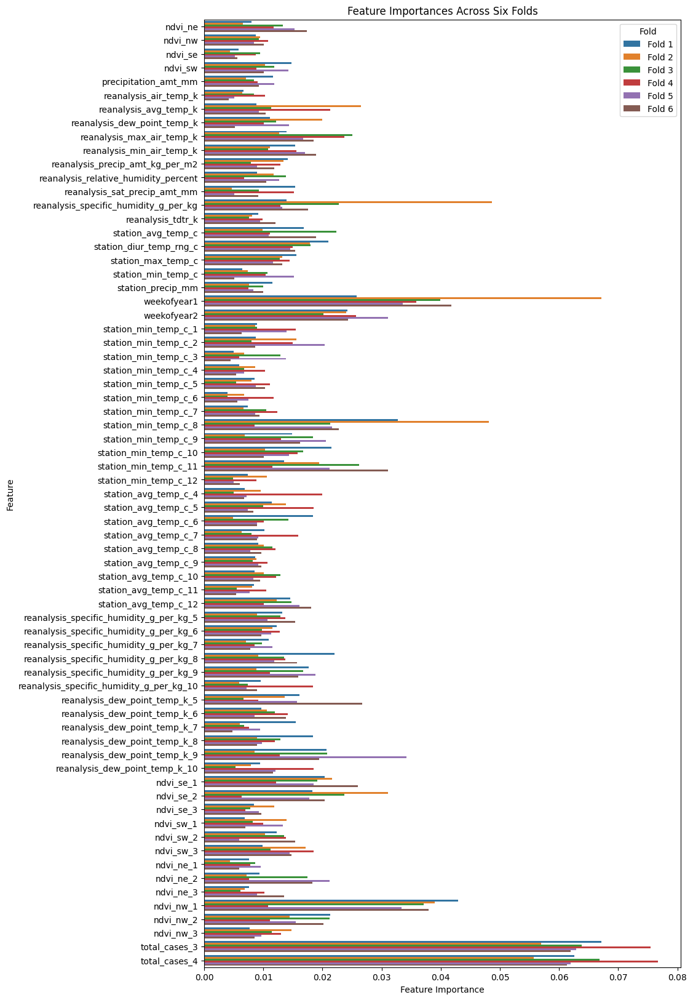

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


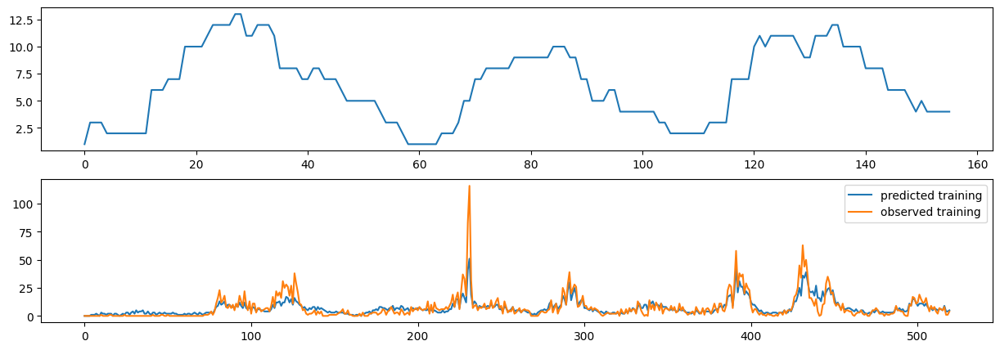

In [26]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

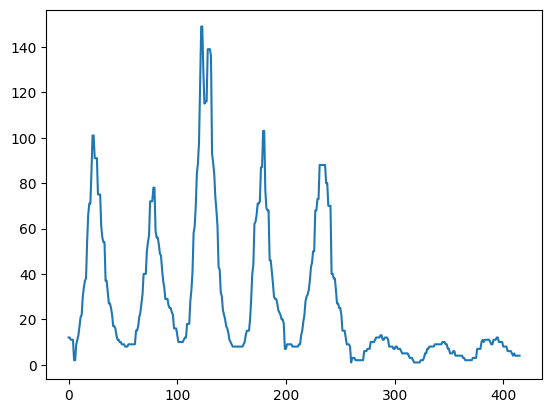

In [30]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_26.csv")

### Reference: SquaredError Combined Cities

#### Weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

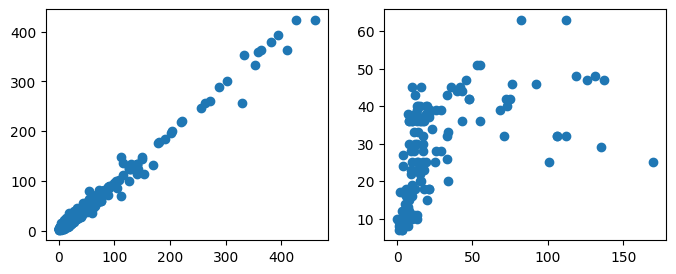

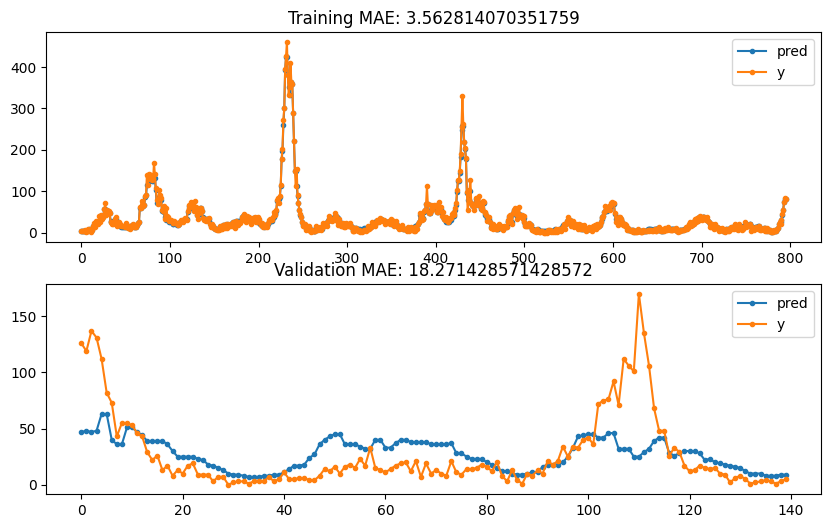

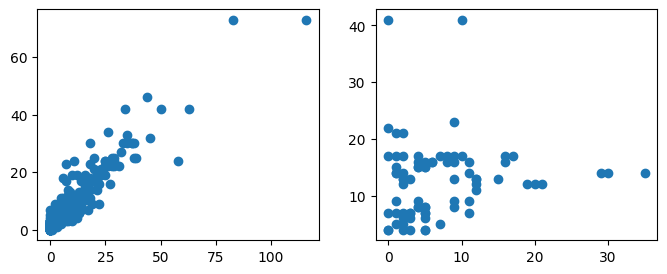

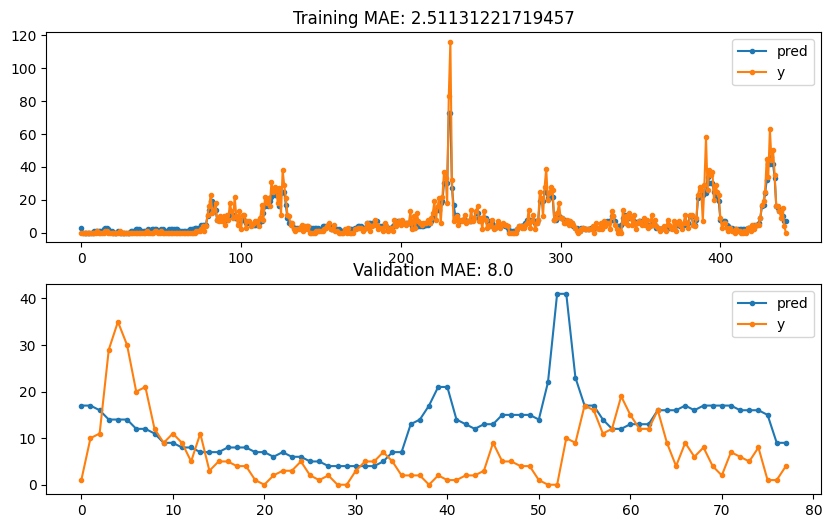

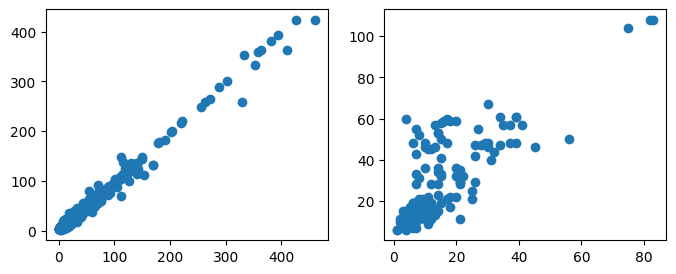

...

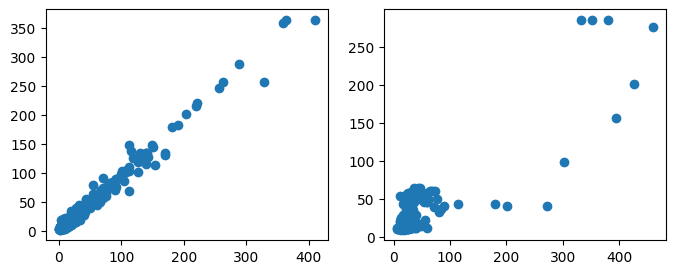

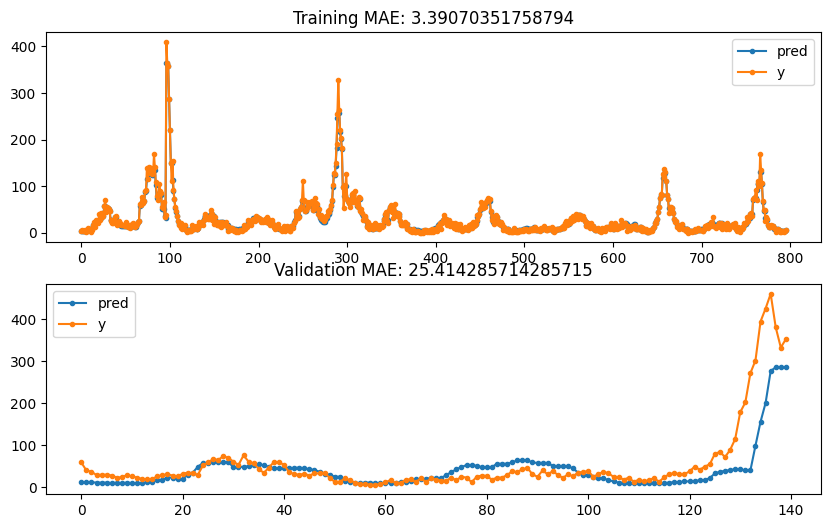

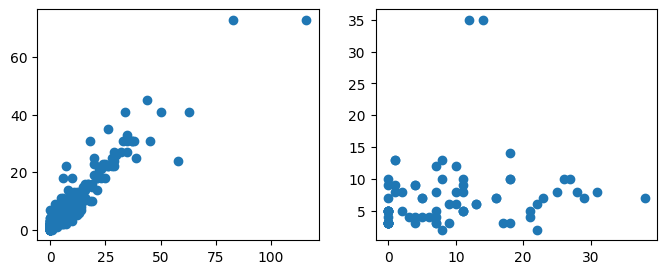

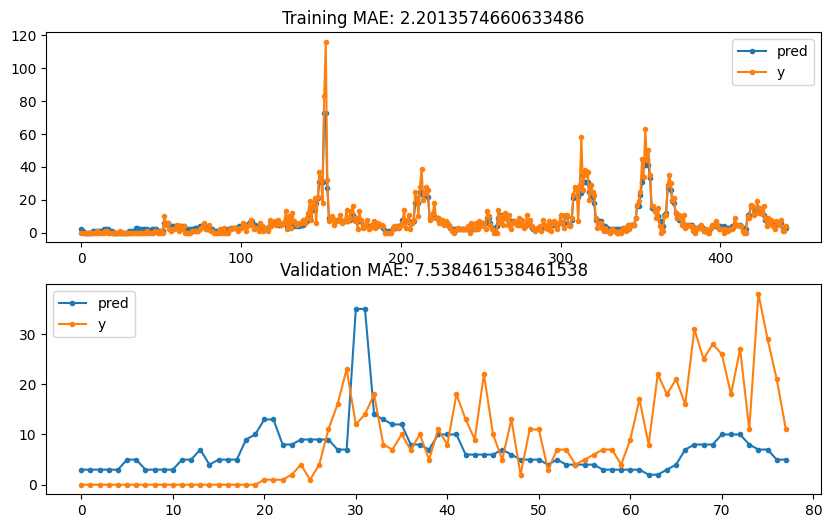

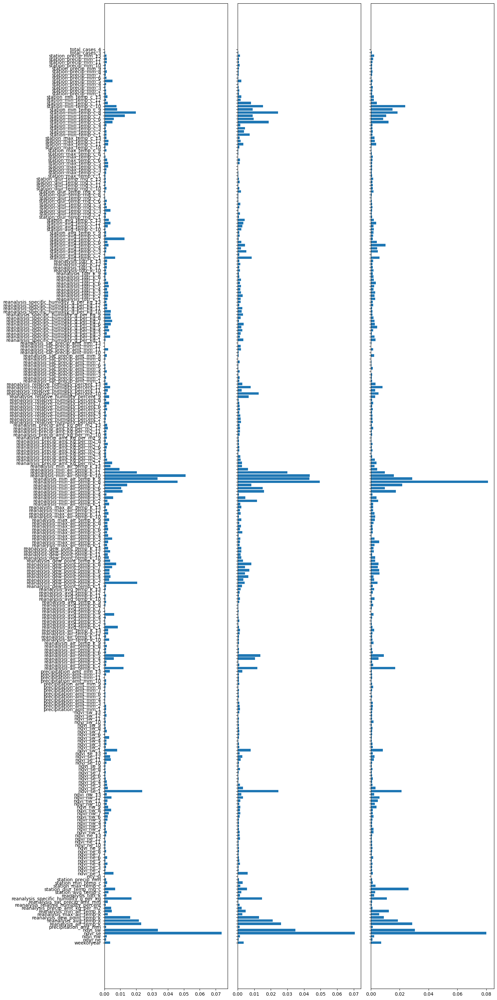

In [18]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
xg_reg = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Combine datasets into tuples if training together
X_train = list(zip(X_train_sj,X_train_iq))
X_val = list(zip(X_val_sj,X_val_iq))
y_train = list(zip(y_train_sj,y_train_iq))
y_val = list(zip(y_val_sj,y_val_iq))

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.1

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=6,
                                     objective='reg:squarederror',
                                     reg_alpha=10,reg_lambda=1))
    modelfit(xg_reg[fold],
             pd.concat(X_train[fold],axis=0),
             pd.concat(y_train[fold],axis=0),
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    
    pred_train, pred_val,train_mae, val_mae = eval_and_plot(xg_reg[fold],
                                                            X_train[fold],
                                                            y_train[fold],
                                                            X_val[fold],
                                                            y_val[fold],
                                                            label_lags=label_lags,
                                                            verbose=False,plot=True, MC=None,
                                                            get_pred_train=True,two_cities=True,
                                                            median_filter=True)
    

# Plot feature importances for three folds
fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
importances = xg_reg[0].feature_importances_
feat_imp = X_train[0][0].columns
ax2[0].barh(feat_imp,importances)

importances = xg_reg[1].feature_importances_
feat_imp = X_train[1][0].columns
ax2[1].barh(feat_imp,importances)

importances = xg_reg[2].feature_importances_
feat_imp = X_train[2][0].columns
ax2[2].barh(feat_imp,importances)

fig2.tight_layout()

#### Circular weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

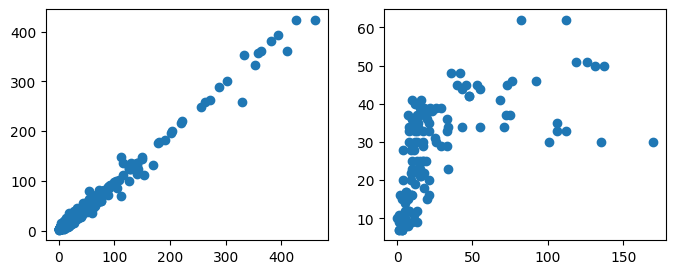

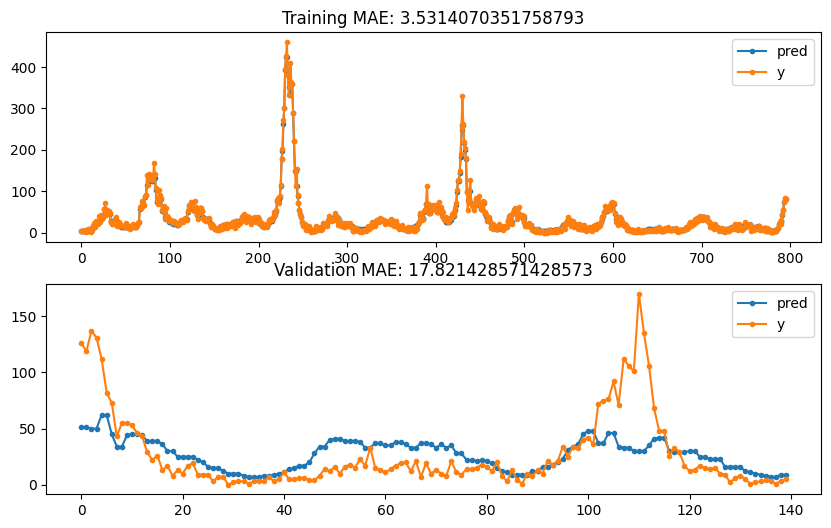

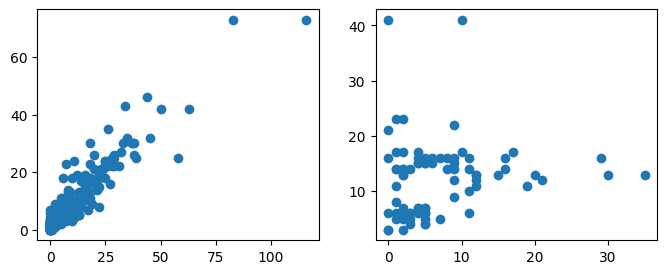

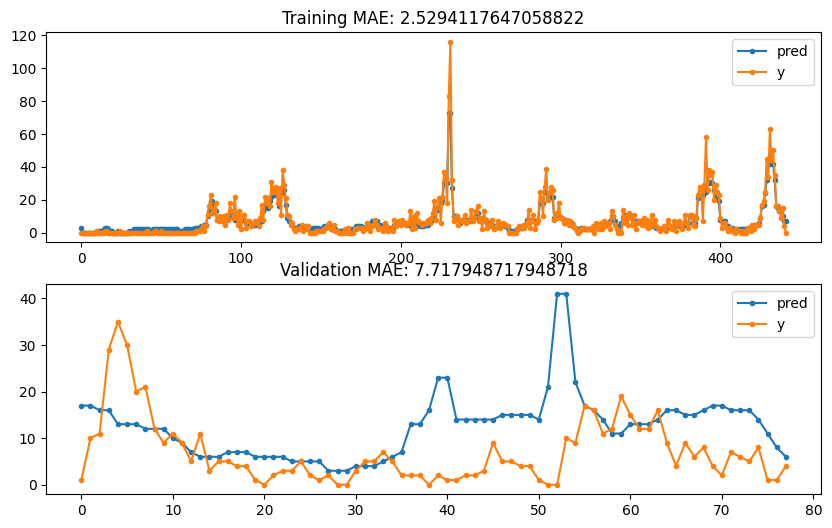

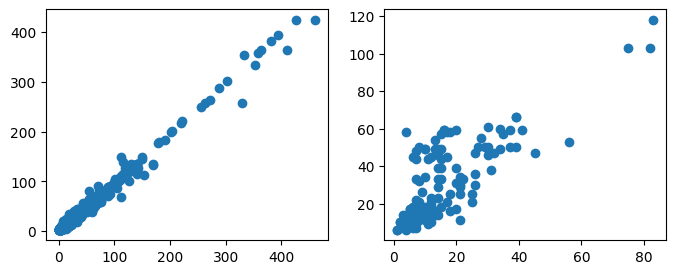

...

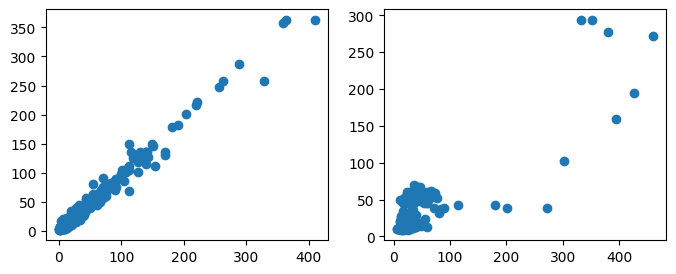

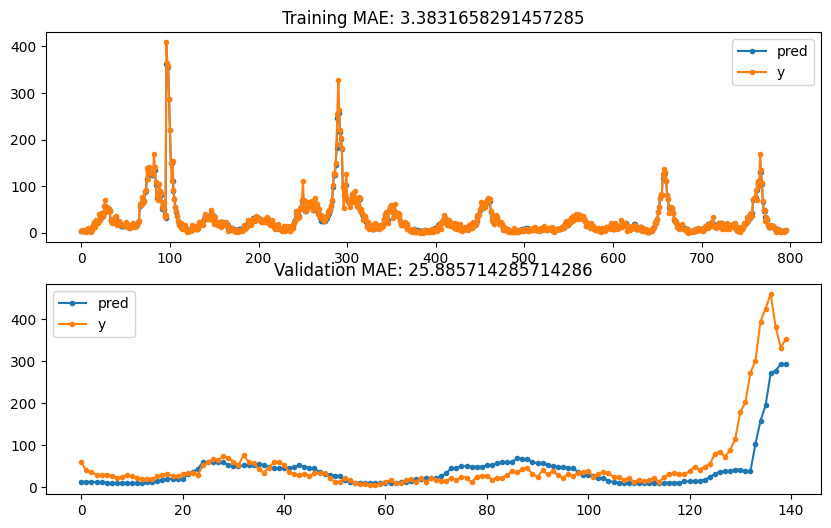

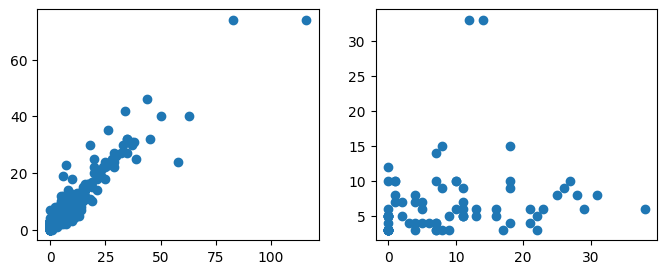

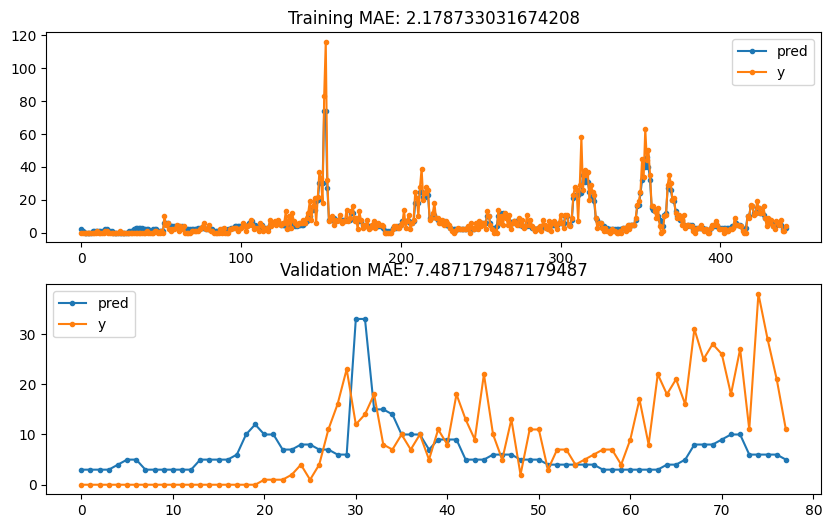

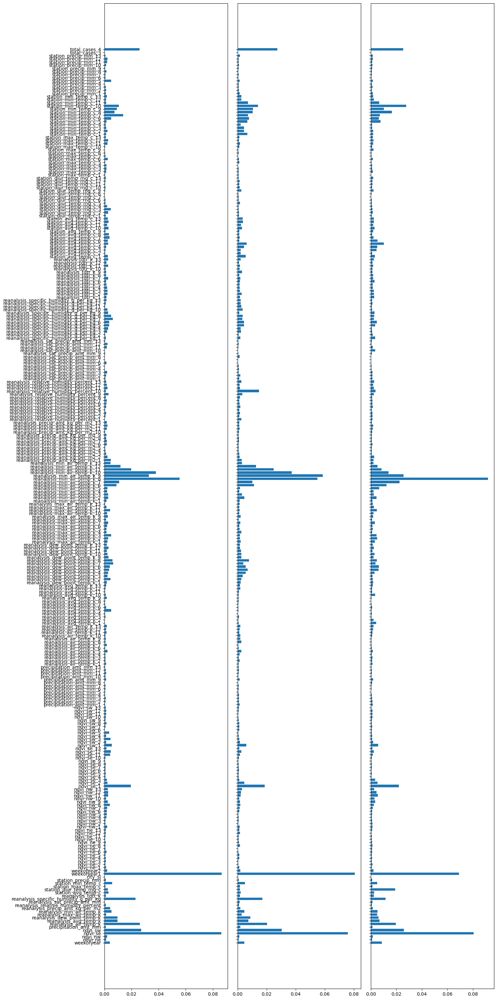

In [19]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
xg_reg = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags, circular_weekofyear=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Combine datasets into tuples if training together
X_train = list(zip(X_train_sj,X_train_iq))
X_val = list(zip(X_val_sj,X_val_iq))
y_train = list(zip(y_train_sj,y_train_iq))
y_val = list(zip(y_val_sj,y_val_iq))

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.1

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=6,
                                     objective='reg:squarederror',
                                     reg_alpha=10,reg_lambda=1))
    modelfit(xg_reg[fold],
             pd.concat(X_train[fold],axis=0),
             pd.concat(y_train[fold],axis=0),
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    
    pred_train, pred_val,train_mae, val_mae = eval_and_plot(xg_reg[fold],
                                                            X_train[fold],
                                                            y_train[fold],
                                                            X_val[fold],
                                                            y_val[fold],
                                                            label_lags=label_lags,
                                                            verbose=False,plot=True, MC=None,
                                                            get_pred_train=True,two_cities=True,
                                                            median_filter=True)
    

# Plot feature importances for three folds
fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
importances = xg_reg[0].feature_importances_
feat_imp = X_train[0][0].columns
ax2[0].barh(feat_imp,importances)

importances = xg_reg[1].feature_importances_
feat_imp = X_train[1][0].columns
ax2[1].barh(feat_imp,importances)

importances = xg_reg[2].feature_importances_
feat_imp = X_train[2][0].columns
ax2[2].barh(feat_imp,importances)

fig2.tight_layout()

### Reference: Poisson Split Cities

#### San Juan - Circular weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

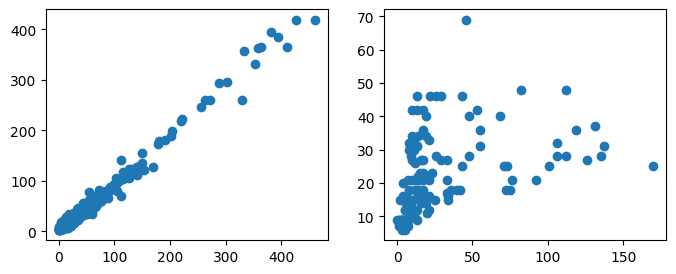

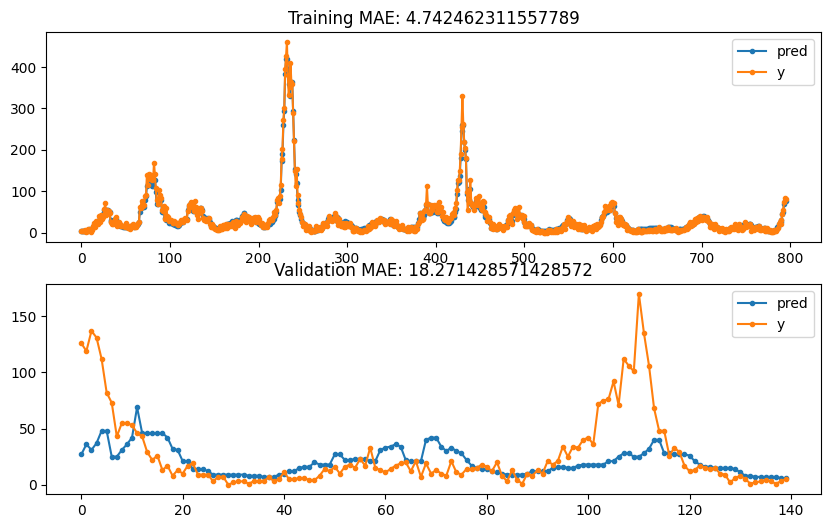

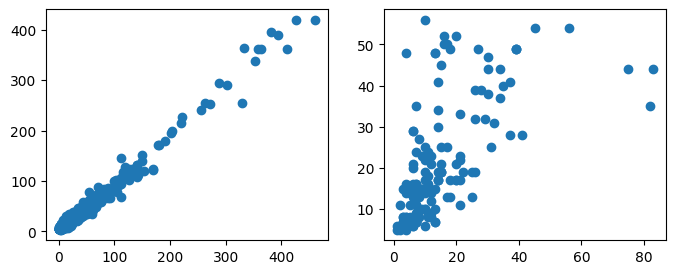

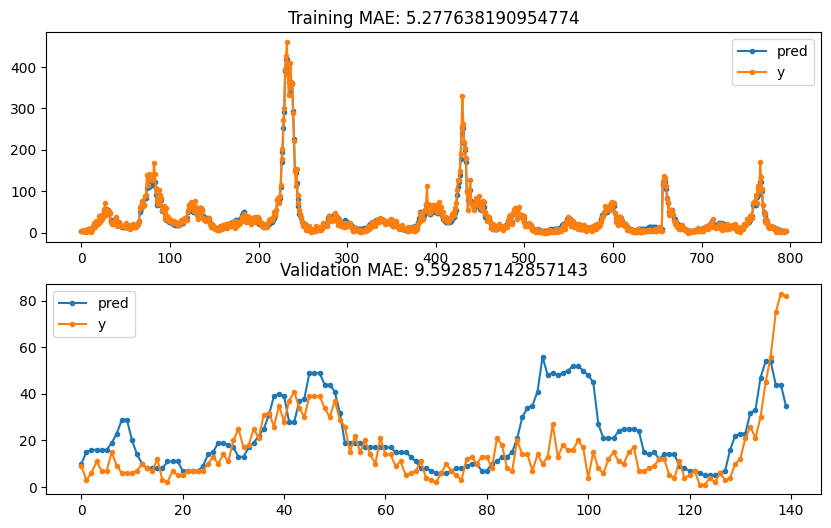

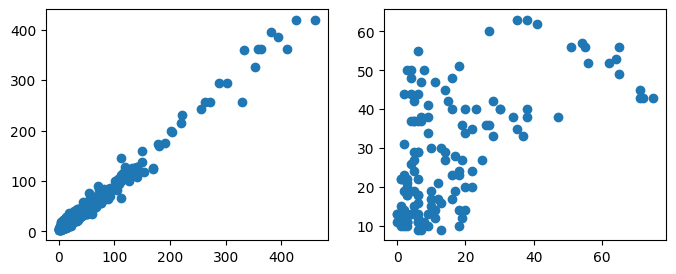

...

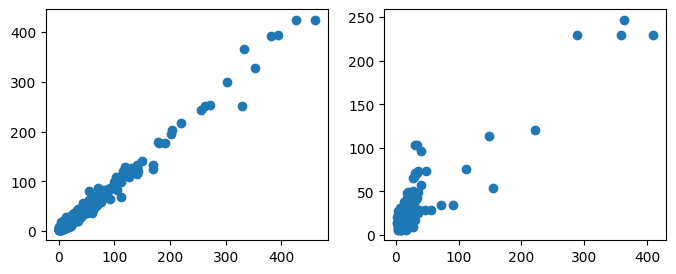

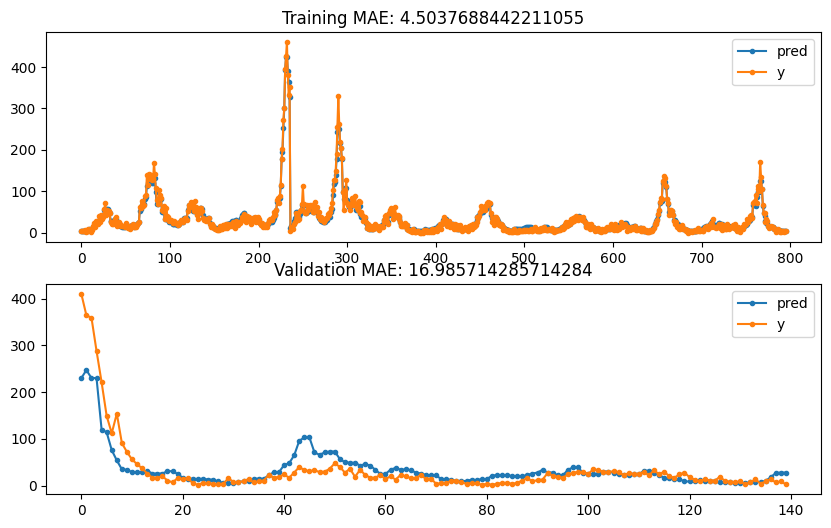

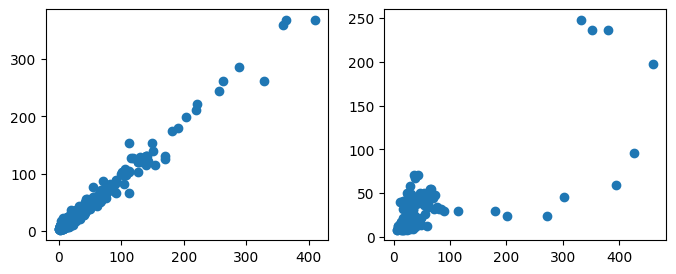

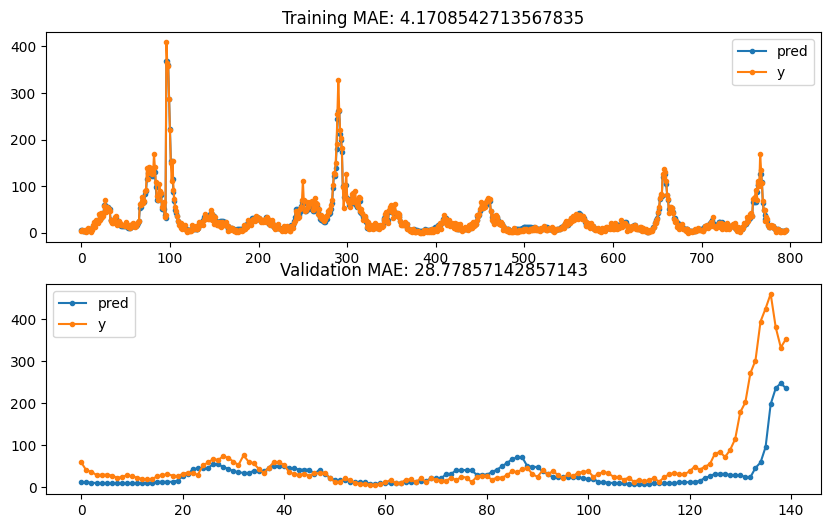

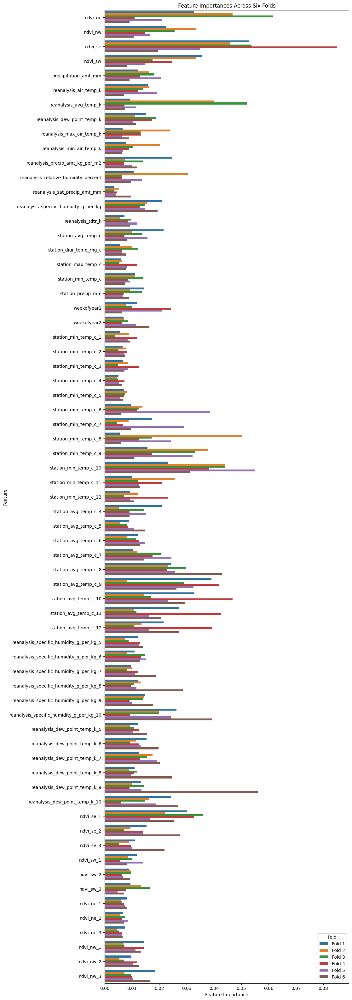

In [21]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 0.1

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='count:poisson',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold],y_train_sj[fold],
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 40))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()


# # Plot feature importances for three folds
# fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
# importances = xg_reg_sj[0].feature_importances_
# feat_imp = X_train_sj[0].columns
# ax2[0].barh(feat_imp,importances)

# importances = xg_reg_sj[1].feature_importances_
# feat_imp = X_train_sj[1].columns
# ax2[1].barh(feat_imp,importances)

# importances = xg_reg_sj[2].feature_importances_
# feat_imp = X_train_sj[2].columns
# ax2[2].barh(feat_imp,importances)

# fig2.tight_layout()

#### Iquitos - Circular weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

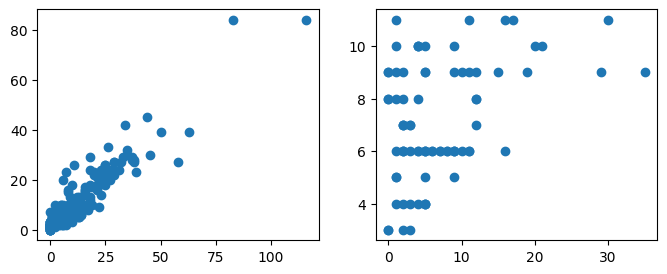

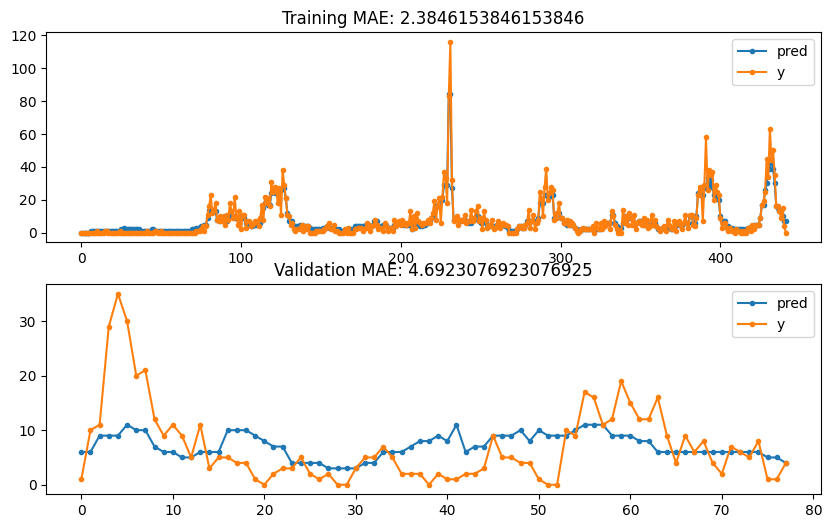

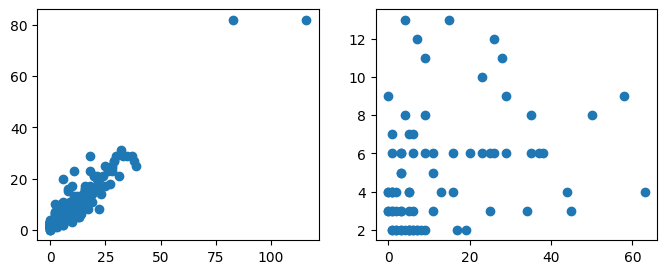

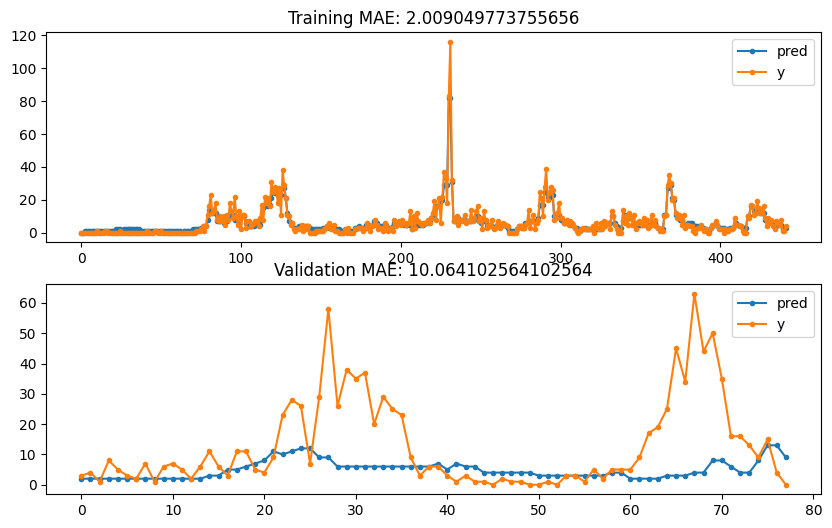

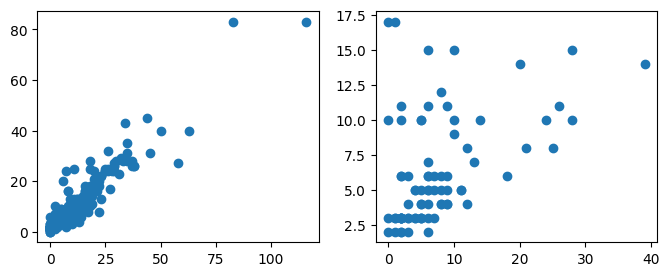

...

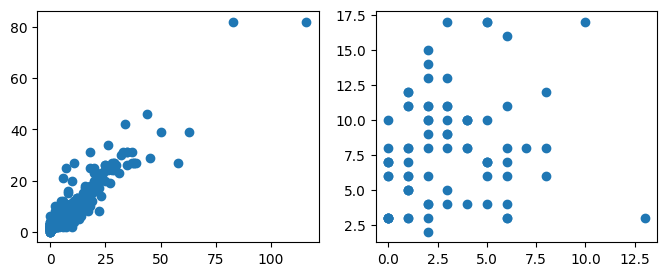

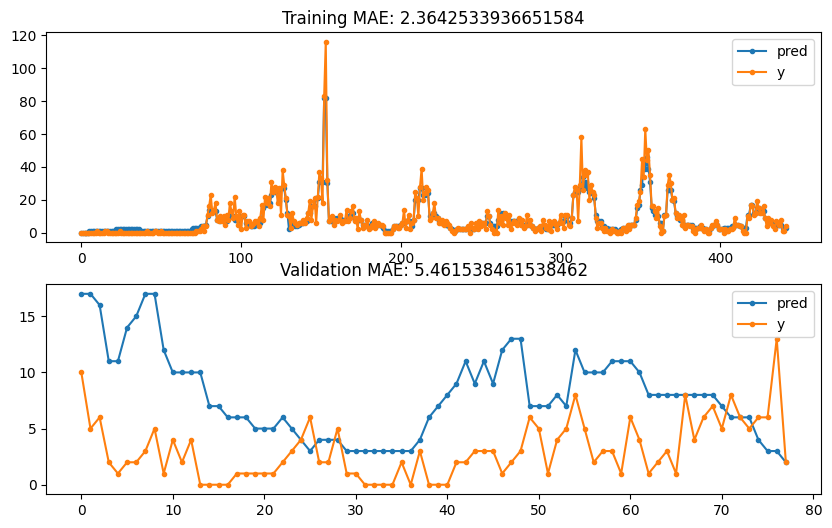

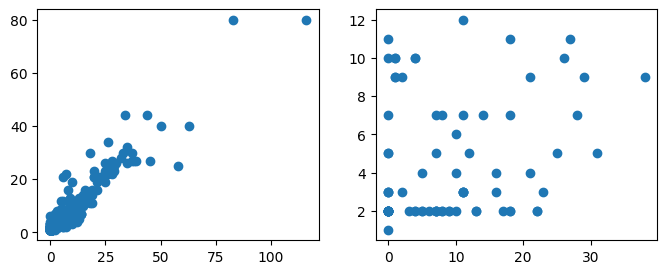

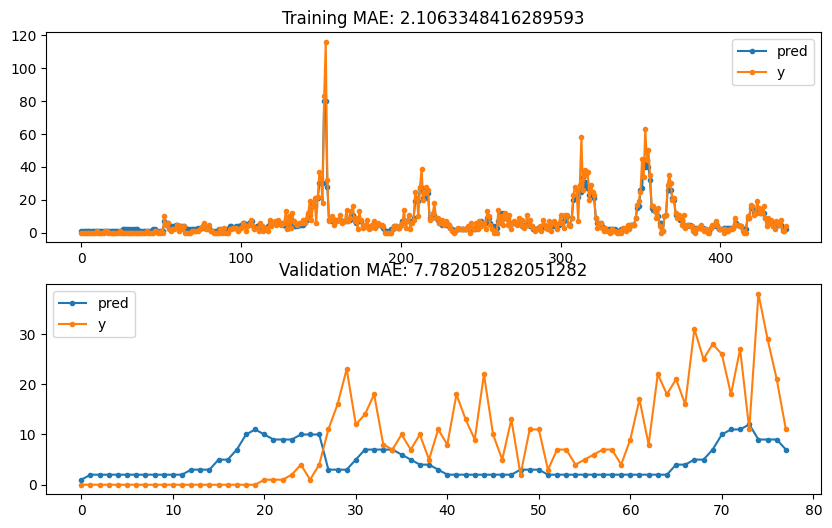

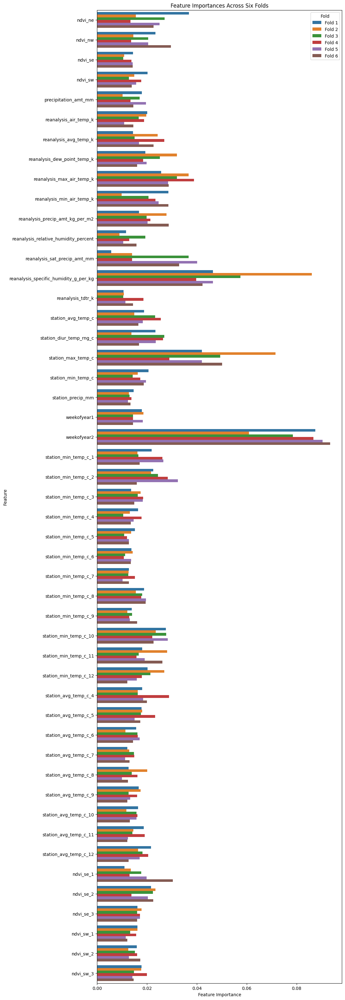

In [23]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15)
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                #    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                #    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='count:poisson',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold],y_train_iq[fold],
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 40))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()


# # Plot feature importances for three folds
# fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
# importances = xg_reg_sj[0].feature_importances_
# feat_imp = X_train_sj[0].columns
# ax2[0].barh(feat_imp,importances)

# importances = xg_reg_sj[1].feature_importances_
# feat_imp = X_train_sj[1].columns
# ax2[1].barh(feat_imp,importances)

# importances = xg_reg_sj[2].feature_importances_
# feat_imp = X_train_sj[2].columns
# ax2[2].barh(feat_imp,importances)

# fig2.tight_layout()

### Playground

#### Try circular weekofyear, combined cities, higher n_estimators


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

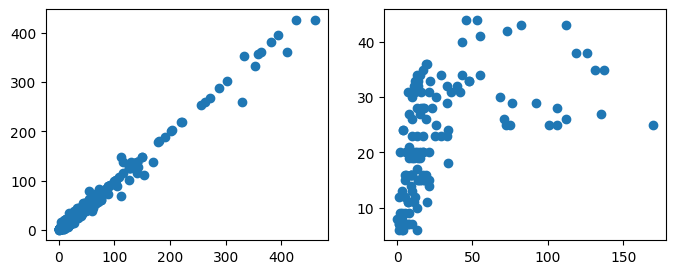

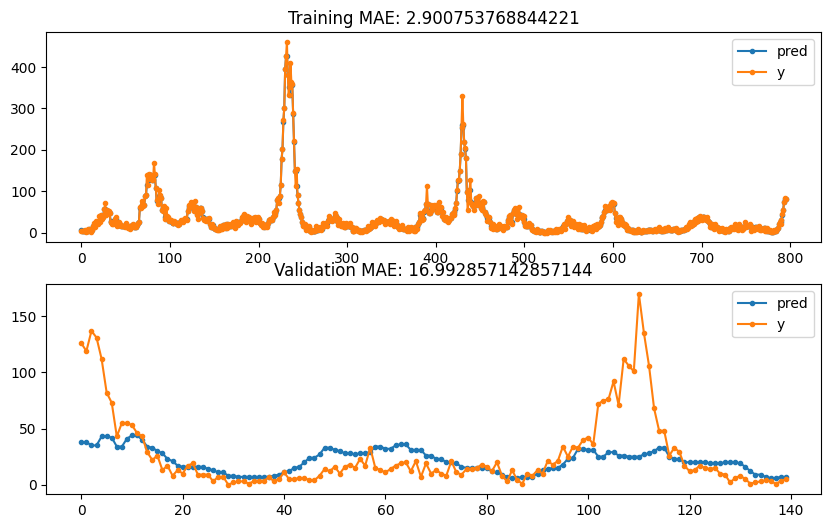

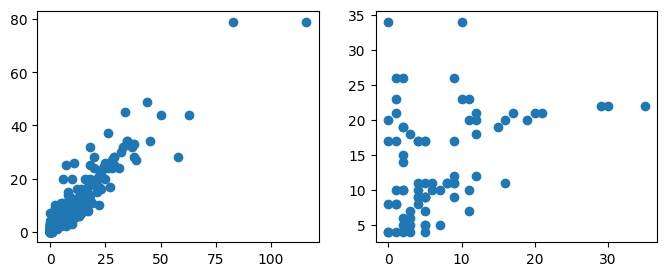

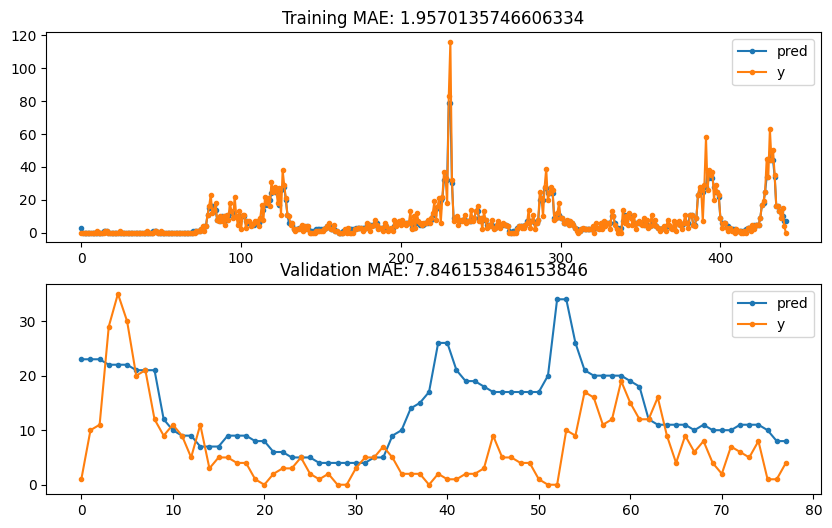

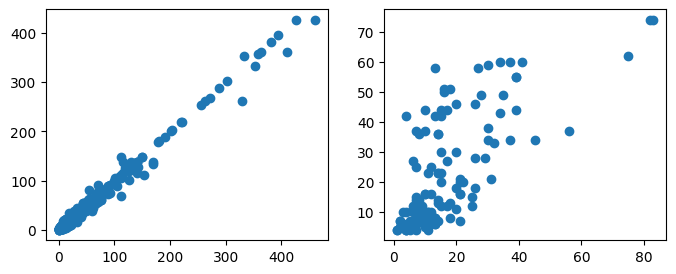

...

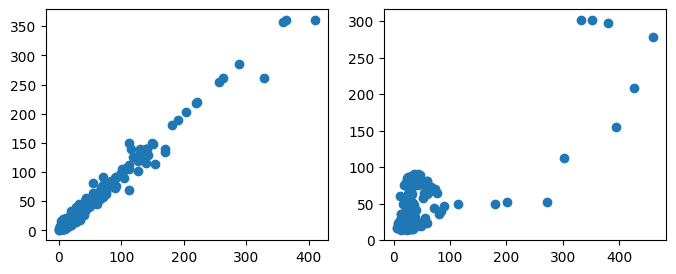

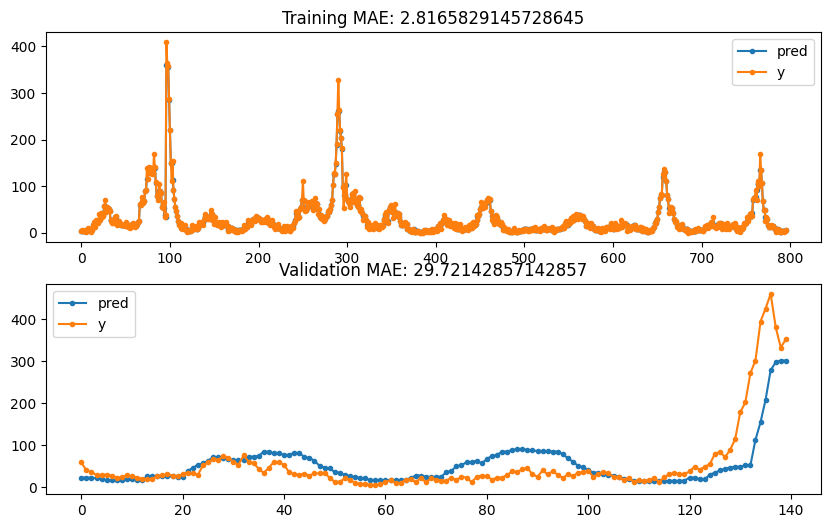

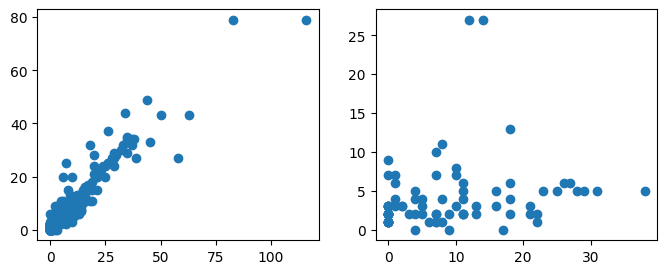

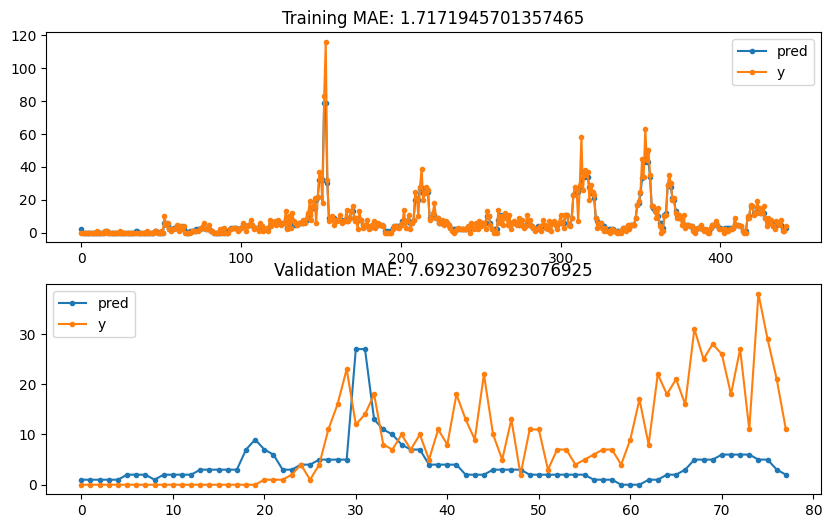

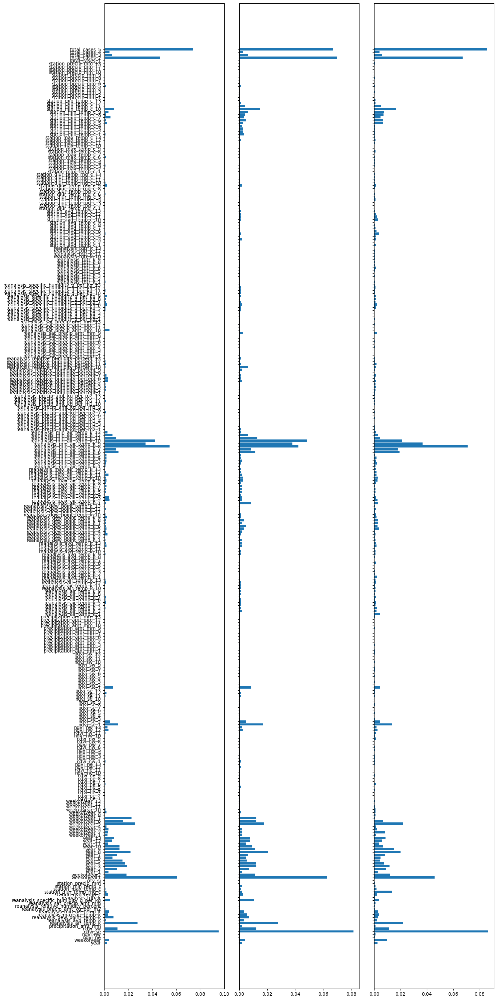

In [20]:
# Specify modelling parameters
label_lags=(1,2,3,4,5)
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
xg_reg = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = feature_names,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags, circular_weekofyear=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Combine datasets into tuples if training together
X_train = list(zip(X_train_sj,X_train_iq))
X_val = list(zip(X_val_sj,X_val_iq))
y_train = list(zip(y_train_sj,y_train_iq))
y_val = list(zip(y_val_sj,y_val_iq))

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.05

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg.append(create_XGBmodel(eta=0.01,n_estimators=1500,max_depth=6,
                                     objective='reg:squarederror',
                                     reg_alpha=10,reg_lambda=1))
    modelfit(xg_reg[fold],
             pd.concat(X_train[fold],axis=0),
             pd.concat(y_train[fold],axis=0),
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    
    pred_train, pred_val,train_mae, val_mae = eval_and_plot(xg_reg[fold],
                                                            X_train[fold],
                                                            y_train[fold],
                                                            X_val[fold],
                                                            y_val[fold],
                                                            label_lags=label_lags,
                                                            verbose=False,plot=True, MC=None,
                                                            get_pred_train=True,two_cities=True,
                                                            median_filter=True)
    

# Plot feature importances for three folds
fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
importances = xg_reg[0].feature_importances_
feat_imp = X_train[0][0].columns
ax2[0].barh(feat_imp,importances)

importances = xg_reg[1].feature_importances_
feat_imp = X_train[1][0].columns
ax2[1].barh(feat_imp,importances)

importances = xg_reg[2].feature_importances_
feat_imp = X_train[2][0].columns
ax2[2].barh(feat_imp,importances)

fig2.tight_layout()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

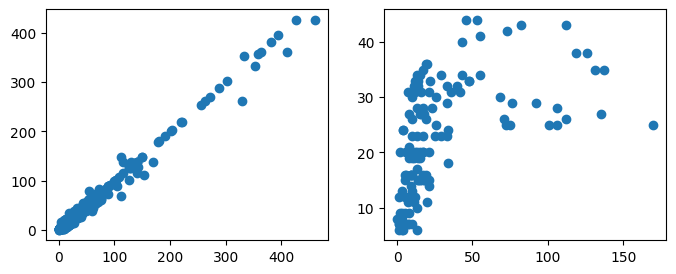

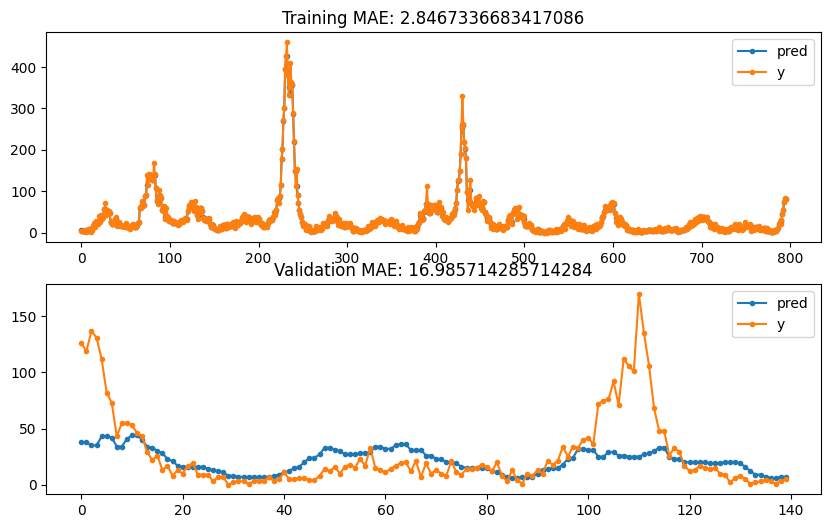

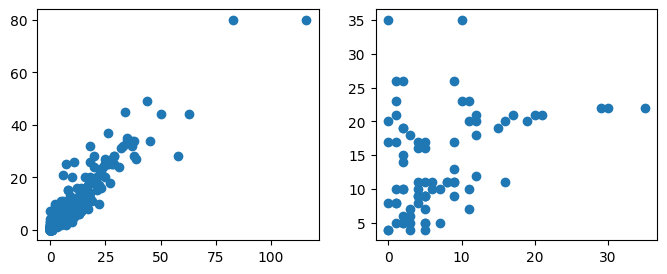

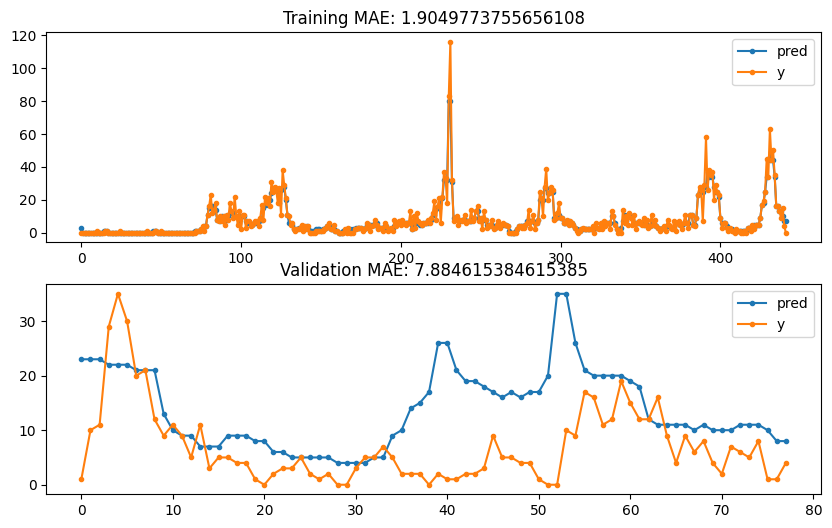

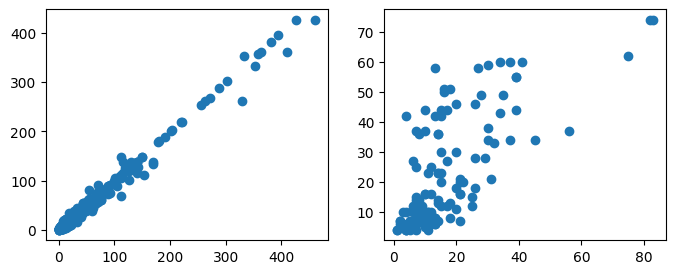

...

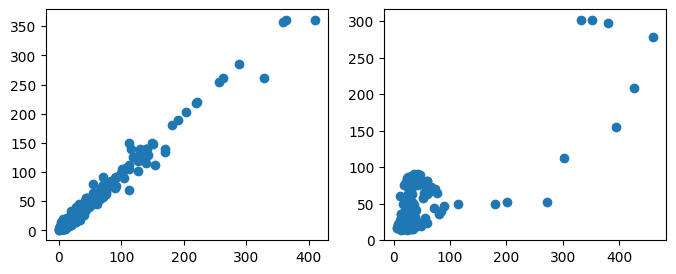

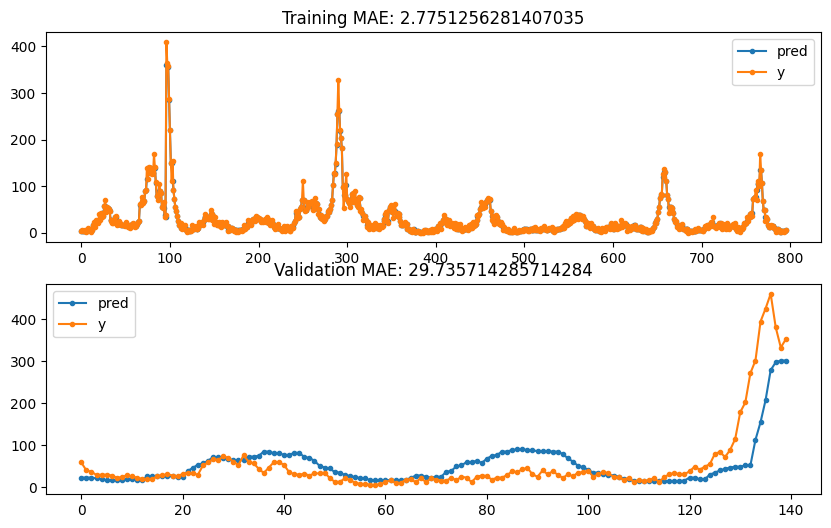

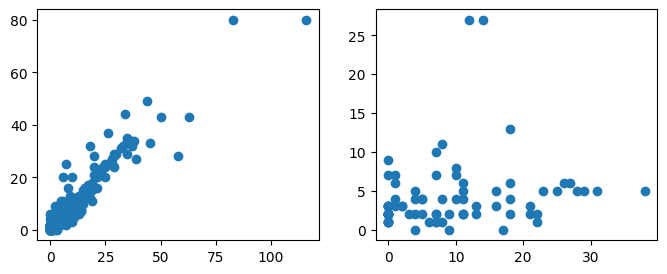

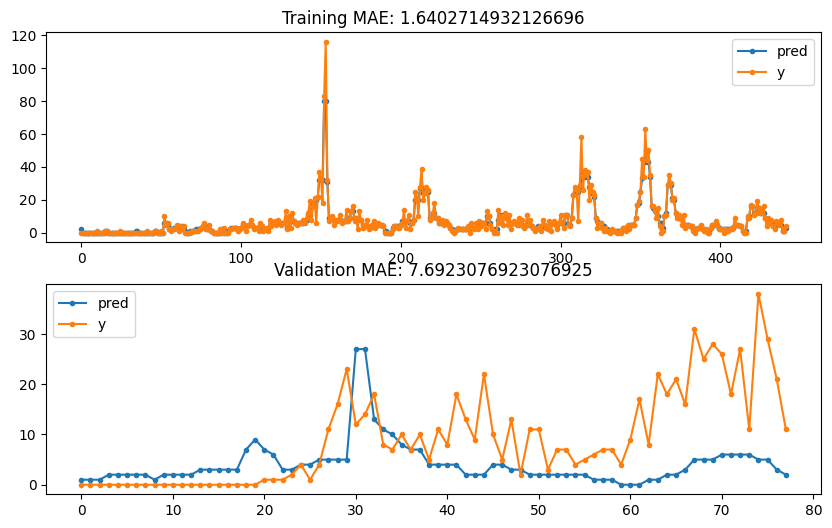

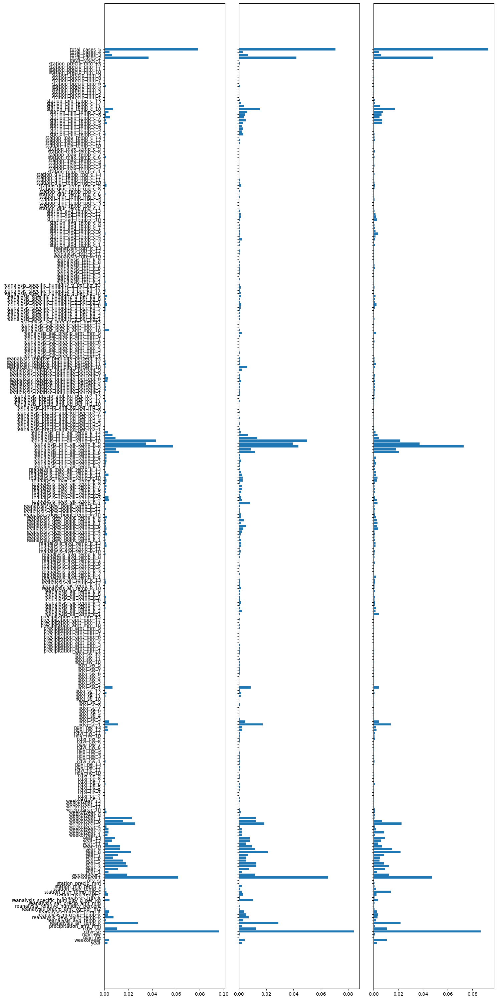

In [21]:
# Specify modelling parameters
label_lags=(1,2,3,4,5)
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
xg_reg = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = feature_names,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags, circular_weekofyear=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Combine datasets into tuples if training together
X_train = list(zip(X_train_sj,X_train_iq))
X_val = list(zip(X_val_sj,X_val_iq))
y_train = list(zip(y_train_sj,y_train_iq))
y_val = list(zip(y_val_sj,y_val_iq))

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.05

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg.append(create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=6,
                                     objective='reg:squarederror',
                                     reg_alpha=10,reg_lambda=1))
    modelfit(xg_reg[fold],
             pd.concat(X_train[fold],axis=0),
             pd.concat(y_train[fold],axis=0),
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    
    pred_train, pred_val,train_mae, val_mae = eval_and_plot(xg_reg[fold],
                                                            X_train[fold],
                                                            y_train[fold],
                                                            X_val[fold],
                                                            y_val[fold],
                                                            label_lags=label_lags,
                                                            verbose=False,plot=True, MC=None,
                                                            get_pred_train=True,two_cities=True,
                                                            median_filter=True)
    

# Plot feature importances for three folds
fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
importances = xg_reg[0].feature_importances_
feat_imp = X_train[0][0].columns
ax2[0].barh(feat_imp,importances)

importances = xg_reg[1].feature_importances_
feat_imp = X_train[1][0].columns
ax2[1].barh(feat_imp,importances)

importances = xg_reg[2].feature_importances_
feat_imp = X_train[2][0].columns
ax2[2].barh(feat_imp,importances)

fig2.tight_layout()

In [17]:
'weekofyear' in sj_features.columns

False

#### parametric reg:squarederror

In [8]:
# Specify modelling parameters
label_lags=(1,2,3,4,5)
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags, circular_weekofyear=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Combine datasets into tuples if training together
X_train = list(zip(X_train_sj,X_train_iq))
X_val = list(zip(X_val_sj,X_val_iq))
y_train = list(zip(y_train_sj,y_train_iq))
y_val = list(zip(y_val_sj,y_val_iq))

n_estims = [1000,1500,2000,2500]
lagged_label_weights = [1,0.1,0.05,0.02]
max_depths = [5,6,7,8]

counter = 0
with open('param_stud_1.txt', 'a') as file:
    for n_estimators in n_estims:
        for lagged_label_weight in lagged_label_weights:
            for max_depth in max_depths:
                xg_reg = []

                # Reducing all lagged label weights to reduce their selection
                feature_weights = 100*np.ones(X_train_sj[0].shape[1])
                feature_weights[-len(label_lags):] = lagged_label_weight

                for fold in range(folds):
                    counter += 1
                    if counter <289:
                        continue
                    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
                    xg_reg.append(create_XGBmodel(eta=0.01,n_estimators=n_estimators,max_depth=max_depth,
                                                    objective='reg:squarederror',
                                                    reg_alpha=10,reg_lambda=1))
                    modelfit(xg_reg[fold],
                            pd.concat(X_train[fold],axis=0),
                            pd.concat(y_train[fold],axis=0),
                            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                            trainCV_metrics = 'mae', eval_metric = 'mae',
                            report_metric = metrics.mean_absolute_error, verbose=False,
                            feature_weights=feature_weights)
                    
                    pred_train, pred_val,train_mae, val_mae = eval_and_plot(xg_reg[fold],
                                                                            X_train[fold],
                                                                            y_train[fold],
                                                                            X_val[fold],
                                                                            y_val[fold],
                                                                            label_lags=label_lags,
                                                                            verbose=False,plot=False, MC=None,
                                                                            get_pred_train=True,two_cities=True,
                                                                            median_filter=True)
                    message = f'Iteration:{counter}, n_estimators:{n_estimators}, lagged_label_weights:{lagged_label_weight}, max_depth:{max_depth}, fold:{fold}, train_mae:{train_mae}, val_mae:{val_mae}\n'
                    print(message)
                    file.write(message)
                    file.flush()





 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported
Iteration:289, n_estimators:2500, lagged_label_weights:1, max_depth:5, fold:0, train_mae:[np.float64(3.3266331658291457), np.float64(2.009049773755656)], val_mae:[np.float64(16.557142857142857), np.float64(7.769230769230769)]


 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                       

In [93]:
xg_reg

[XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.84, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.51, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=1.02, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=1000, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...),
 XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.84, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval

In [9]:
with open('param_stud_1.txt', 'r') as file:
    lines = file.readlines()

In [30]:
# Function to parse each string and extract the required values
def parse_string(s):
    # Regex to match the desired values
    pattern = re.compile(r'Iteration:(\d+), n_estimators:(\d+), lagged_label_weights:([0-9.]+), max_depth:(\d+), fold:(\d+), '
                         r'train_mae:\[np\.float64\(([^)]+)\), np\.float64\(([^)]+)\)\], '
                         r'val_mae:\[np\.float64\(([^)]+)\), np\.float64\(([^)]+)\)\]')
    
    match = pattern.match(s)
    if match:
        return {
            'Iteration': int(match.group(1)),
            'n_estimators': int(match.group(2)),
            'lagged_label_weights': float(match.group(3)),
            'max_depth': int(match.group(4)),
            'fold': int(match.group(5)),
            'train_mae1': np.float64(match.group(6)),
            'train_mae2': np.float64(match.group(7)),
            'val_mae1': np.float64(match.group(8)),
            'val_mae2': np.float64(match.group(9))
        }
    else:
        return None

# Parse all strings in the list and filter out any None values
parsed_data = [parse_string(s) for s in lines if parse_string(s) is not None]

# Create a DataFrame
df = pd.DataFrame(parsed_data)
df.drop_duplicates(subset=['n_estimators','lagged_label_weights','max_depth','fold'],inplace=True)
df = df.reset_index().reset_index()
df['Iteration'] = np.floor(df['level_0']/6)
df = df.astype({'Iteration':'int'})
df.drop(columns=['index','level_0'],inplace=True)

df = df.groupby(['Iteration']).mean()

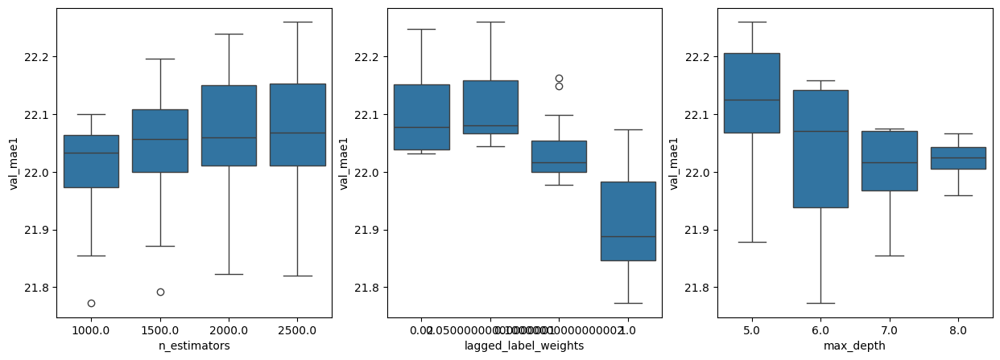

In [31]:
fig,axs = plt.subplots(1,3,figsize=(15,5))

for i,param in enumerate(['n_estimators','lagged_label_weights','max_depth']):
    sns.boxplot(df,x=param,y='val_mae1',ax=axs[i])

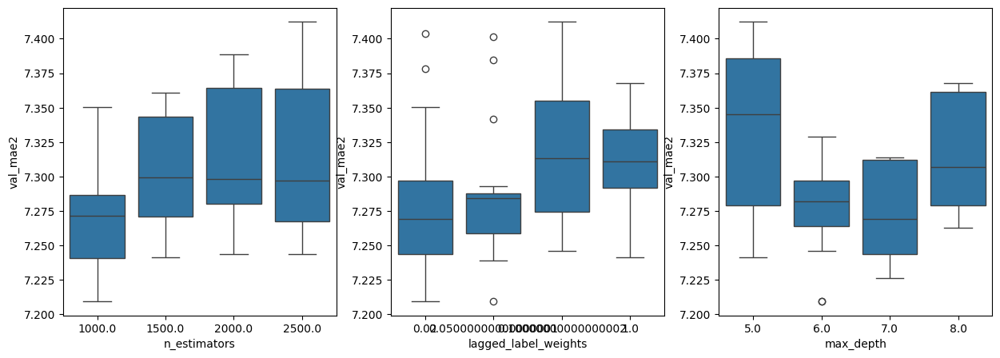

In [32]:
fig,axs = plt.subplots(1,3,figsize=(15,5))

for i,param in enumerate(['n_estimators','lagged_label_weights','max_depth']):
    sns.boxplot(df,x=param,y='val_mae2',ax=axs[i])

#### Reduce overfit

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


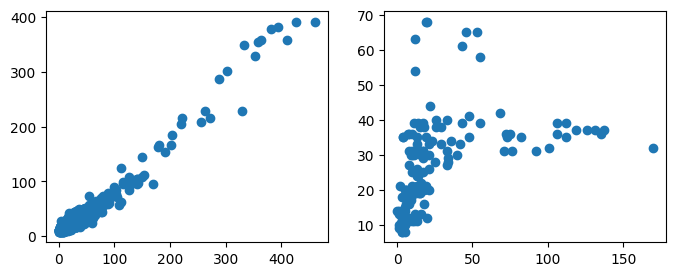

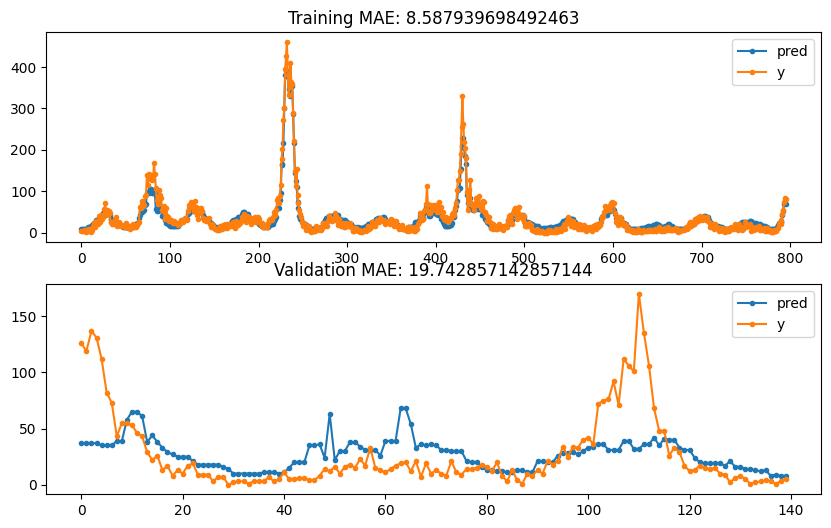

In [254]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.00001

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=6,
                                     objective='reg:squarederror',
                                     min_child_weight = 1,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


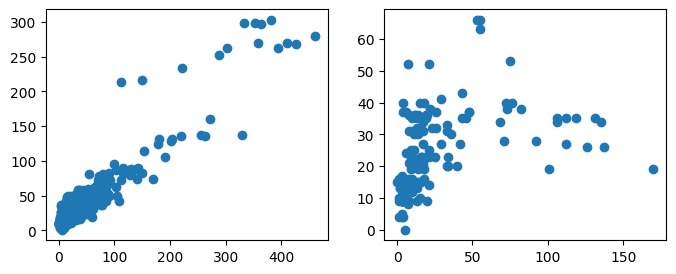

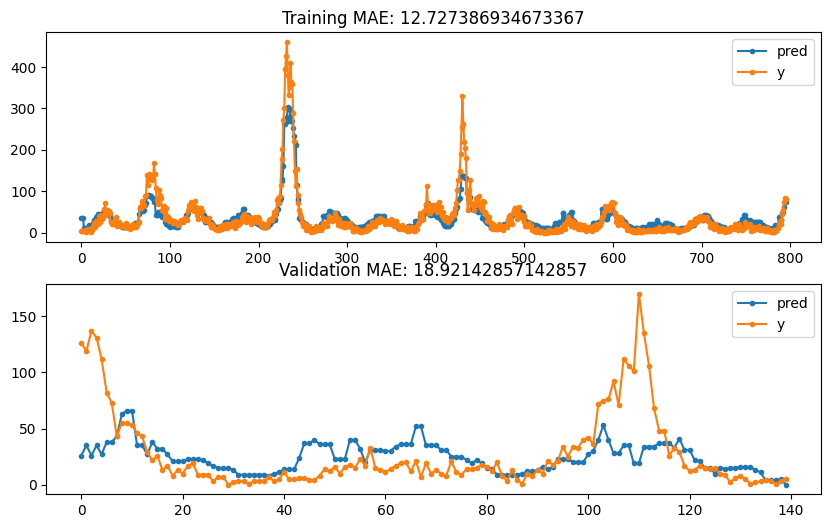

In [252]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.00001

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=6,
                                     objective='reg:squarederror',
                                     min_child_weight = 20,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


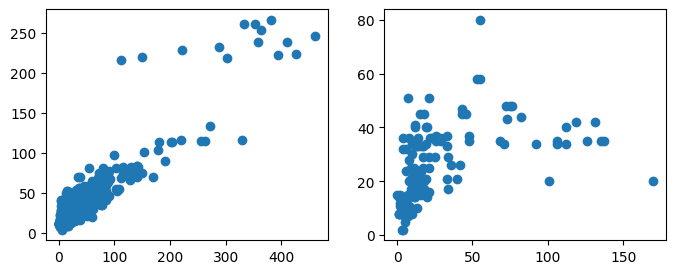

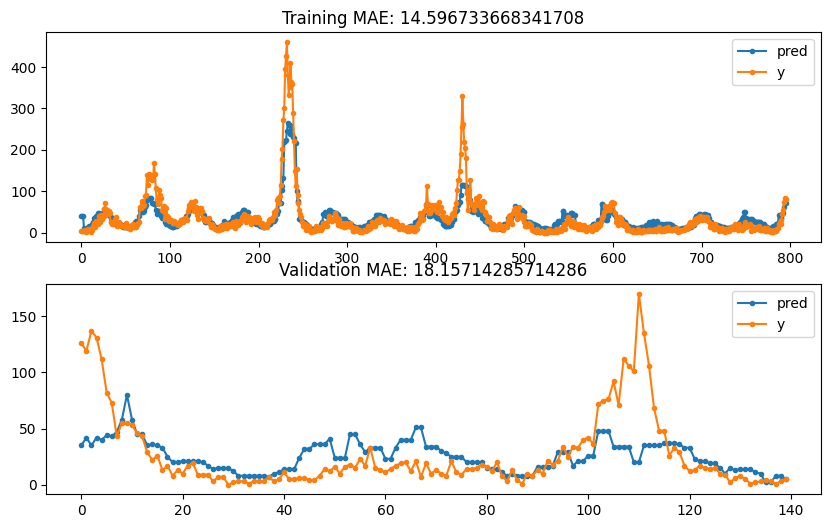

In [258]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.00001

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=6,
                                     objective='reg:squarederror',
                                     min_child_weight = 20, subsample=0.7,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


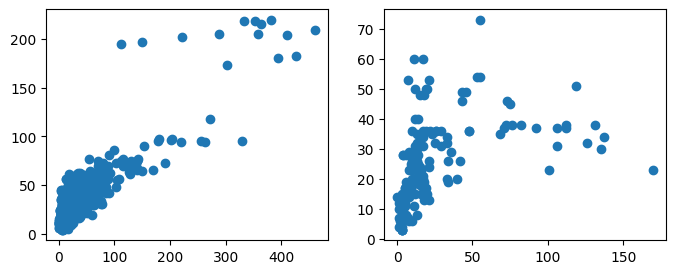

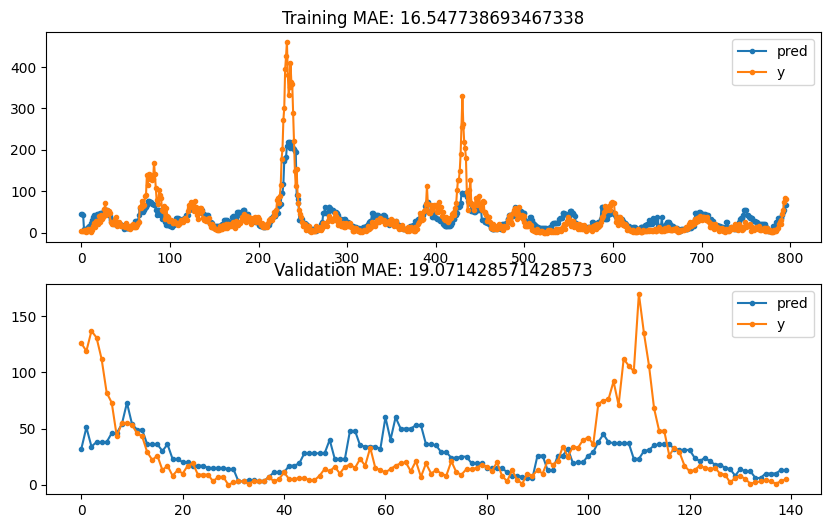

In [260]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.00001

model_sj = create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=6,
                                     objective='reg:squarederror',
                                     min_child_weight = 30, subsample=0.7,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


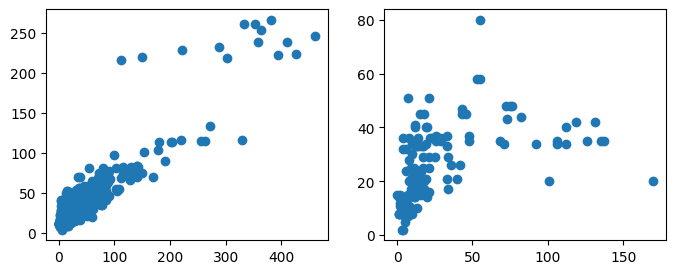

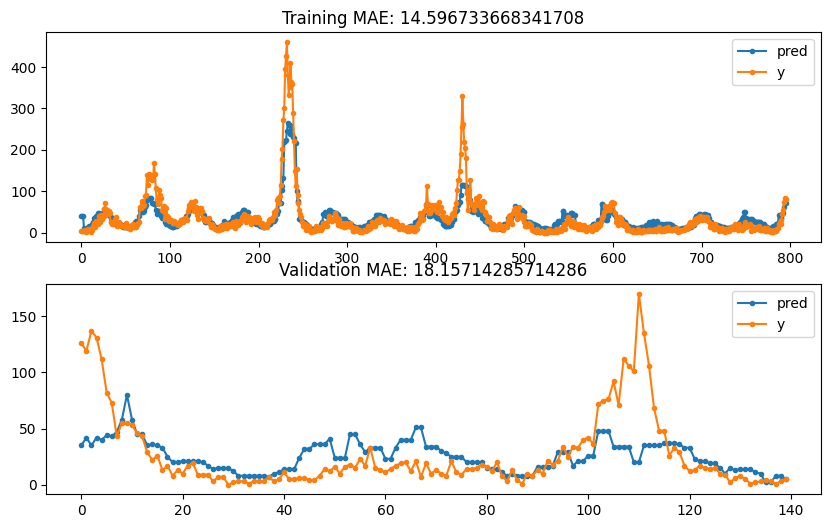

In [262]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags=(3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
feature_weights[-len(label_lags):] = 0.00001

model_sj = create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=6,
                                     objective='reg:squarederror',
                                     min_child_weight = 20, subsample=0.7,
                                     gamma=0.51,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


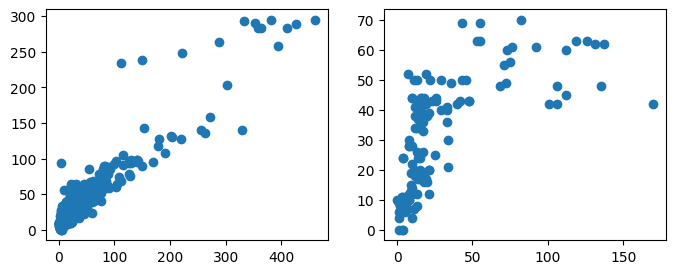

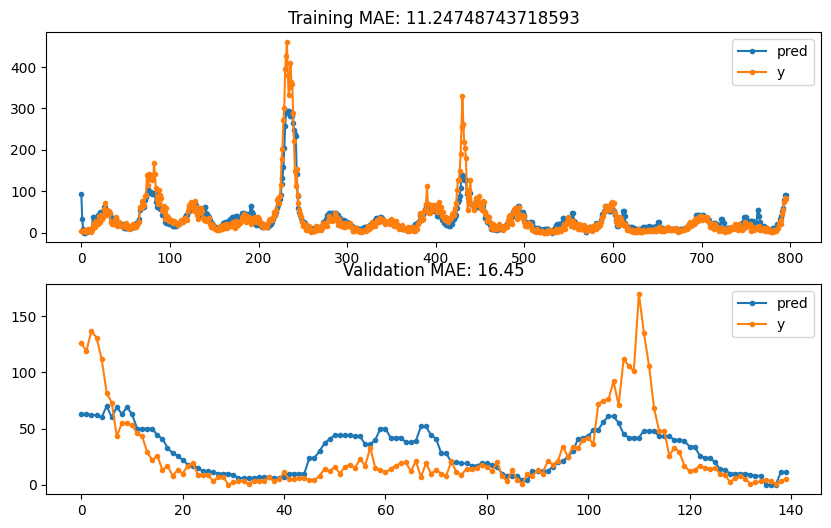

In [287]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 0.05

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=6,
                                     objective='reg:squarederror',
                                     min_child_weight = 20, subsample=0.7,
                                     gamma=1,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


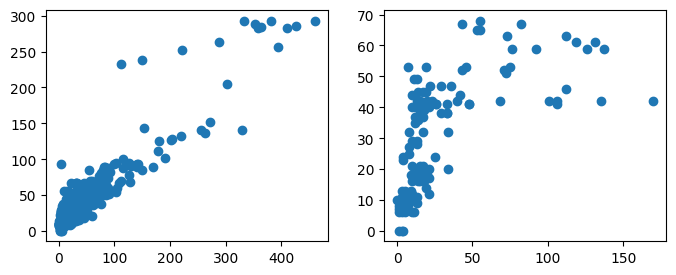

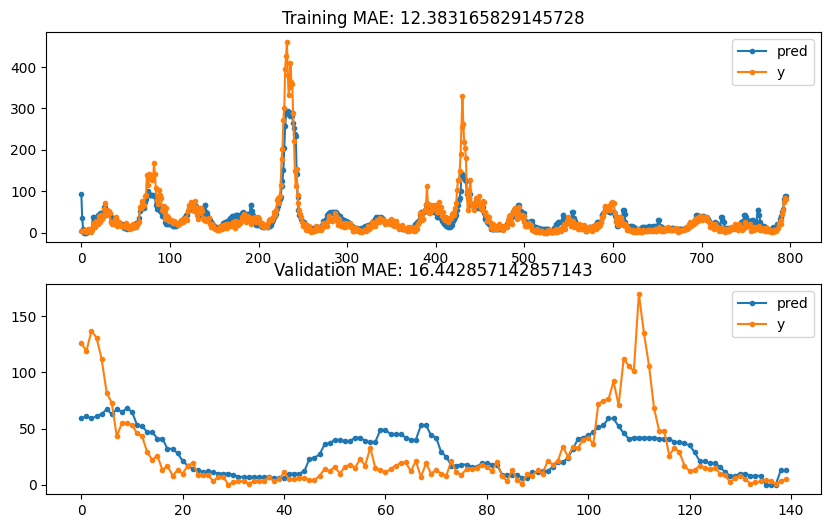

In [290]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 0.05

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 20, subsample=0.7,
                                     gamma=10,colsample_bytree = 0.84,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


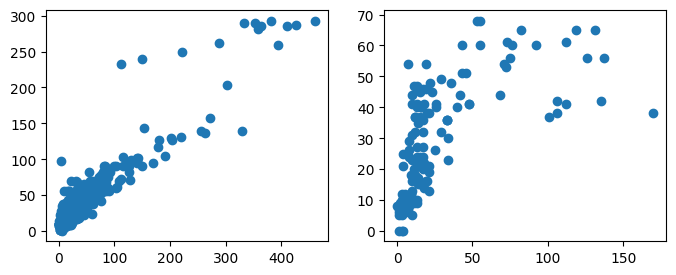

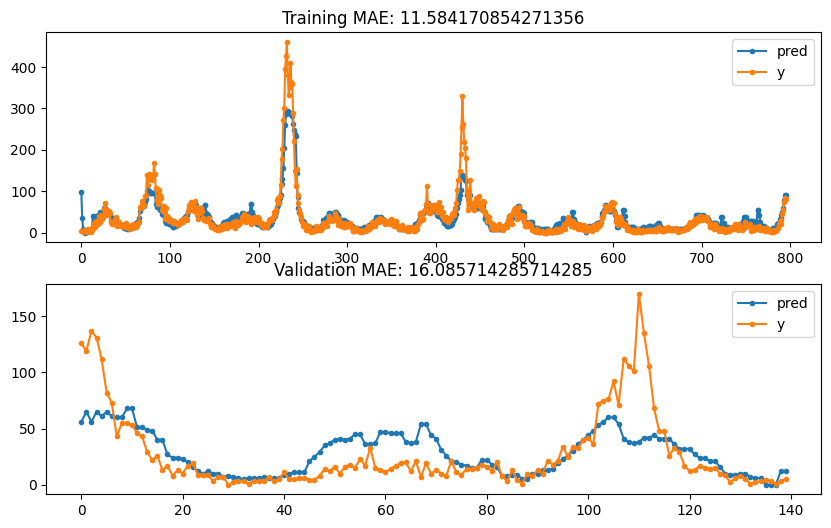

In [310]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 0.05

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=6,
                                     objective='reg:squarederror',
                                     min_child_weight = 20, subsample=0.7,
                                     gamma=1000,colsample_bytree = 0.6,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj[0], y_train_sj[0],
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        # trainCV_metrics = 'rmse', eval_metric = 'mae',
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(model_sj,X_train_sj[0],y_train_sj[0],
                                        X_val_sj[0],y_val_sj[0], label_lags=label_lags,
                                        verbose=False,plot=True, MC=None, get_pred_train=True,
                                        median_filter=True)

In [326]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 0.05

model_sj = create_XGBmodel(objective='reg:squarederror')

# model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=6,
#                                      objective='reg:squarederror',
#                                      min_child_weight = 20, subsample=0.7,
#                                      gamma=1000,colsample_bytree = 0.6,
#                                      reg_alpha=1,reg_lambda=1)

# Define parameter grid
param_grid = {
    'max_depth': [8], # 4 6 8
    'eta': [0.01, 0.05, 0.1],  # eta is the same as learning_rate
    'n_estimators': [500,1000,2000],
    'subsample': [0.6, 0.8],
    'colsample_bytree': [0.6, 0.8],
    'gamma': [10,1000],
    'reg_alpha': [0.1, 10],
    'reg_lambda': [0.1, 10],
    'min_child_weight': [10,20,50]
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=model_sj, param_grid=param_grid, scoring='neg_mean_absolute_error', cv=5, verbose=1, n_jobs=-1)

# Perform grid search
grid_search.fit(sj_features, sj_labels)

with open('GSCV_nolabellags_SJ_8.pkl','wb') as f:
        pickle.dump(grid_search,f)

# # Best parameters and best score
# best_params = grid_search.best_params_
# best_score = grid_search.best_score_

# print(f"Best parameters: {best_params}")
# print(f"Best cross-validation score: {best_score}")

# # Evaluate the best model on the test set
# best_model = grid_search.best_estimator_
# y_pred = best_model.predict(X_test)
# test_accuracy = accuracy_score(y_test, y_pred)

# print(f"Test set accuracy: {test_accuracy}")


Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported
Fitting 5 folds for each of 864 candidates, totalling 4320 fits


In [13]:
with open('GSCV_nolabellags_SJ_4.pkl','rb') as f:
        grid_search_4 = pickle.load(f)

with open('GSCV_nolabellags_SJ_6.pkl','rb') as f:
        grid_search_6 = pickle.load(f)

with open('GSCV_nolabellags_SJ_8.pkl','rb') as f:
        grid_search_8 = pickle.load(f)

df_results = pd.concat([pd.DataFrame(grid_search_4.cv_results_),
                        pd.DataFrame(grid_search_6.cv_results_),
                        pd.DataFrame(grid_search_8.cv_results_)],axis=0)
params = ['param_colsample_bytree', 'param_eta', 'param_gamma', 'param_max_depth',
       'param_min_child_weight', 'param_n_estimators', 'param_reg_alpha',
       'param_reg_lambda', 'param_subsample']

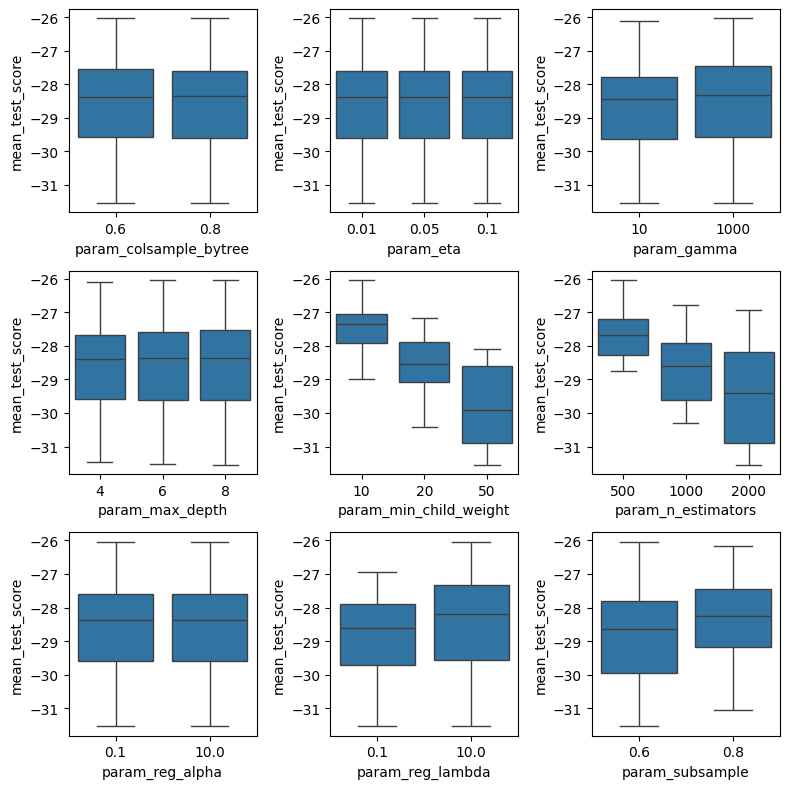

In [16]:
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(params):
    sns.boxplot(df_results, x=param, y='mean_test_score',ax=axs[i])
fig.tight_layout()

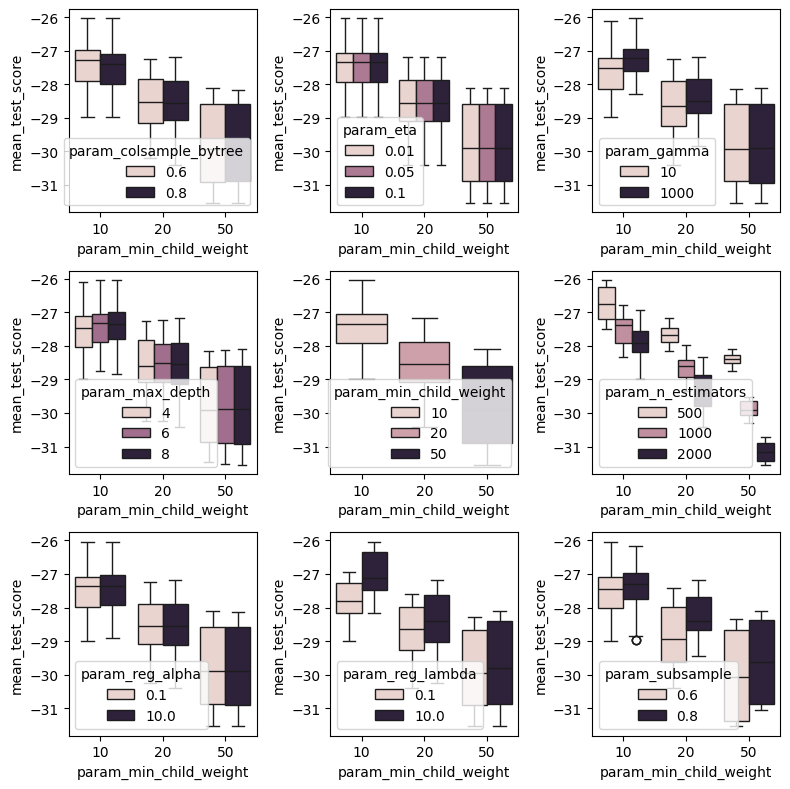

In [17]:
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(params):
    sns.boxplot(df_results, x='param_min_child_weight', y='mean_test_score', hue=param, ax=axs[i])
fig.tight_layout()

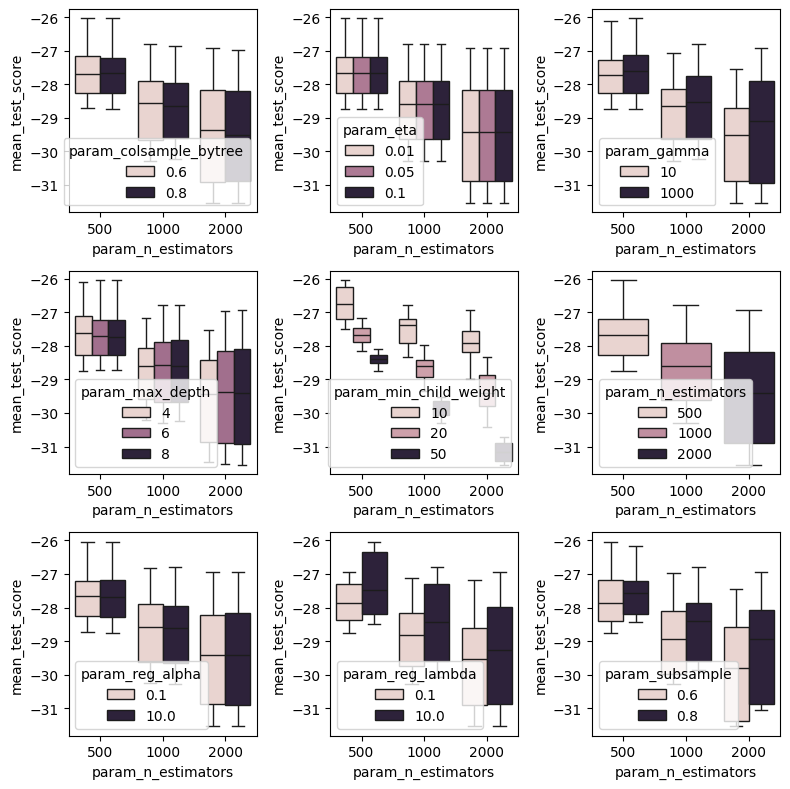

In [18]:
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(params):
    sns.boxplot(df_results, x='param_n_estimators', y='mean_test_score', hue=param, ax=axs[i])
fig.tight_layout()

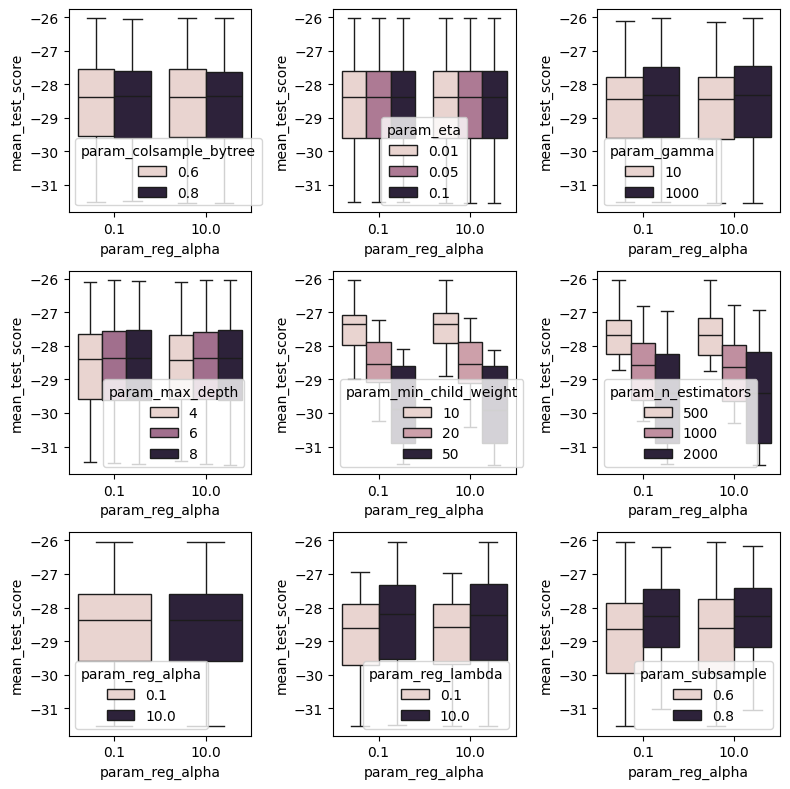

In [23]:
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(params):
    sns.boxplot(df_results, x='param_reg_alpha', y='mean_test_score', hue=param, ax=axs[i])
fig.tight_layout()

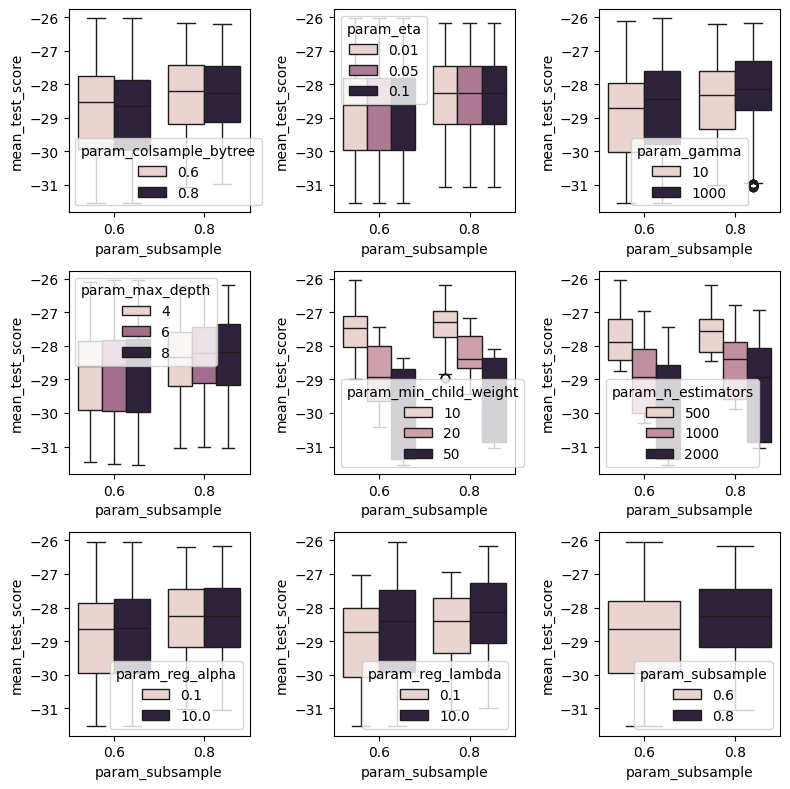

In [20]:
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(params):
    sns.boxplot(df_results, x='param_subsample', y='mean_test_score', hue=param, ax=axs[i])
fig.tight_layout()

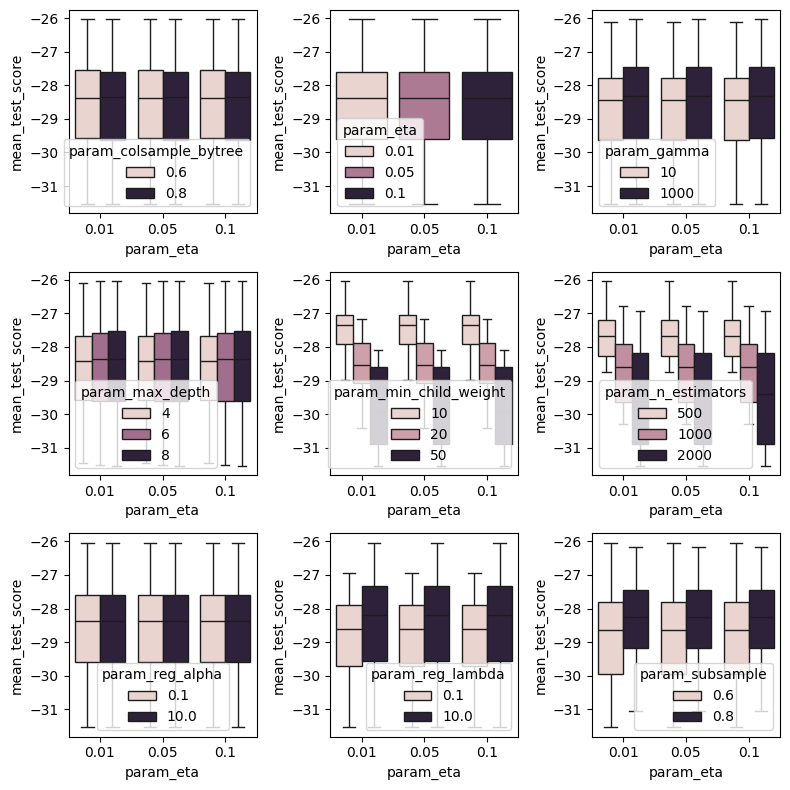

In [22]:
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(params):
    sns.boxplot(df_results, x='param_eta', y='mean_test_score', hue=param, ax=axs[i])
fig.tight_layout()

In [37]:
feature_names

['weekofyear',
 'ndvi_ne',
 'ndvi_nw',
 'ndvi_se',
 'ndvi_sw',
 'precipitation_amt_mm',
 'reanalysis_air_temp_k',
 'reanalysis_avg_temp_k',
 'reanalysis_dew_point_temp_k',
 'reanalysis_max_air_temp_k',
 'reanalysis_min_air_temp_k',
 'reanalysis_precip_amt_kg_per_m2',
 'reanalysis_relative_humidity_percent',
 'reanalysis_sat_precip_amt_mm',
 'reanalysis_specific_humidity_g_per_kg',
 'reanalysis_tdtr_k',
 'station_avg_temp_c',
 'station_diur_temp_rng_c',
 'station_max_temp_c',
 'station_min_temp_c',
 'station_precip_mm']

In [ ]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = [col for col in feature_names if col !='weekofyear']
lagged_features = ['station_min_temp_c','station_avg_temp_c','reanalysis_specific_humidity_g_per_kg',
                   'reanalysis_dew_point_temp_k','ndvi_se']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 10

# model_sj = create_XGBmodel(eta=0.024,n_estimators=272,max_depth=5,
#                                      objective='reg:squarederror',
#                                      min_child_weight = 1, subsample=0.7,
#                                      gamma=281.2,colsample_bytree = 0.9,
#                                      reg_alpha=0.0925,reg_lambda=8.36)

model_sj = create_XGBmodel(eta=0.04,n_estimators=300,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 3, subsample=0.8,
                                     gamma=2.2,colsample_bytree = 0.9,
                                     reg_alpha=34,reg_lambda=0.2)

modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=False, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []
sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### optuna

In [95]:
# Specify modelling parameters
label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
feature_lags=(1,2,3,4,5,6,7,8,9,10,11)
# lagged_features = [col for col in feature_names if col !='weekofyear']
# lagged_features = ['station_min_temp_c','station_avg_temp_c','reanalysis_specific_humidity_g_per_kg',
#                    'reanalysis_dew_point_temp_k','ndvi_se']
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X = sj_features.to_numpy()
y = np.squeeze(sj_labels.to_numpy())

trial_results = []

# Define an objective function
def objective(trial):
    # Suggest hyperparameters
    param = {
        'tree_method': 'gpu_hist',  # Use 'gpu_hist' if you have a GPU
        'seed': 42,
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 100),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 100),
        'gamma': trial.suggest_loguniform('gamma', 1e-1, 10000),
        'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.5, 0.6,0.7,0.8, 0.9, 1.0]),
        'subsample': trial.suggest_categorical('subsample', [0.5,0.6, 0.7,0.8, 0.9, 1.0]),
        'learning_rate': trial.suggest_loguniform('learning_Rate', 0.01, 0.3),
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 100),
    }

    # Create the model
    model = xgb.XGBRegressor(**param)

    # Perform 5-fold cross-validation
    kf = KFold(n_splits=5, shuffle=True, random_state=42)

    for fold, (train_index, val_index) in enumerate(kf.split(X)):
        X_train, X_val = X[train_index], X[val_index]
        y_train, y_val = y[train_index], y[val_index]
        
        model.fit(X_train, y_train)
        y_train_pred = np.clip(np.round(model.predict(X_train)),0,100000)
        y_val_pred = np.clip(np.round(model.predict(X_val)),0,100000)

        train_mae = mean_absolute_error(y_train, y_train_pred)
        val_mae = mean_absolute_error(y_val, y_val_pred)
        
        # Collect the trial result for each fold
        trial_results.append({
            'trial_number': trial.number,
            'params': param,
            'fold': fold + 1,
            'train_score': train_mae,
            'val_score': val_mae
        })

    # Return the mean validation score (negative)
    return np.mean([result['val_score'] for result in trial_results if result['trial_number'] == trial.number])

# Create a study and optimize
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)

# Access the best trial
best_trial = study.best_trial
optuna_results_df = pd.DataFrame(trial_results)
optuna_results_df = pd.concat([optuna_results_df, pd.json_normalize(optuna_results_df['params'])], axis=1)
optuna_results_df.drop(columns=['params'],inplace=True)

[I 2024-07-08 16:17:48,862] A new study created in memory with name: no-name-9bffe157-85fa-4de9-b320-fd88ca617cfa


[I 2024-07-08 16:17:49,339] Trial 0 finished with value: 23.10216179315053 and parameters: {'reg_lambda': 0.14433021964130308, 'reg_alpha': 0.0027682490852188207, 'gamma': 4448.697555203973, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_Rate': 0.040058069154304786, 'n_estimators': 137, 'max_depth': 5, 'min_child_weight': 50}. Best is trial 0 with value: 23.10216179315053.
[I 2024-07-08 16:17:50,706] Trial 1 finished with value: 20.66781203777449 and parameters: {'reg_lambda': 0.07081625457902627, 'reg_alpha': 0.00131293403028315, 'gamma': 0.1223961780890717, 'colsample_bytree': 0.9, 'subsample': 1.0, 'learning_Rate': 0.1638586552532587, 'n_estimators': 511, 'max_depth': 4, 'min_child_weight': 4}. Best is trial 1 with value: 20.66781203777449.
[I 2024-07-08 16:17:51,860] Trial 2 finished with value: 22.765183752417794 and parameters: {'reg_lambda': 0.11896986729216674, 'reg_alpha': 0.20207112586217532, 'gamma': 1.8187011623310723, 'colsample_bytree': 0.7, 'subsample': 0.7, 'learn

In [96]:
param_names_cat = ['colsample_bytree', 'subsample','max_depth']
param_names_num = ['reg_lambda', 'reg_alpha', 'gamma', 'learning_rate', 'n_estimators','min_child_weight']

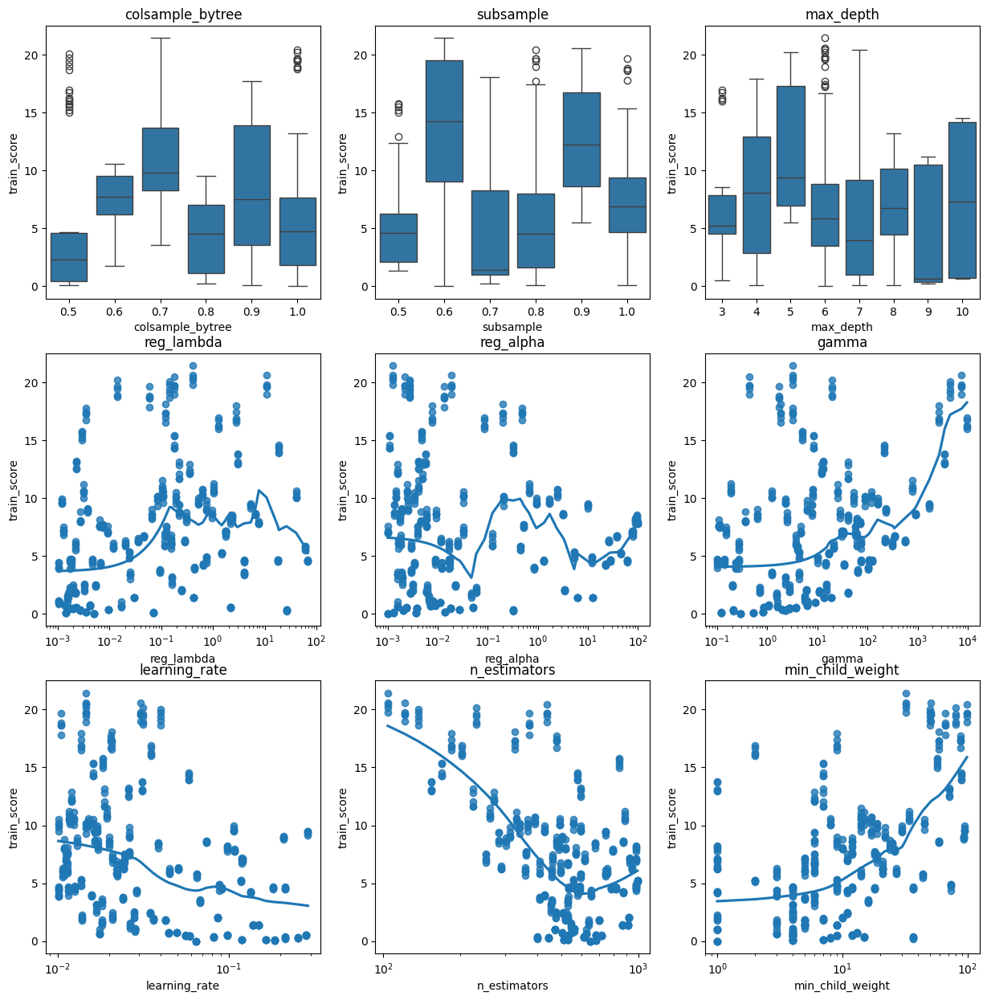

In [97]:
fig, axs = plt.subplots(3,3,figsize=(15,15))
axs = axs.flatten()
for i,param in enumerate(param_names_cat):
    sns.boxplot(optuna_results_df,x=param, y='train_score',ax=axs[i])
    axs[i].set_title(param)

for j,param in enumerate(param_names_num):
    sns.regplot(optuna_results_df, x=param, y="train_score",lowess=True, ax=axs[i+j+1])
    axs[j+i+1].set(xscale='log') 
    axs[j+i+1].set_title(param)


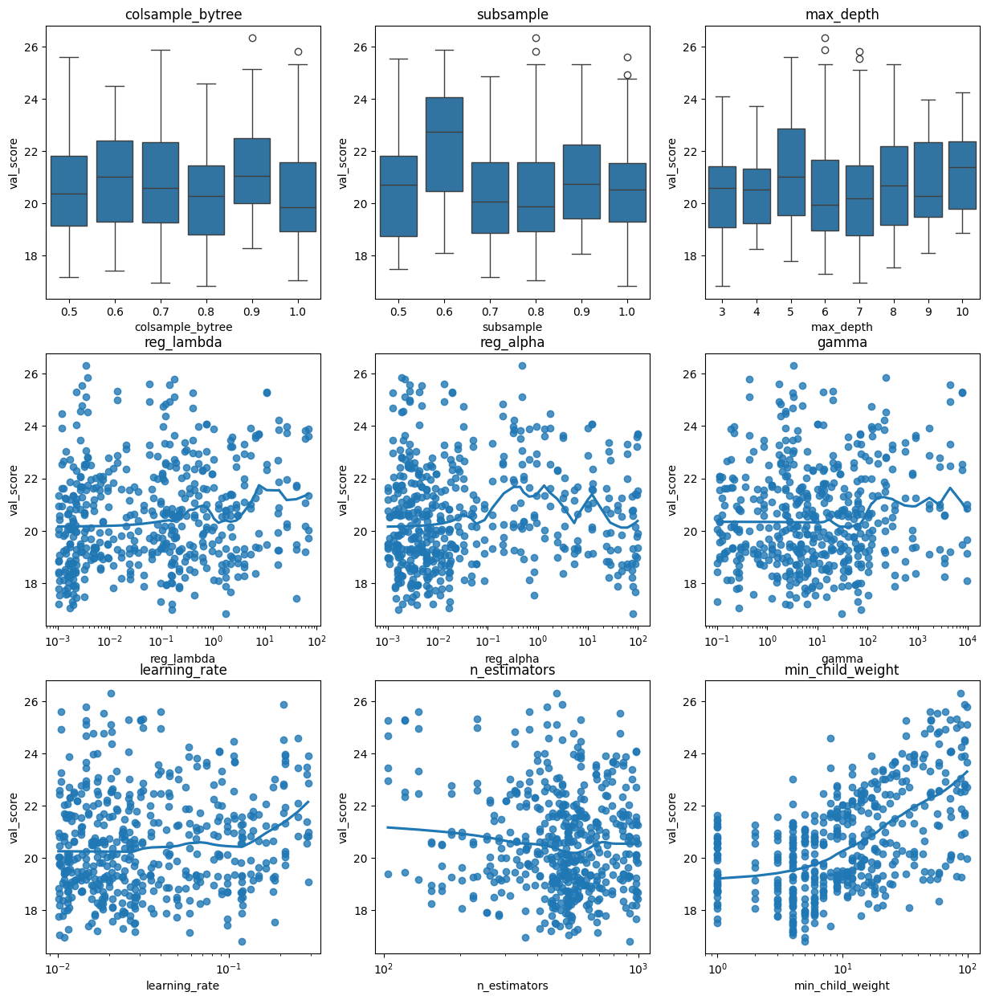

In [98]:
fig, axs = plt.subplots(3,3,figsize=(15,15))
axs = axs.flatten()
for i,param in enumerate(param_names_cat):
    sns.boxplot(optuna_results_df,x=param, y='val_score',ax=axs[i])
    axs[i].set_title(param)

for j,param in enumerate(param_names_num):
    sns.regplot(optuna_results_df, x=param, y="val_score",lowess=True, ax=axs[i+j+1])
    axs[j+i+1].set(xscale='log') 
    axs[j+i+1].set_title(param)


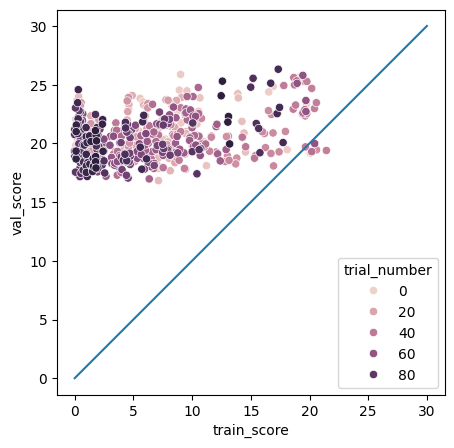

In [99]:
fig,ax = plt.subplots(1,1,figsize=(5,5))
sns.scatterplot(optuna_results_df,x='train_score',y='val_score',hue='trial_number',ax=ax)
ax.axis('equal')
ax.plot([0,30],[0,30])


(np.float64(18.63571111616794),
 np.float64(23.783983957219252),
 np.float64(1.6977494401835267),
 np.float64(23.20088318881124))

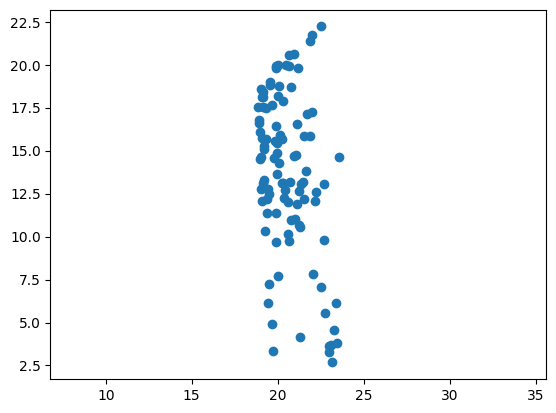

In [127]:
optuna_results_df_mean = optuna_results_df[['trial_number','train_score','val_score']].groupby('trial_number').mean()
optuna_results_df_mean['diff'] = optuna_results_df_mean['val_score'] - optuna_results_df_mean['train_score']
optuna_results_df_mean.sort_values('val_score',inplace=True)

plt.scatter(optuna_results_df_mean['val_score'],optuna_results_df_mean['diff'])
plt.axis('equal')

In [129]:
optuna_results_df_mean.sort_values('diff')

,train_score,val_score,diff
trial_number,,,
37,20.482089,23.157253,2.675165
30,19.711786,22.978251,3.266465
32,16.412083,19.739424,3.327341
44,19.375551,23.011133,3.635582
0,19.384614,23.102162,3.717548
...,...,...,...
1,0.094282,20.667812,20.573530
79,0.346957,20.974371,20.627414
25,0.528313,21.894578,21.366265


In [131]:
optuna_results_df.loc[optuna_results_df['trial_number']==37]

,trial_number,fold,train_score,val_score,tree_method,seed,reg_lambda,reg_alpha,gamma,colsample_bytree,subsample,learning_rate,n_estimators,max_depth,min_child_weight
185,37,1,20.422460,22.968085,gpu_hist,42,0.409937,0.001265,3.210446,0.7,0.6,0.014626,104,6,32
186,37,2,20.188251,24.684492,gpu_hist,42,0.409937,0.001265,3.210446,0.7,0.6,0.014626,104,6,32
187,37,3,19.774366,25.272727,gpu_hist,42,0.409937,0.001265,3.210446,0.7,0.6,0.014626,104,6,32
188,37,4,20.586115,23.465241,gpu_hist,42,0.409937,0.001265,3.210446,0.7,0.6,0.014626,104,6,32
189,37,5,21.439252,19.395722,gpu_hist,42,0.409937,0.001265,3.210446,0.7,0.6,0.014626,104,6,32



 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

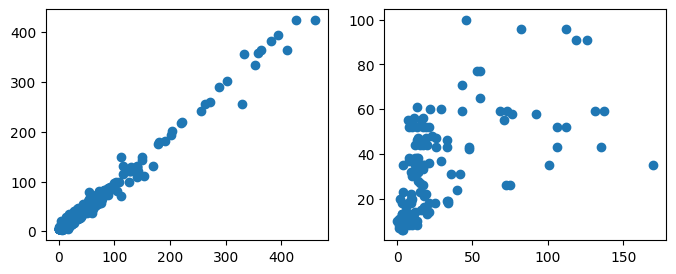

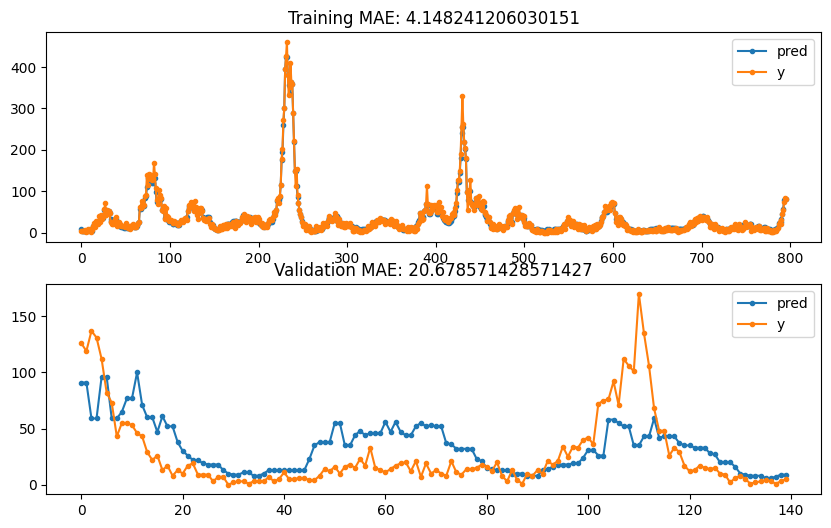

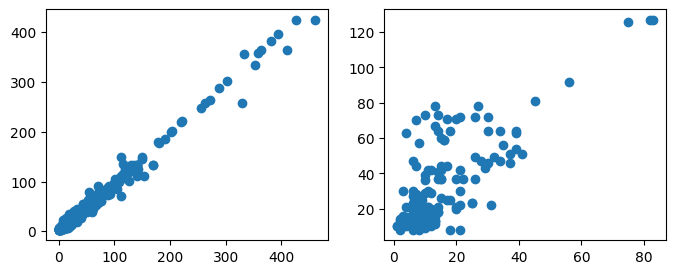

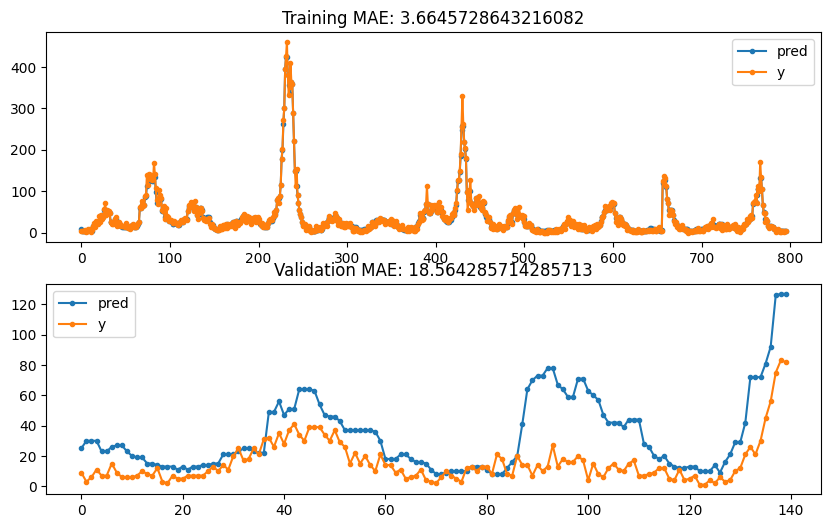

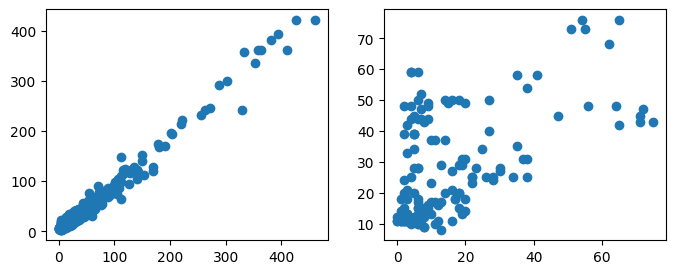

...

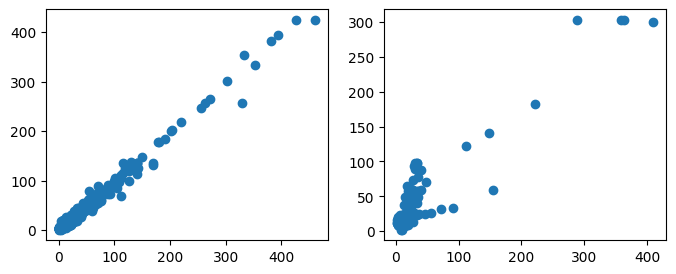

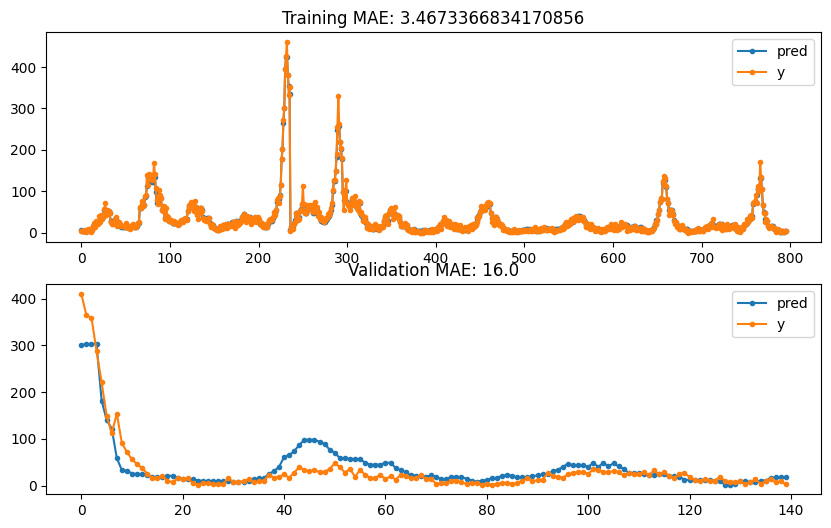

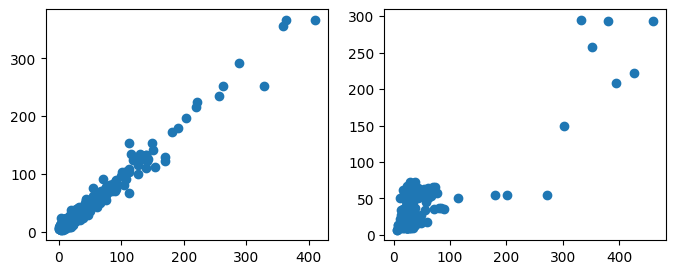

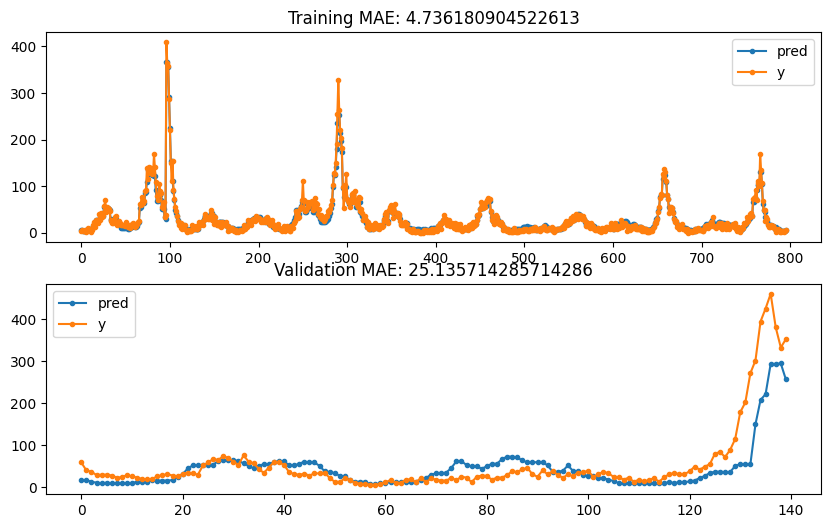

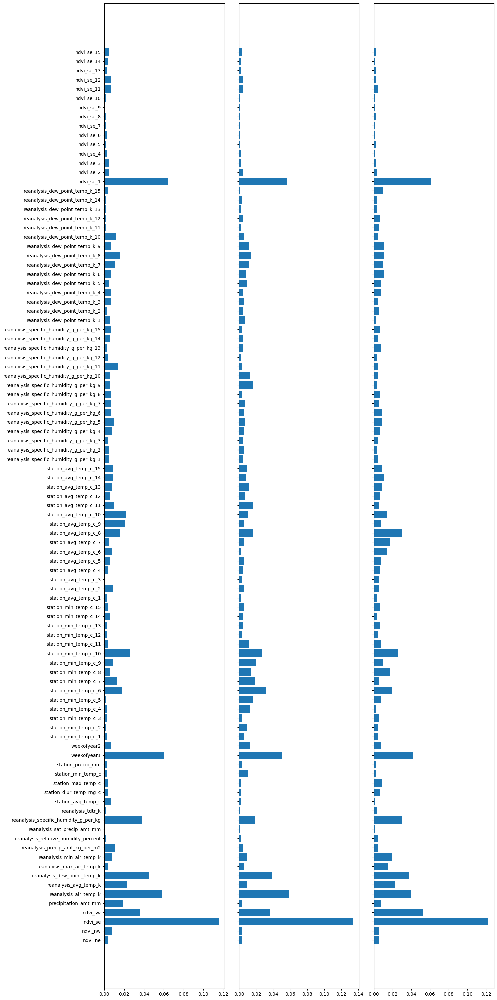

In [8]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = [col for col in feature_names if col !='weekofyear']
lagged_features = ['station_min_temp_c','station_avg_temp_c','reanalysis_specific_humidity_g_per_kg',
                   'reanalysis_dew_point_temp_k','ndvi_se']


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.04,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 3, subsample=0.8,
                                     gamma=2.2,colsample_bytree = 0.9,
                                     reg_alpha=34,reg_lambda=0.2))
    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold],y_train_sj[fold],
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Plot feature importances for three folds
fig2,ax2 = plt.subplots(1,3,figsize=(15,30),sharey=True)
importances = xg_reg_sj[0].feature_importances_
feat_imp = X_train_sj[0].columns
ax2[0].barh(feat_imp,importances)

importances = xg_reg_sj[1].feature_importances_
feat_imp = X_train_sj[1].columns
ax2[1].barh(feat_imp,importances)

importances = xg_reg_sj[2].feature_importances_
feat_imp = X_train_sj[2].columns
ax2[2].barh(feat_imp,importances)

fig2.tight_layout()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

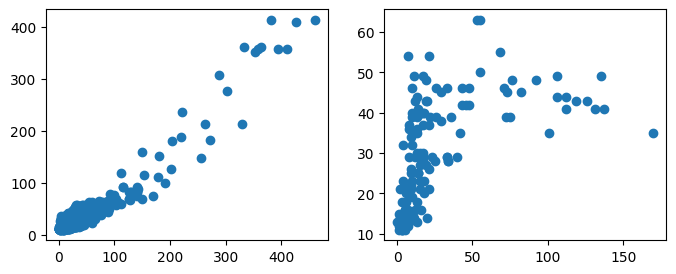

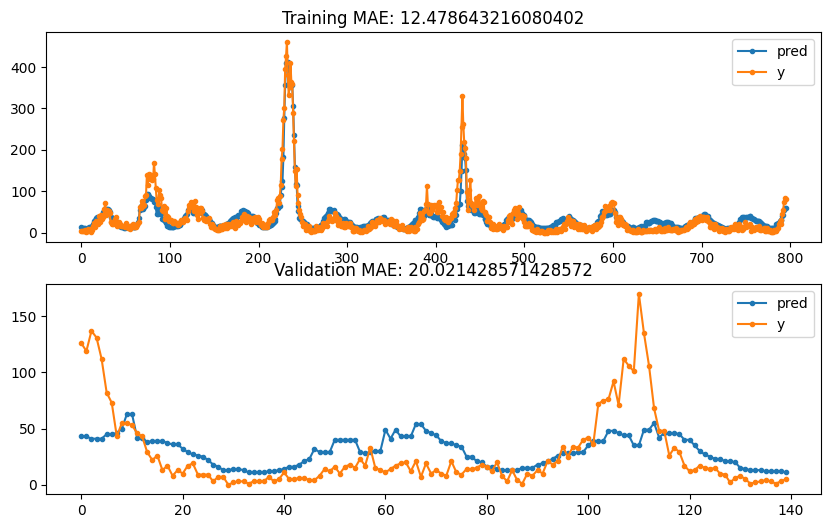

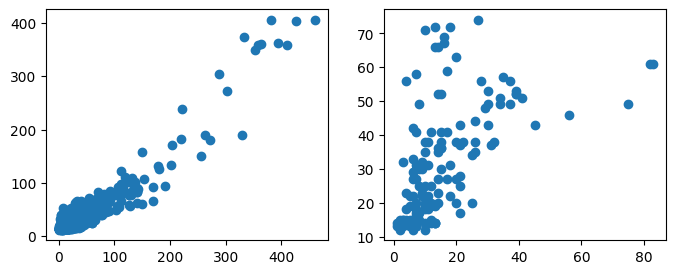

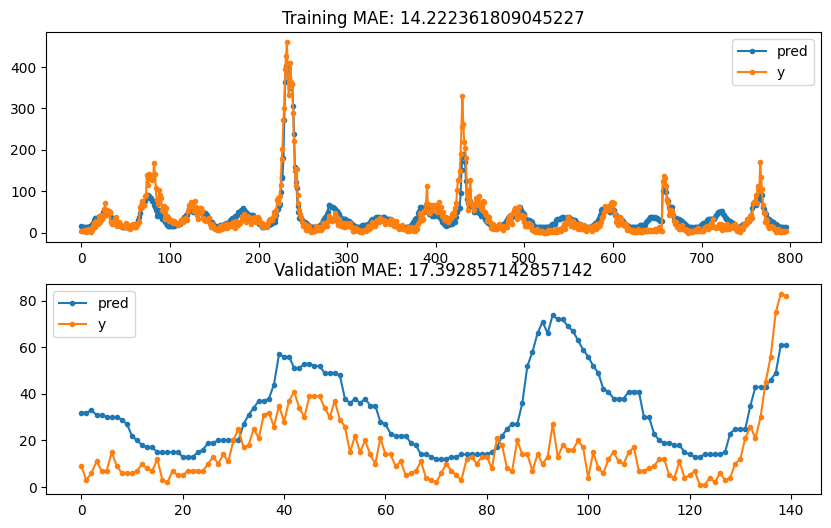

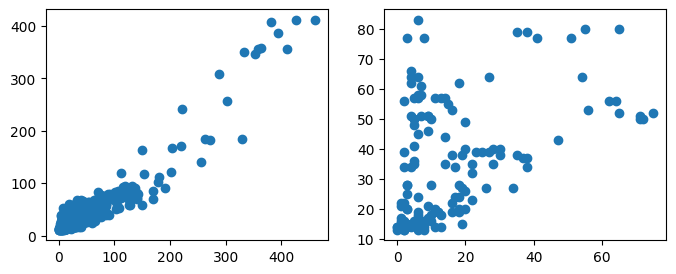

...

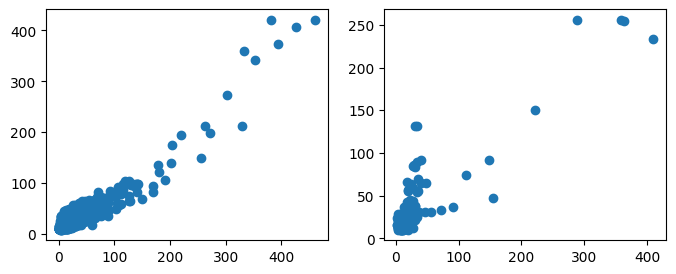

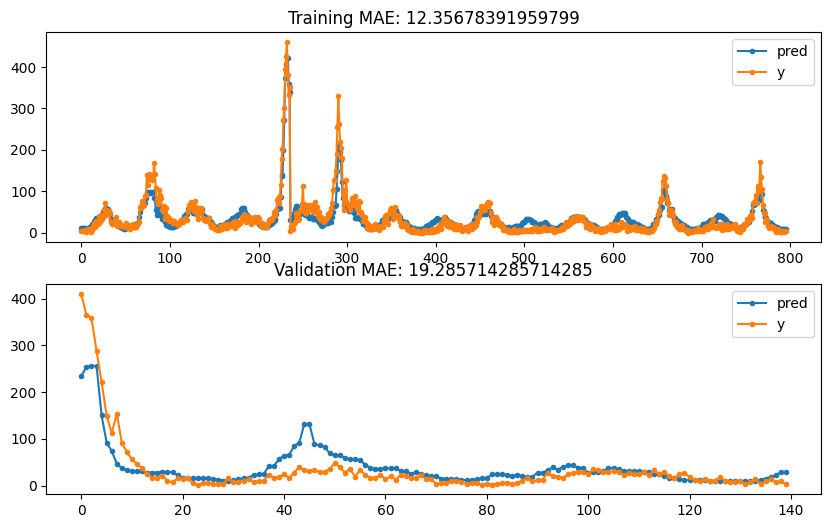

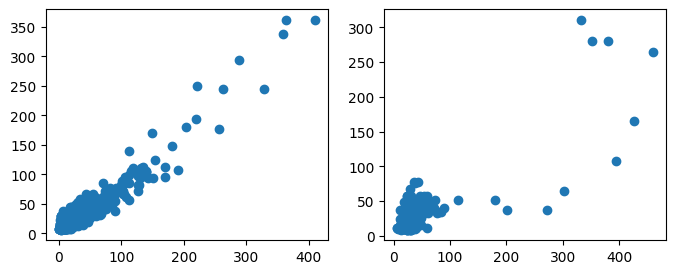

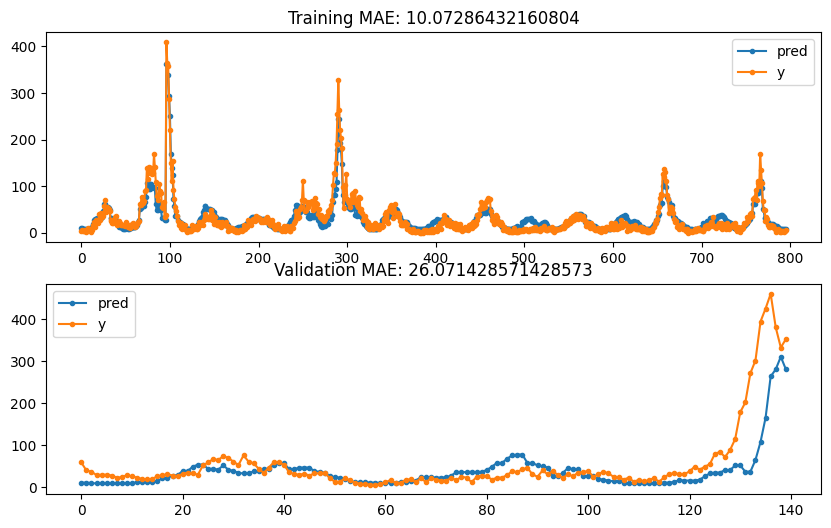

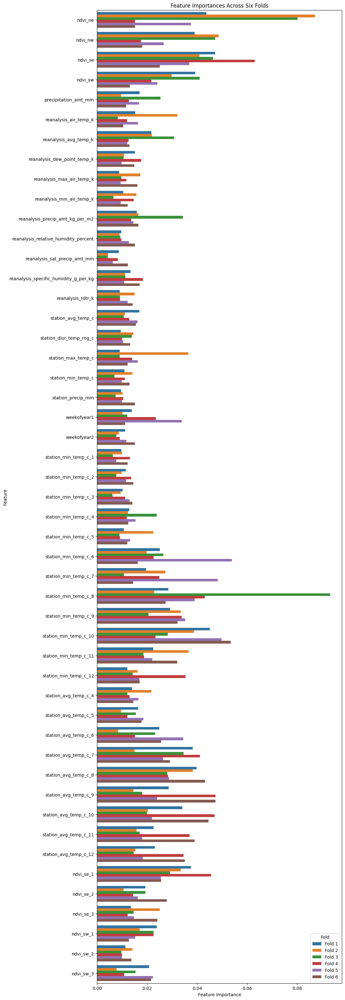

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


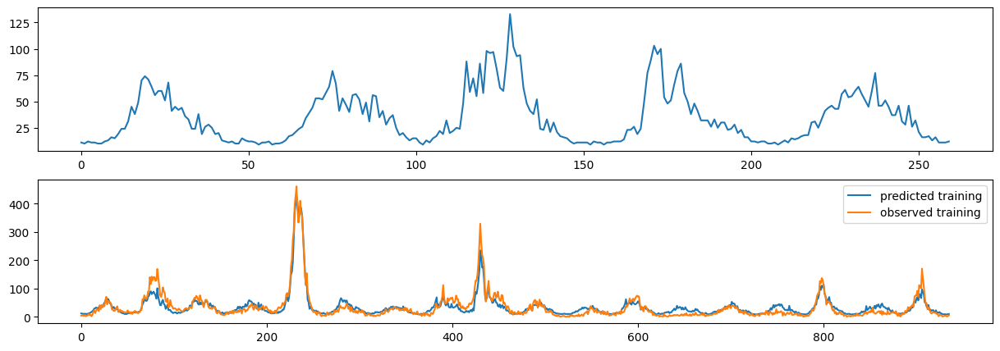

In [34]:
# Specify modelling parameters
label_lags=None
# feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = [col for col in feature_names if col !='weekofyear']
# lagged_features = ['station_min_temp_c','station_avg_temp_c','reanalysis_specific_humidity_g_per_kg',
#                    'reanalysis_dew_point_temp_k','ndvi_se']
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                 #    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                 #    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 10

# model_sj = create_XGBmodel(eta=0.024,n_estimators=272,max_depth=5,
#                                      objective='reg:squarederror',
#                                      min_child_weight = 1, subsample=0.7,
#                                      gamma=281.2,colsample_bytree = 0.9,
#                                      reg_alpha=0.0925,reg_lambda=8.36)

model_sj = create_XGBmodel(eta=0.05,n_estimators=700,max_depth=4,
                                     objective='count:poisson',
                                     min_child_weight = 10, subsample=0.8,
                                     gamma=10,colsample_bytree = 0.9,
                                     reg_alpha=100,reg_lambda=50)

modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=False, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []
sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
# sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### Parametric xgboost trial

In [ ]:
def run_xgboost_trial_sj(params,lagged_features):    
    # Specify modelling parameters
    label_lags=None
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]

    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = None, feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)

    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)

    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                            sj_labels, iq_labels,
                                                            folds=6, fold_size=fold_size)

    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
            feature_weights[-len(label_lags):] = 10

    scores=[]
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(**params))
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        _, _,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold],y_train_sj[fold],
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        scores.append((train_mae_sj[0].item(), val_mae_sj[0].item()))

    scores = pd.DataFrame(scores,columns=['train_mae','val_mae'])
    scores = scores.reset_index()
    scores.rename(columns={'index':'fold'},inplace=True)
    df = pd.concat([pd.DataFrame([params]*6),scores],axis=1)

    return df

In [ ]:
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}

params_to_try = {'max_depth': [4,8],
                 'eta': [0.01, 0.1],
                 'n_estimators': [300,500],
                 'subsample': [0.6, 0.8],
                 'colsample_bytree': [0.6, 0.8],
                 'gamma': [1,10],
                 'reg_alpha': [0.1, 10],
                 'reg_lambda': [0.1, 10],
                 'min_child_weight': [1,5]}

# params_to_try = {'max_depth': [4,6,8],
#                  'eta': [0.01, 0.05, 0.1],
#                  'n_estimators': [200,300,500],
#                  'subsample': [0.6, 0.8, 0.9],
#                  'colsample_bytree': [0.6, 0.8, 0.9],
#                  'gamma': [1,10,100],
#                  'reg_alpha': [0.1, 5, 10],
#                  'reg_lambda': [0.1, 5, 10],
#                  'min_child_weight': [1,5,20]}

# Get all combinations of parameters
param_combinations = list(itertools.product(*params_to_try.values()))
n_combos = len(param_combinations)

df_scores_all = []

# Iterate over each combination
for i, param_combo in enumerate(param_combinations):
    params = dict(zip(params_to_try.keys(), param_combo))
    print(f'\n\nRunning {i} of {n_combos}: {params}')
    df_scores = run_xgboost_trial_sj(params,lagged_features)
    df_scores['trial'] = i
    df_scores_all.append(df_scores)



Running 0 of 512: {'max_depth': 4, 'eta': 0.01, 'n_estimators': 300, 'subsample': 0.6, 'colsample_bytree': 0.6, 'gamma': 1, 'reg_alpha': 0.1, 'reg_lambda': 0.1, 'min_child_weight': 1}

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                    

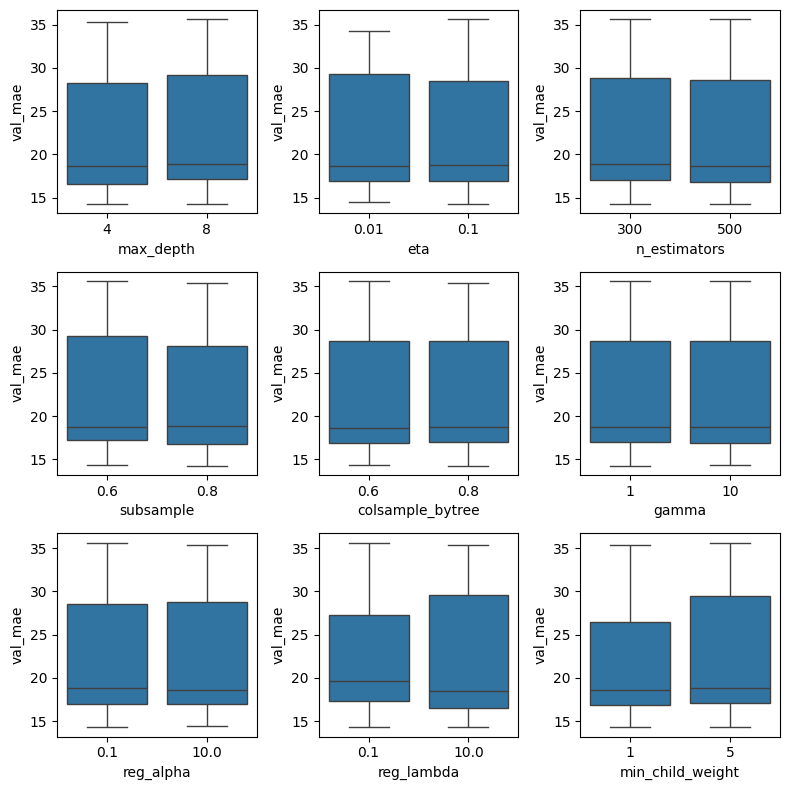

In [ ]:
all_params = ['max_depth', 'eta', 'n_estimators', 'subsample', 'colsample_bytree',
              'gamma', 'reg_alpha', 'reg_lambda', 'min_child_weight']
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(all_params):
    sns.boxplot(df, x=param, y='val_mae', ax=axs[i])
fig.tight_layout()

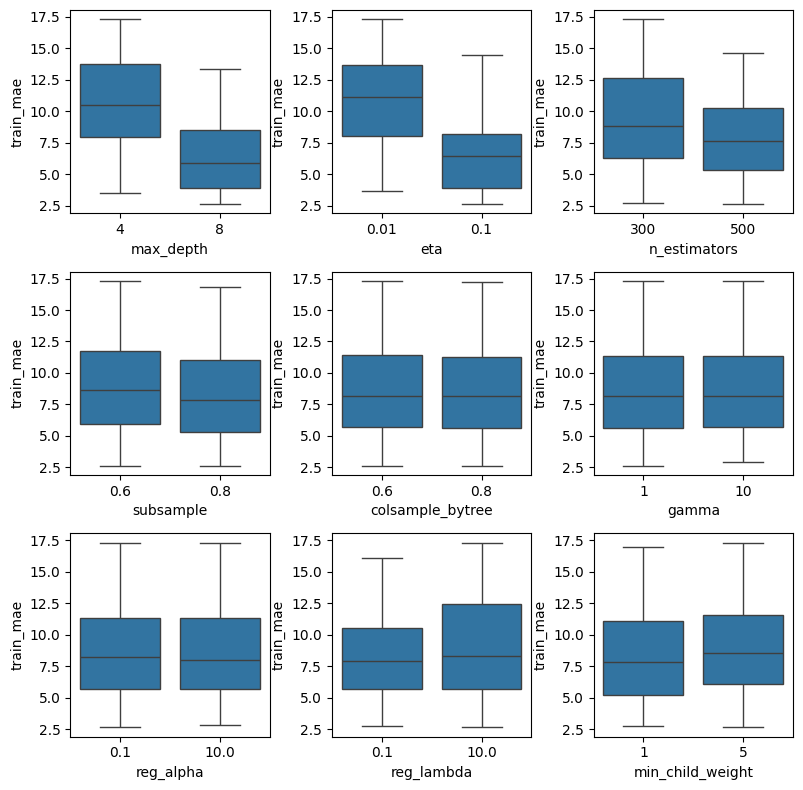

In [ ]:
all_params = ['max_depth', 'eta', 'n_estimators', 'subsample', 'colsample_bytree',
              'gamma', 'reg_alpha', 'reg_lambda', 'min_child_weight']
fig, axs = plt.subplots(3,3,figsize=(8,8))
axs = axs.flatten()

for i, param in enumerate(all_params):
    sns.boxplot(df, x=param, y='train_mae', ax=axs[i])
fig.tight_layout()

## Submission

### template

In [ ]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 10

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 20, subsample=0.7,
                                     gamma=10000,colsample_bytree = 0.6,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []
sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

### Sub 24 - Trying Poisson count

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


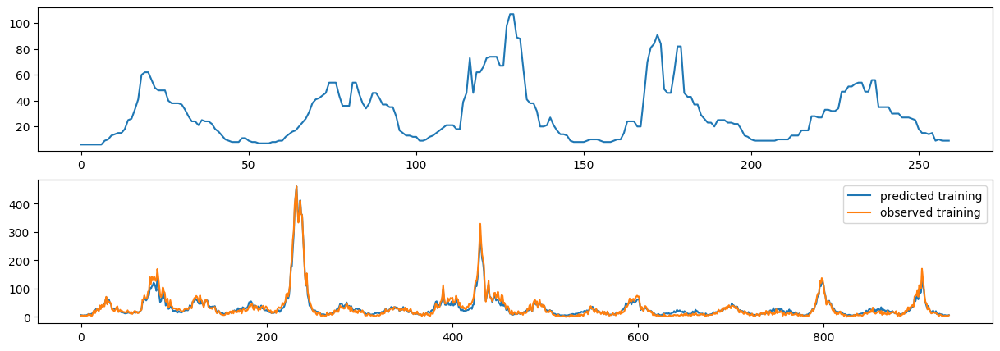

In [22]:
# Specify modelling parameters
label_lags=None
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10
else:
    lagged_label_names = []

model_sj = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='count:poisson',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


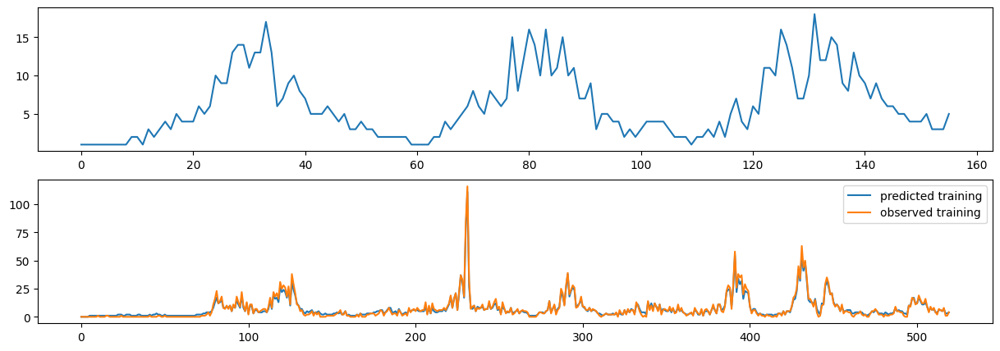

In [28]:
# Specify modelling parameters
label_lags=None
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq,= prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10
else:
    lagged_label_names = []

model_iq = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='count:poisson',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_iq, X_train_iq, y_train_iq,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
# iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

In [42]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
submission.to_csv("./submission_24.csv")

### Sub 25 - reg squarederror no label lags

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


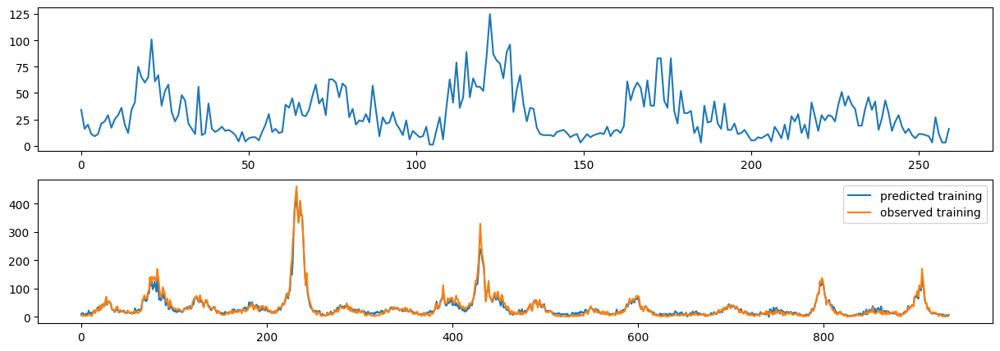

In [38]:
# Specify modelling parameters
label_lags=(3,4)
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 0.3
else:
    lagged_label_names = []

model_sj = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
# sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


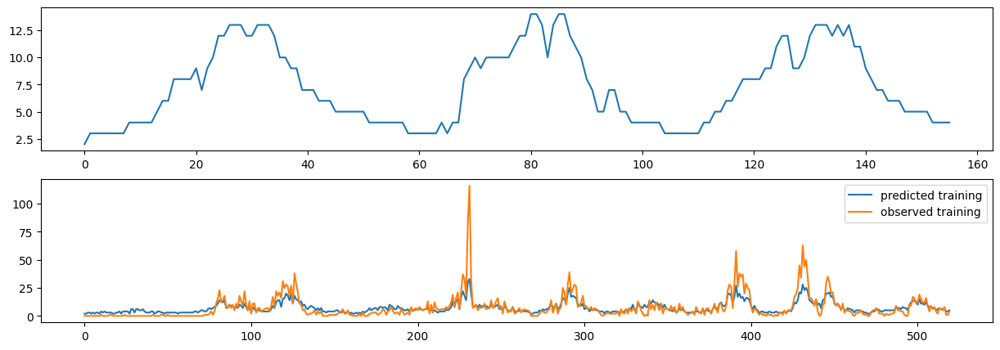

In [31]:
# Specify modelling parameters
label_lags=(3,4)
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq,= prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 0.3
else:
    lagged_label_names = []

model_iq = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_iq, X_train_iq, y_train_iq,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

In [32]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
submission.to_csv("./submission_25.csv")

### Sub 26 - using lags, but reducing effect of other features through regularization


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

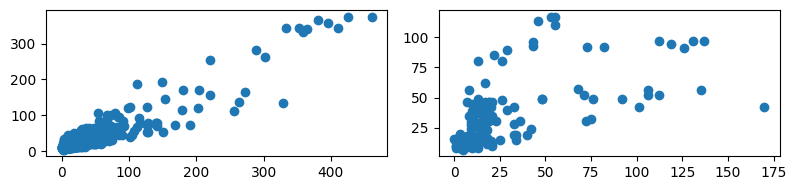

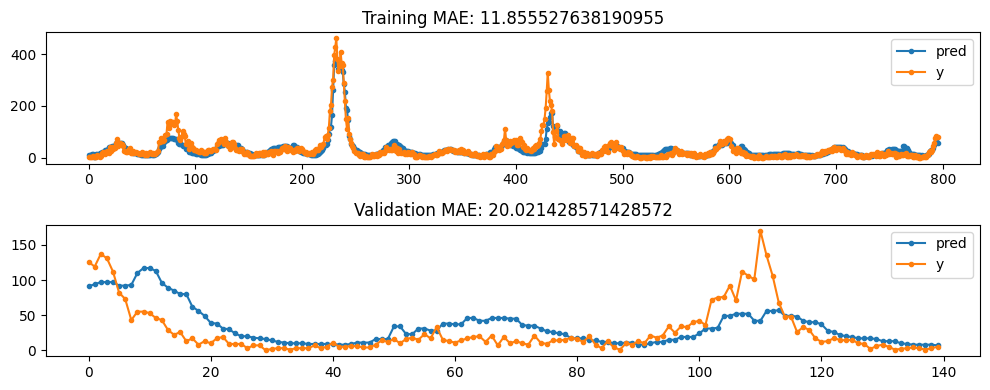

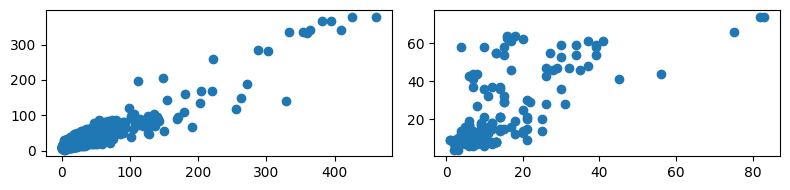

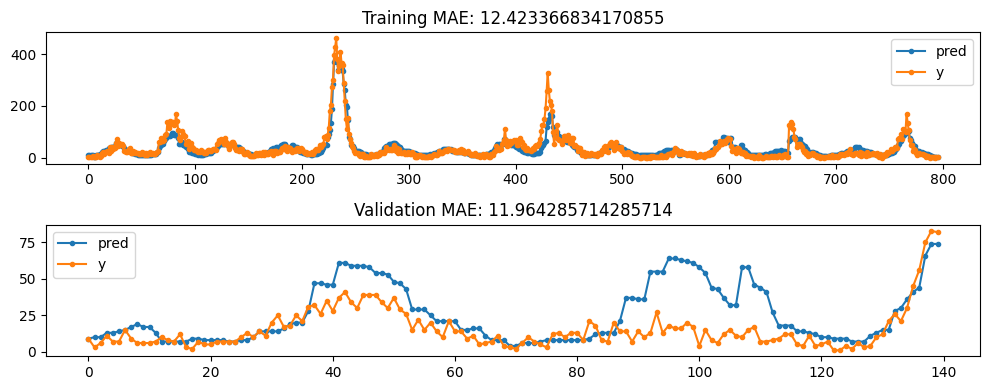

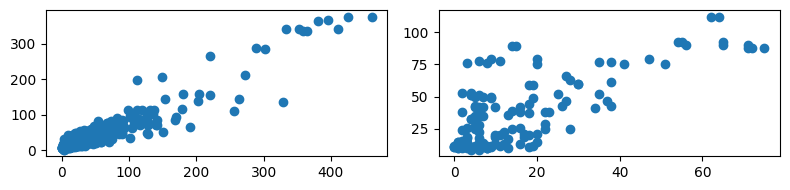

...

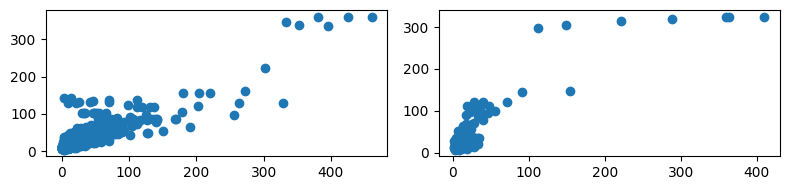

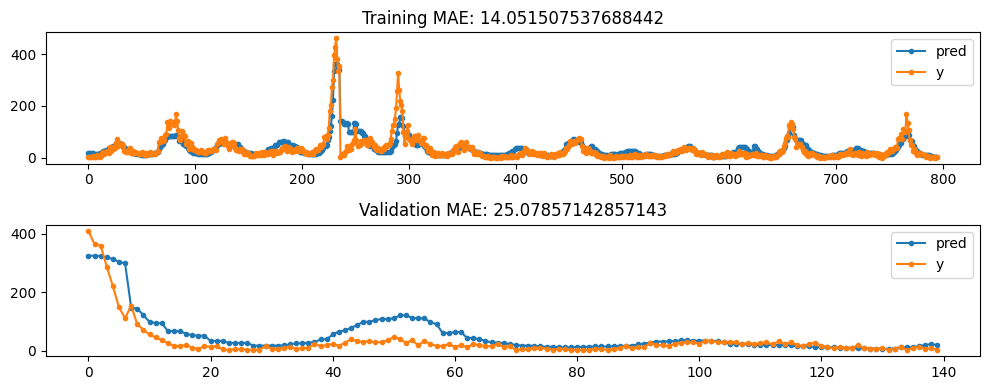

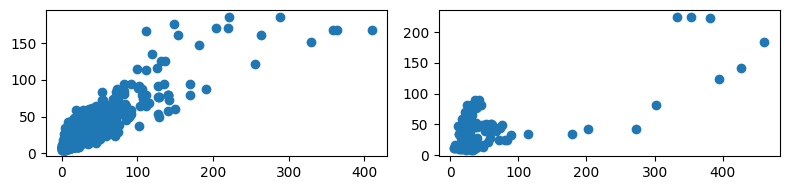

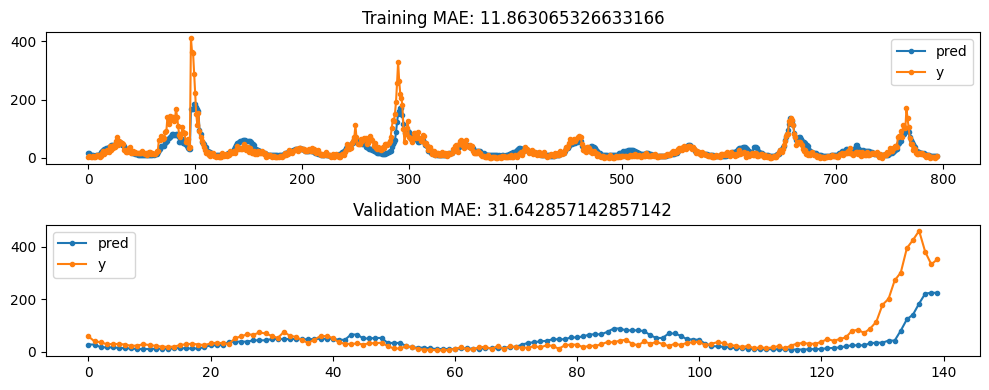

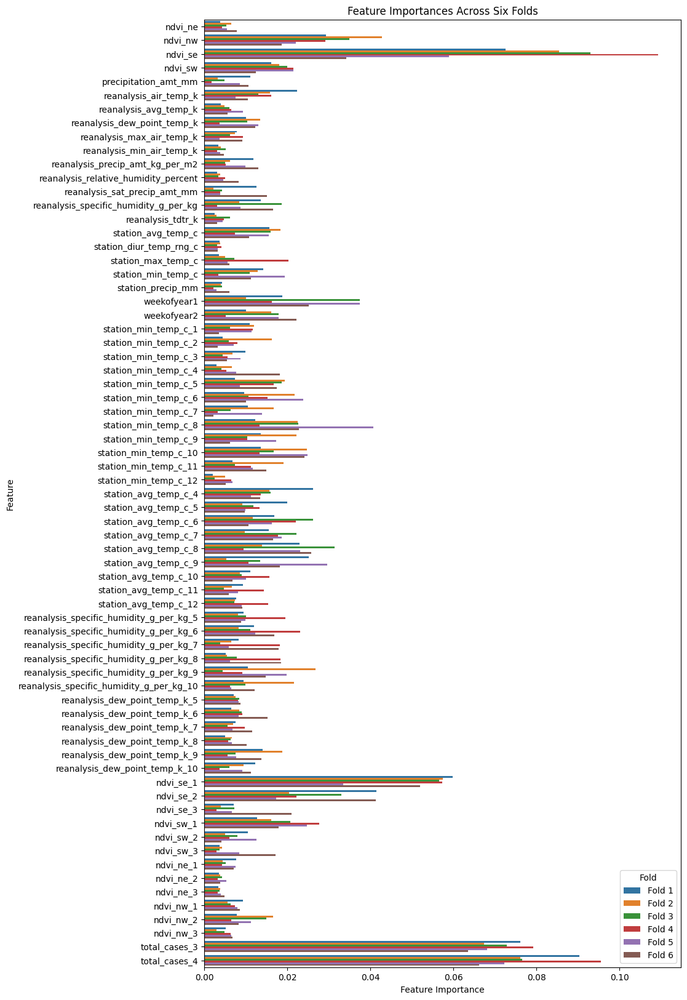

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


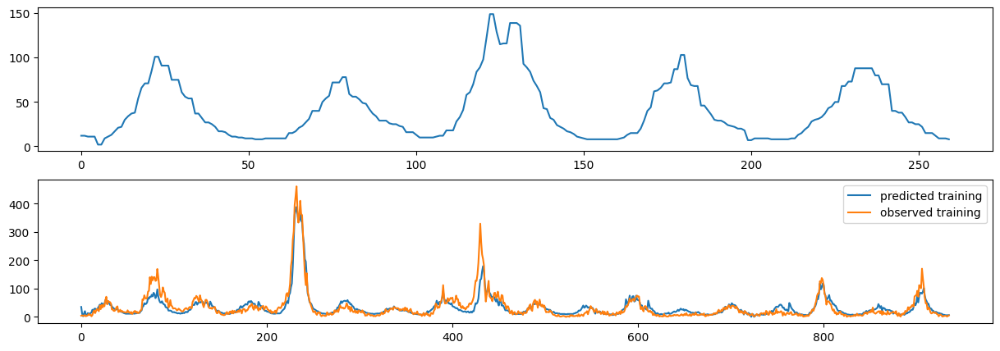

In [39]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

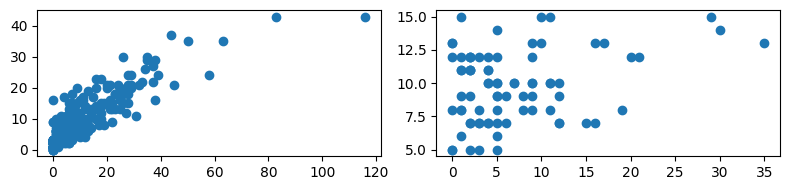

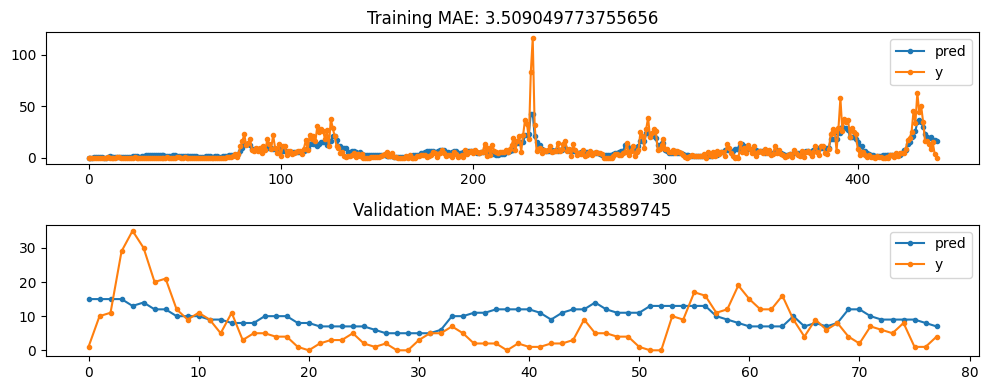

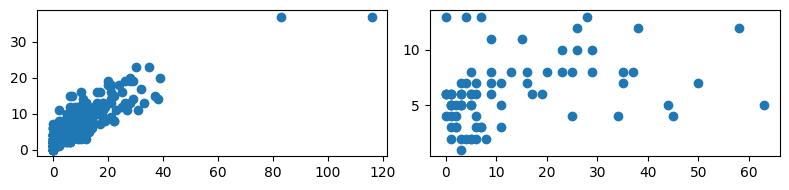

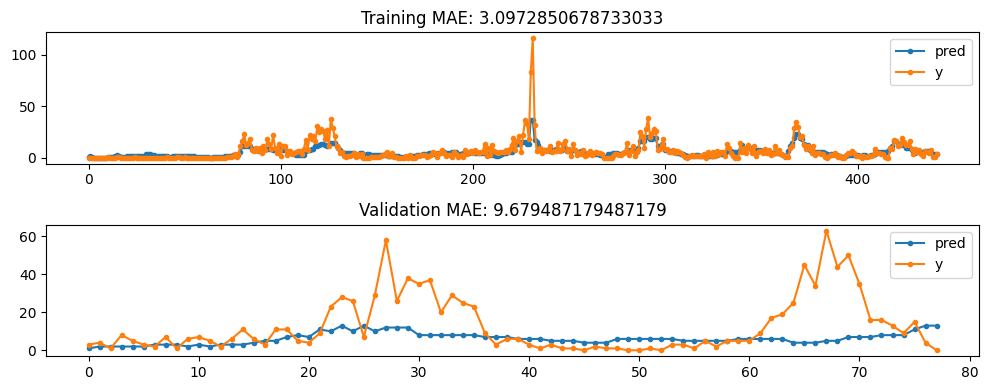

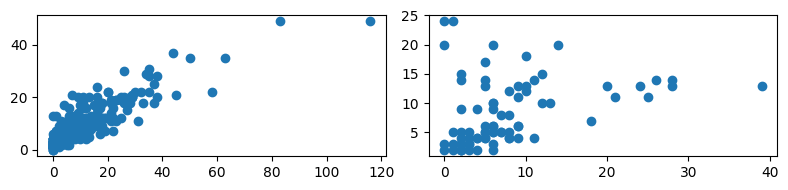

...

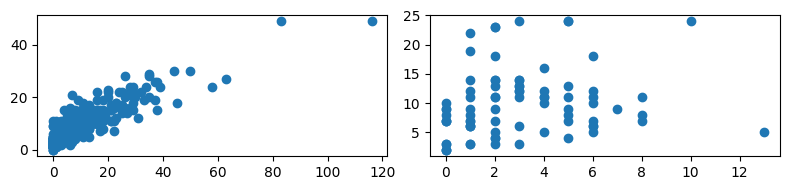

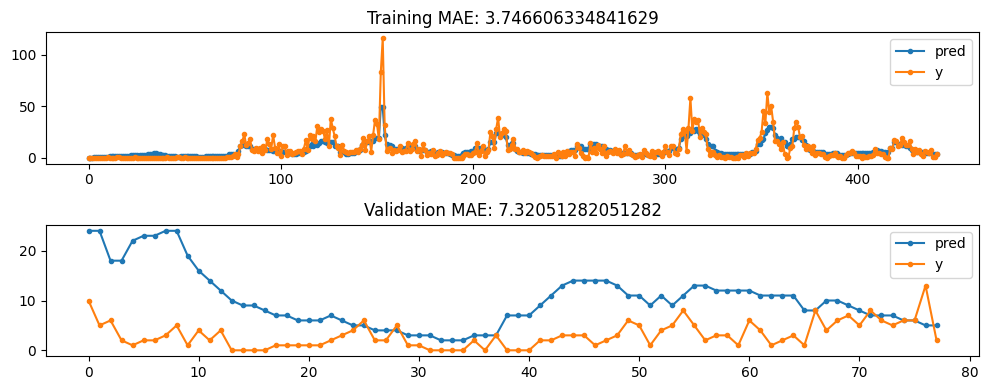

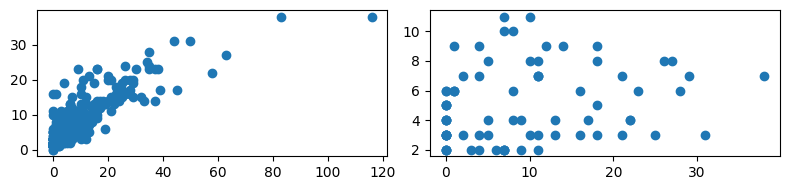

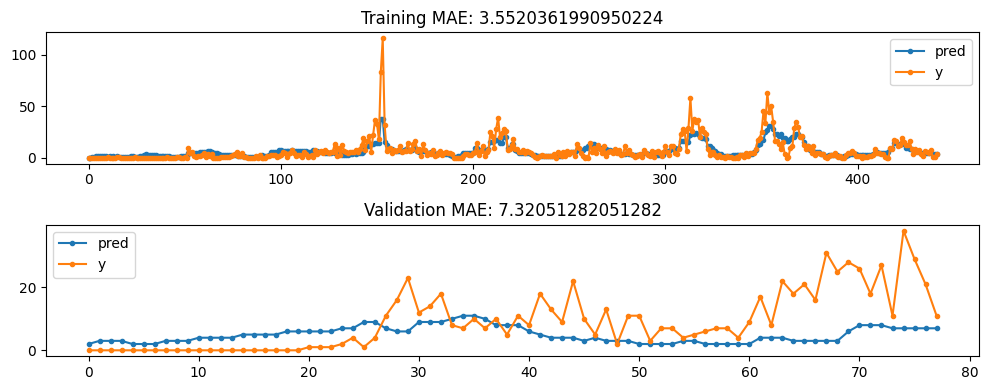

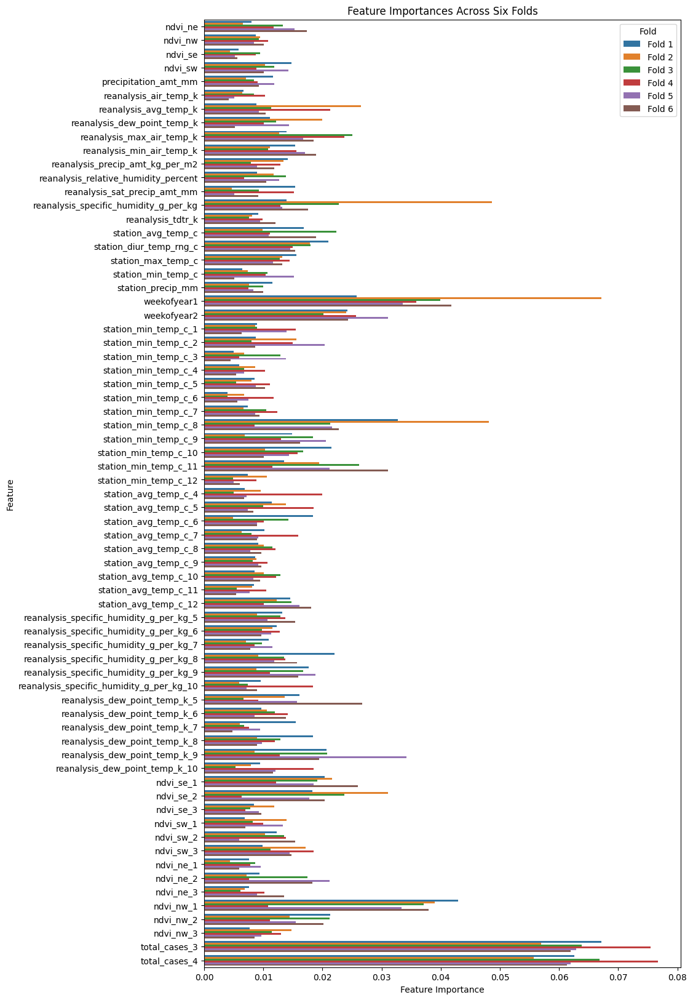

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


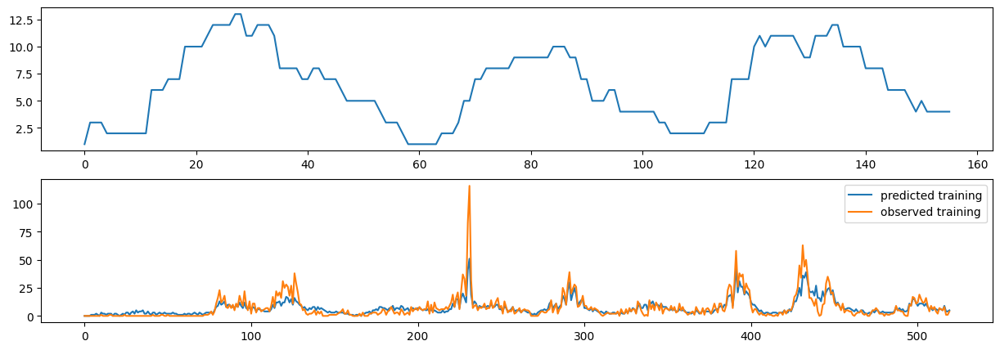

In [40]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

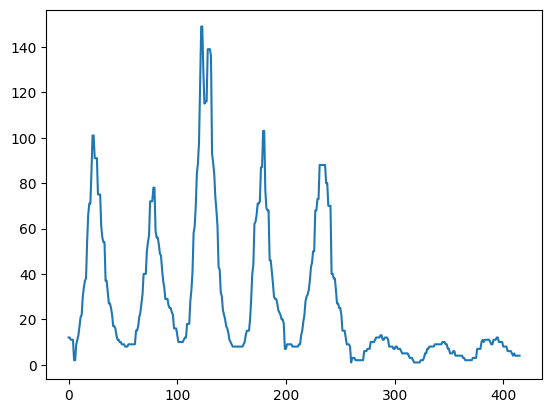

In [41]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_26.csv")

### sub 27- ???


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

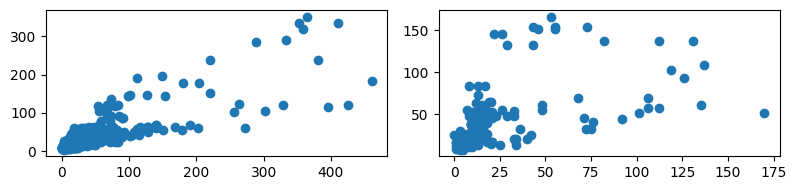

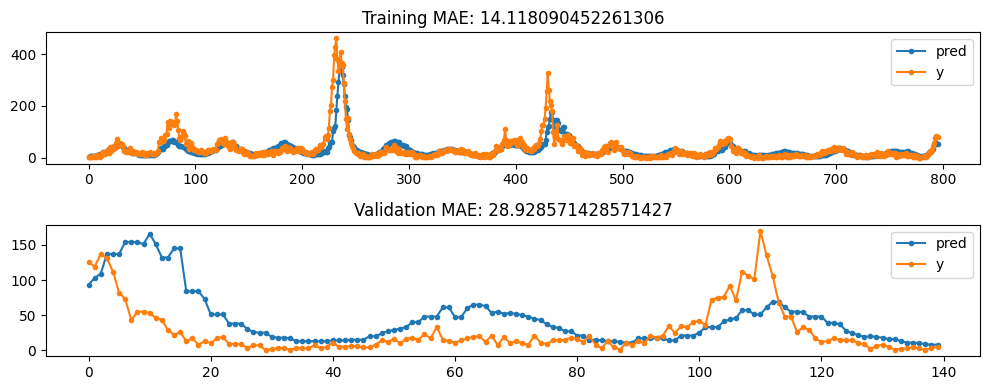

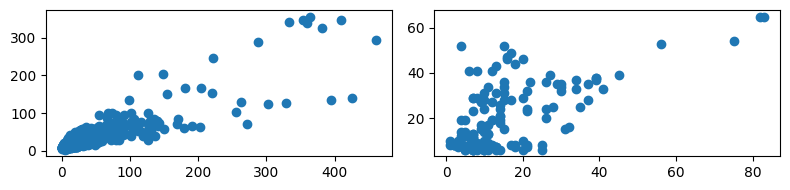

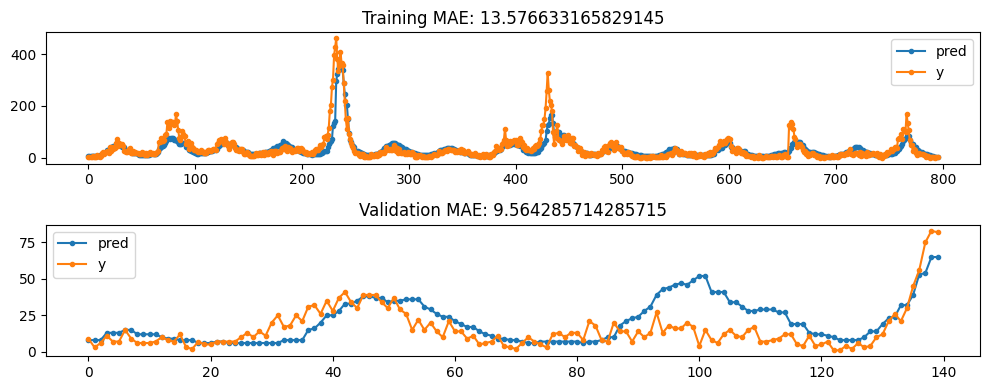

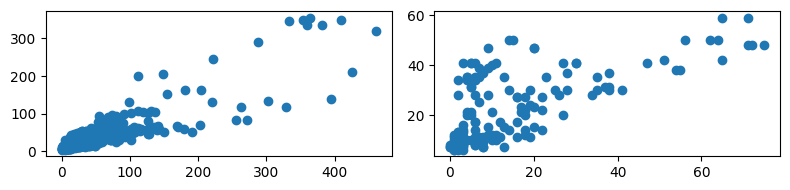

...

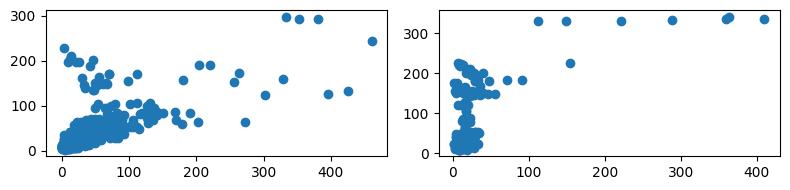

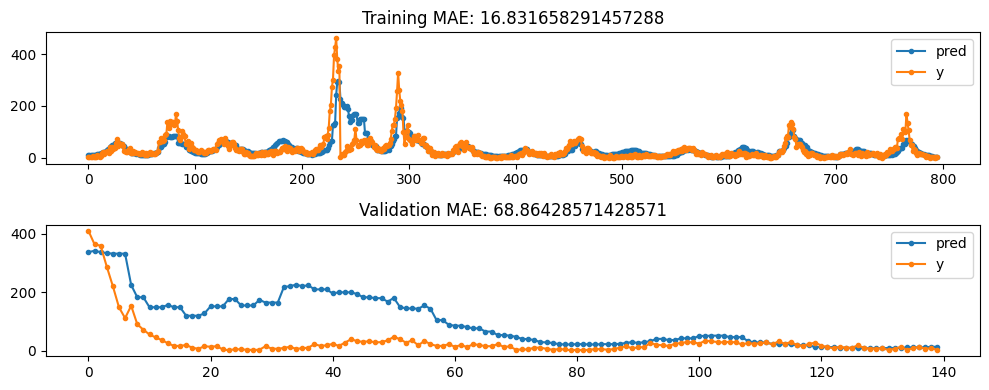

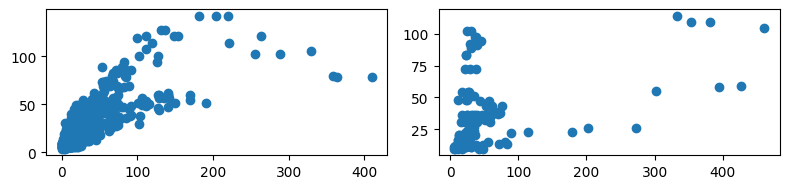

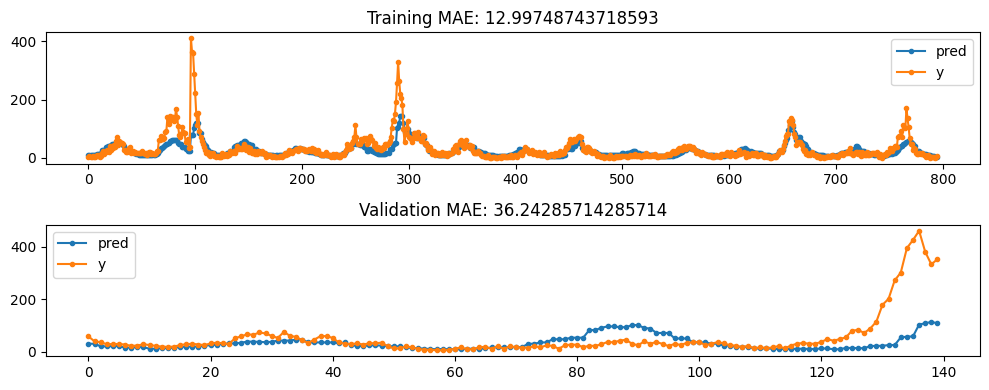

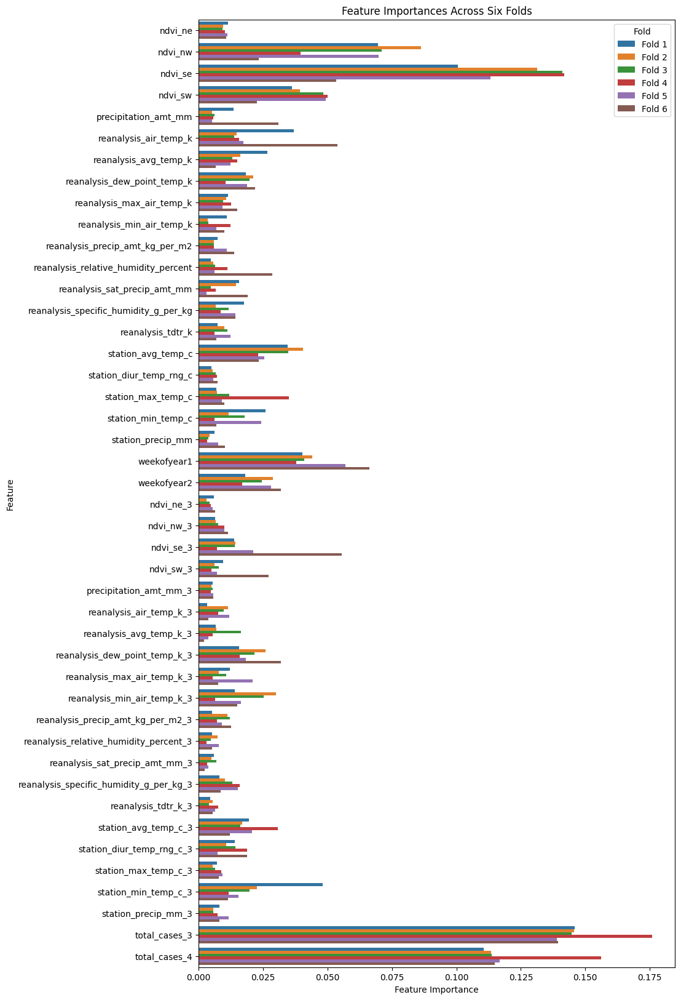

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


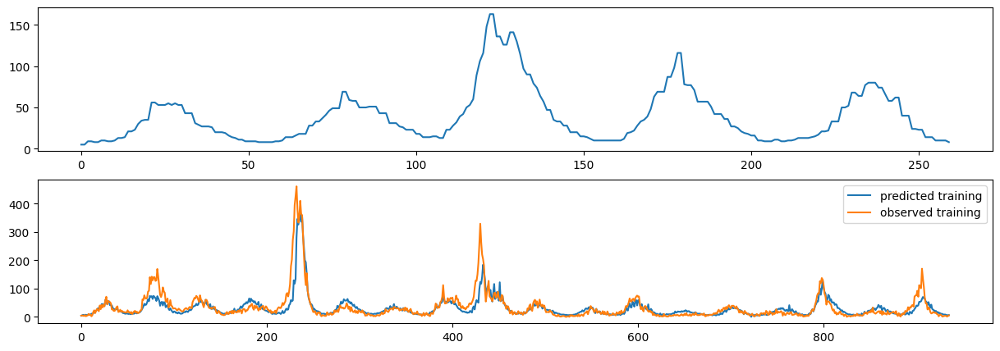

In [44]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

feature_lags = (3,)
lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 30

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

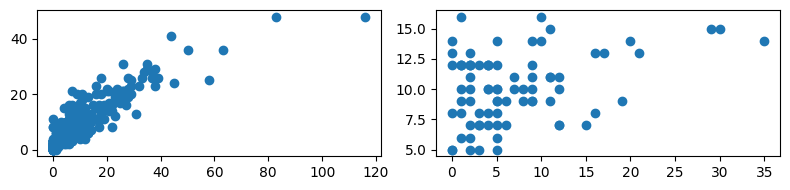

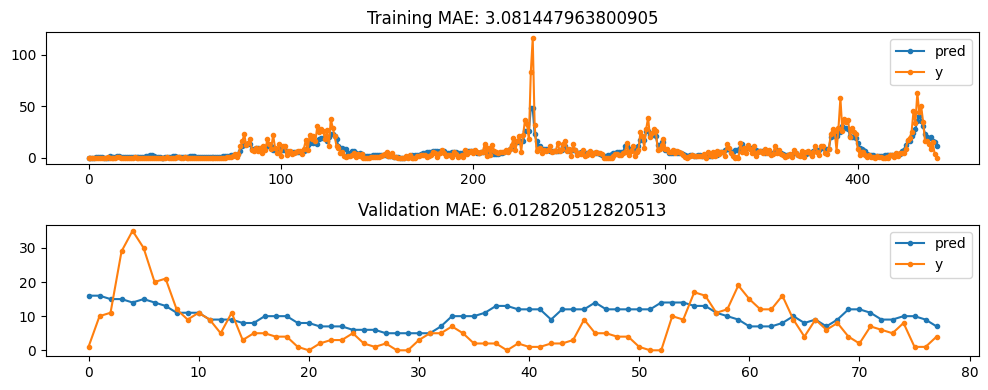

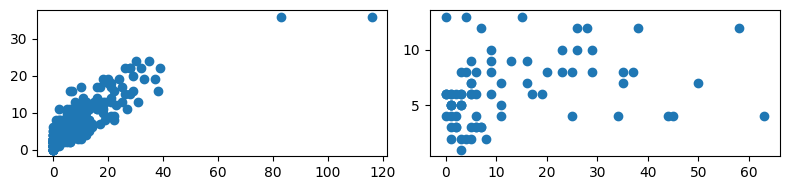

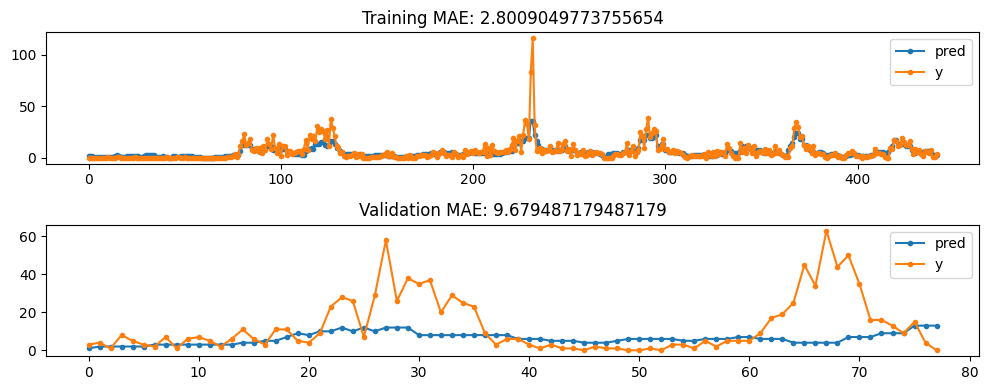

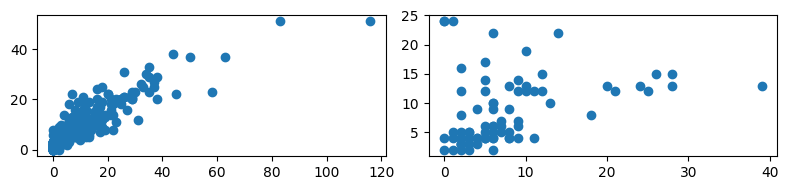

...

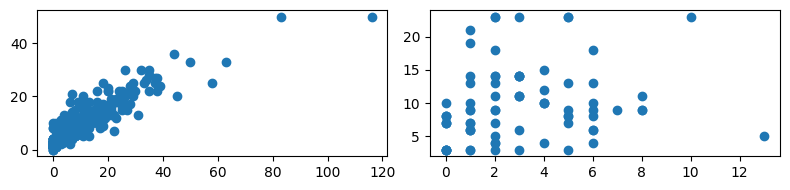

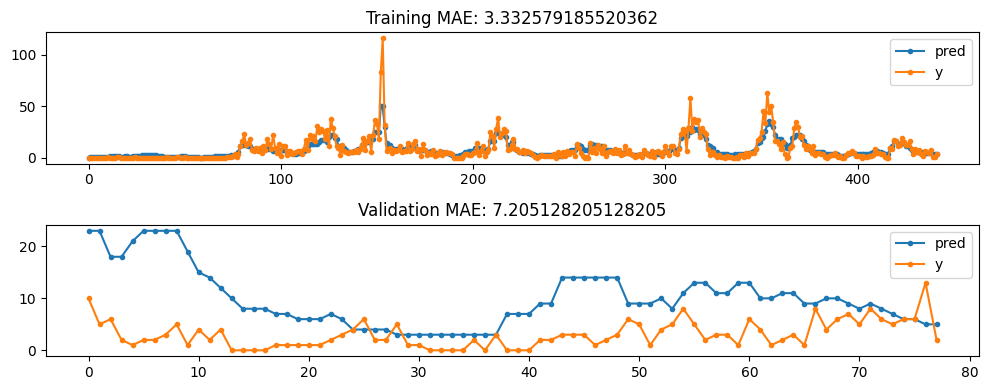

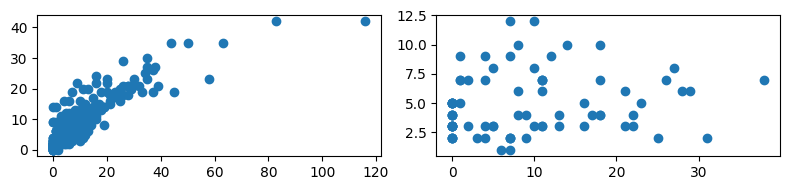

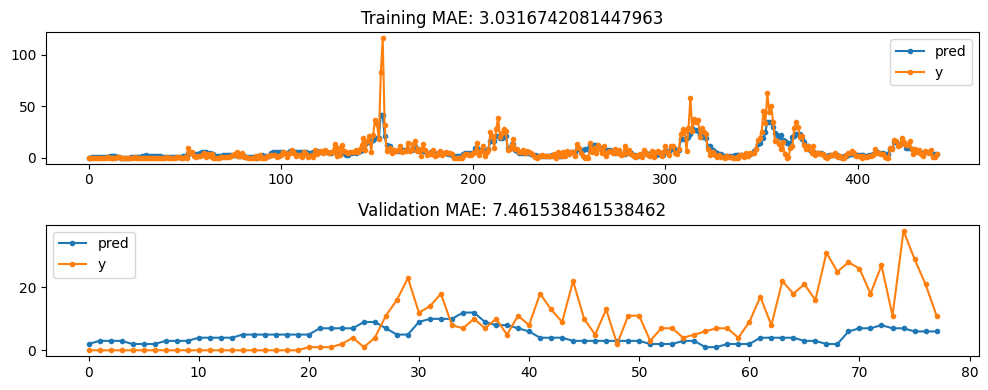

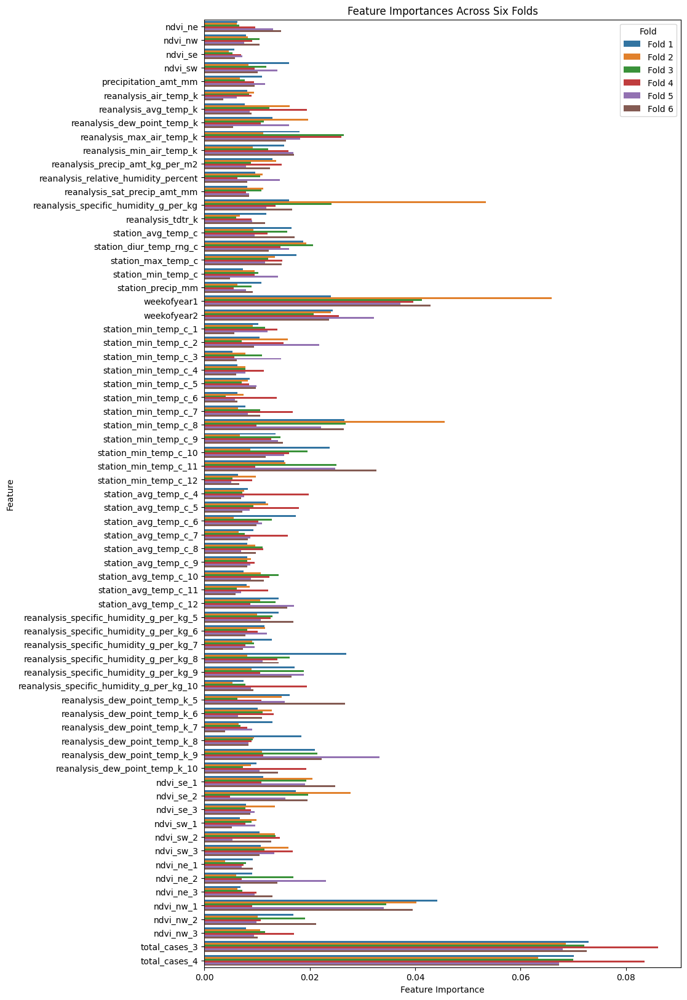

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


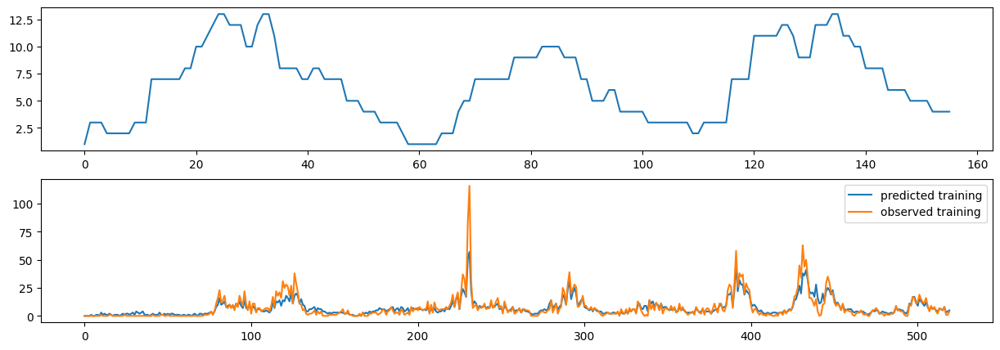

In [42]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

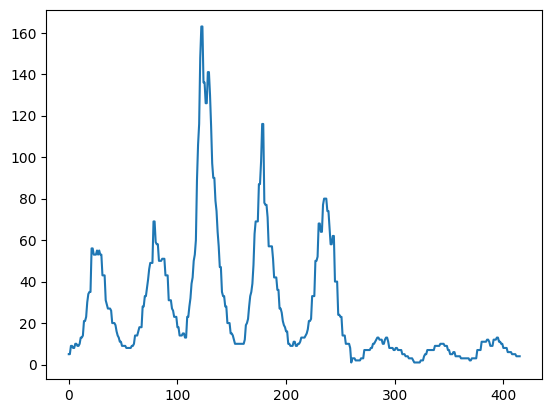

In [45]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_27.csv")

### Sub 28 - back to best case for a bit to regroup


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

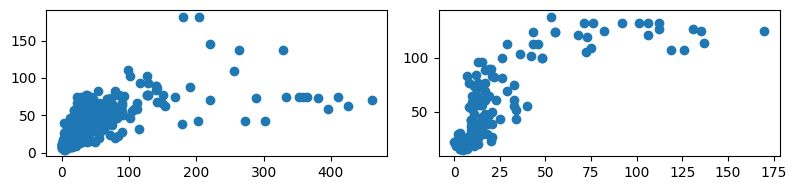

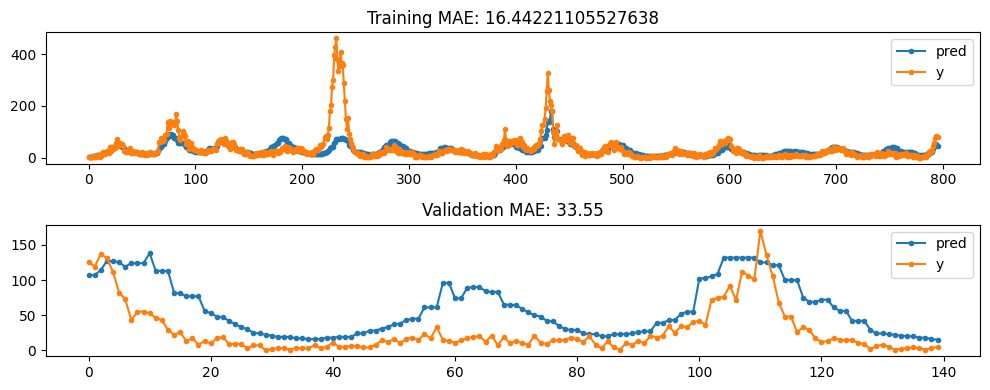

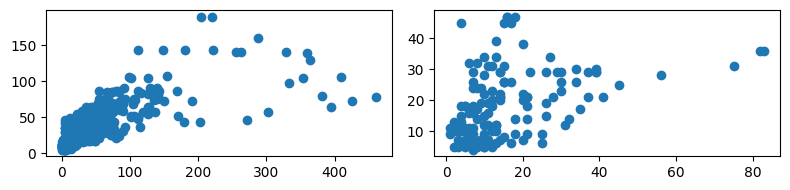

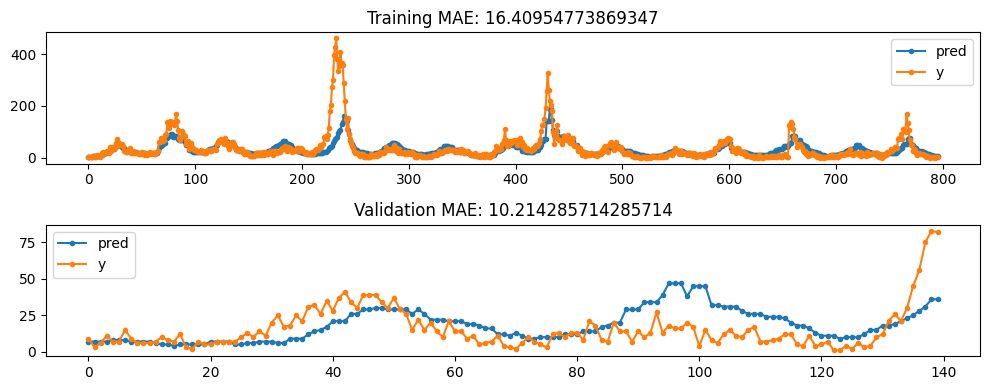

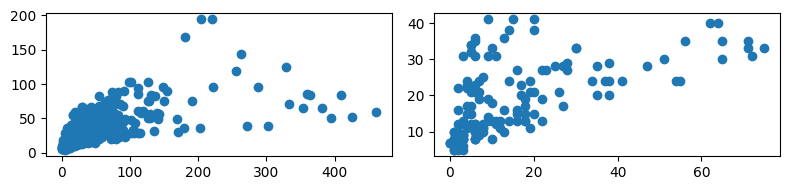

...

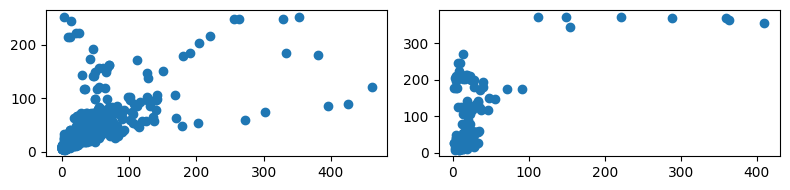

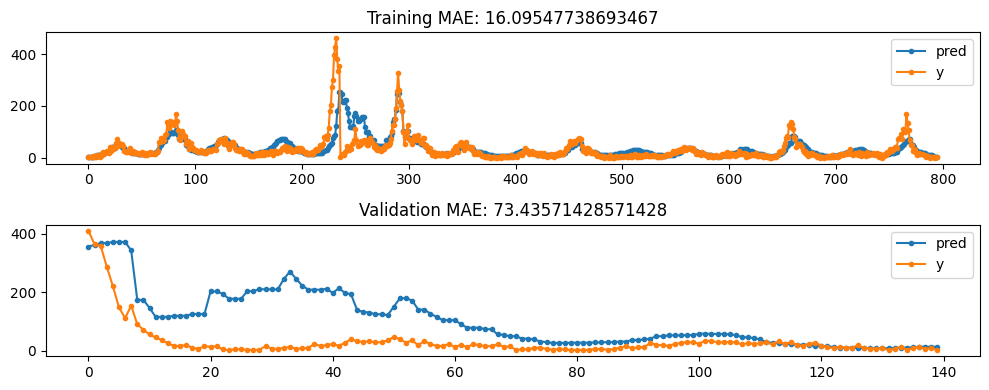

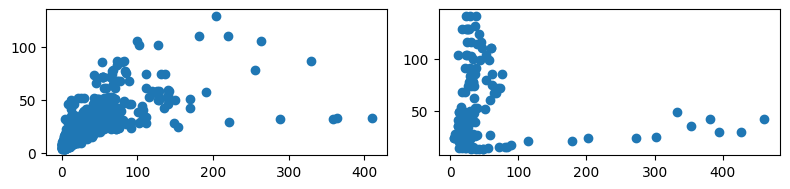

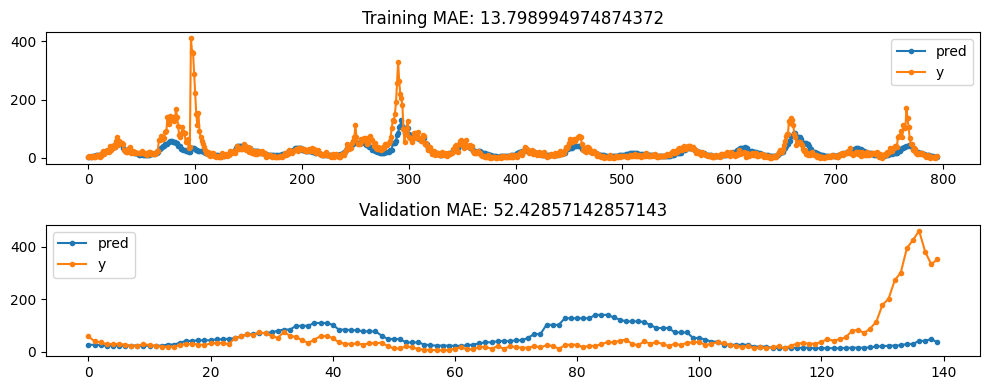

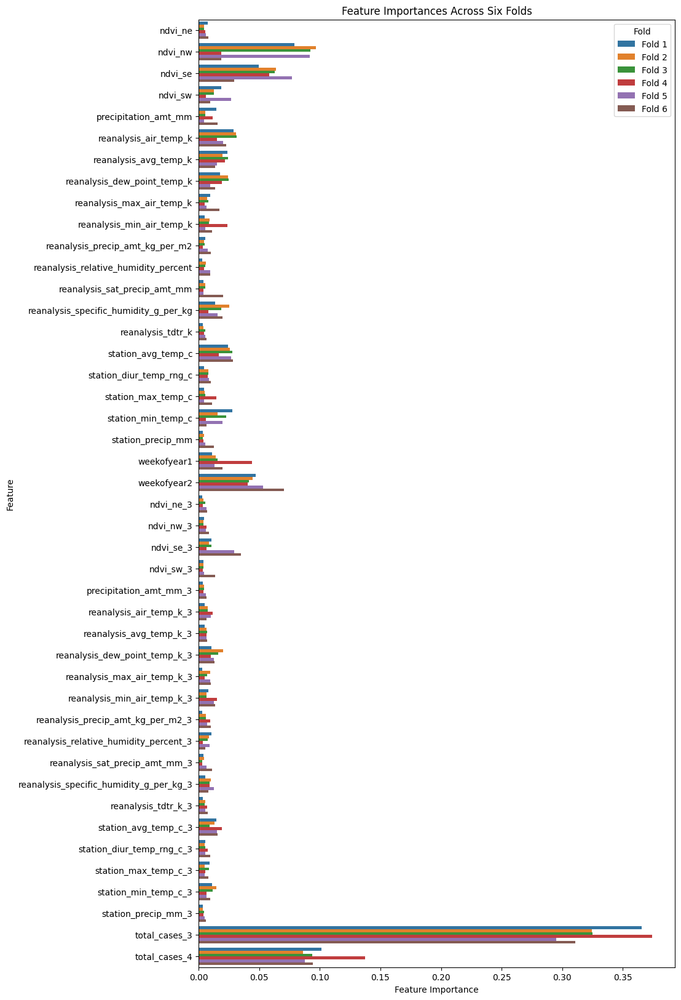

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


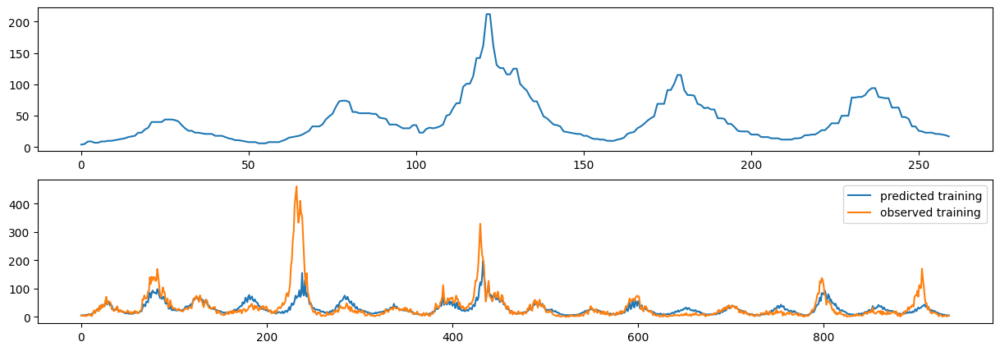

In [52]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

feature_lags = (3,)
lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

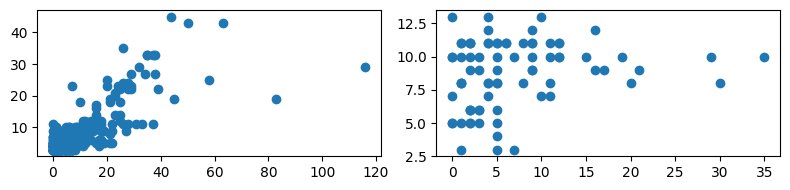

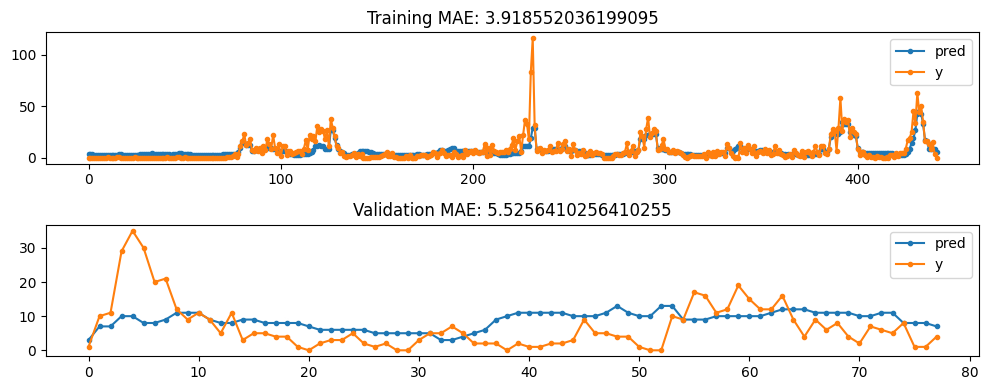

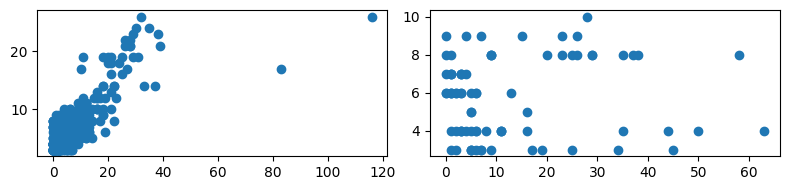

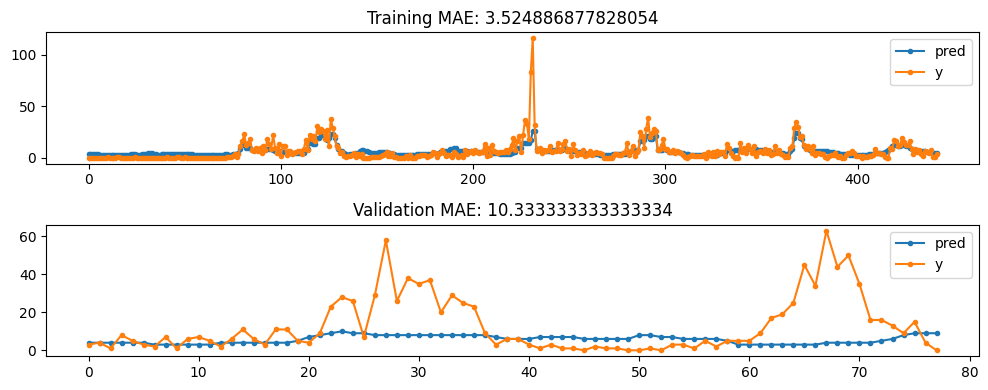

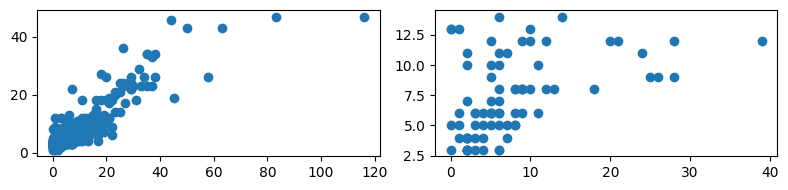

...

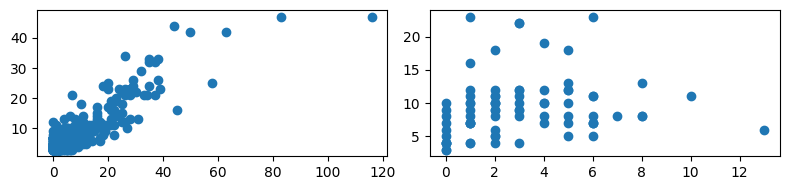

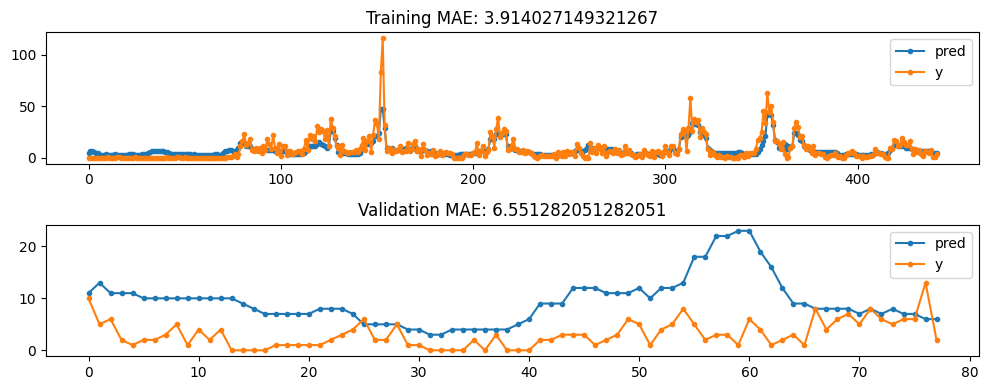

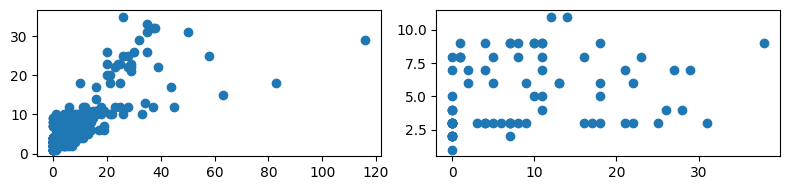

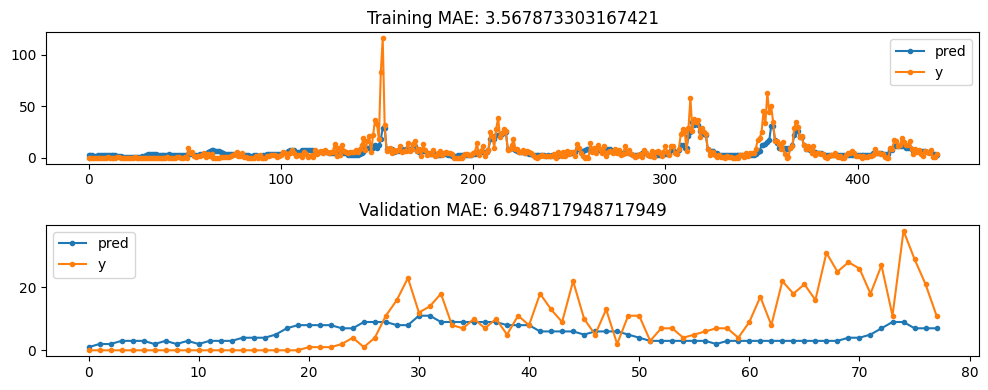

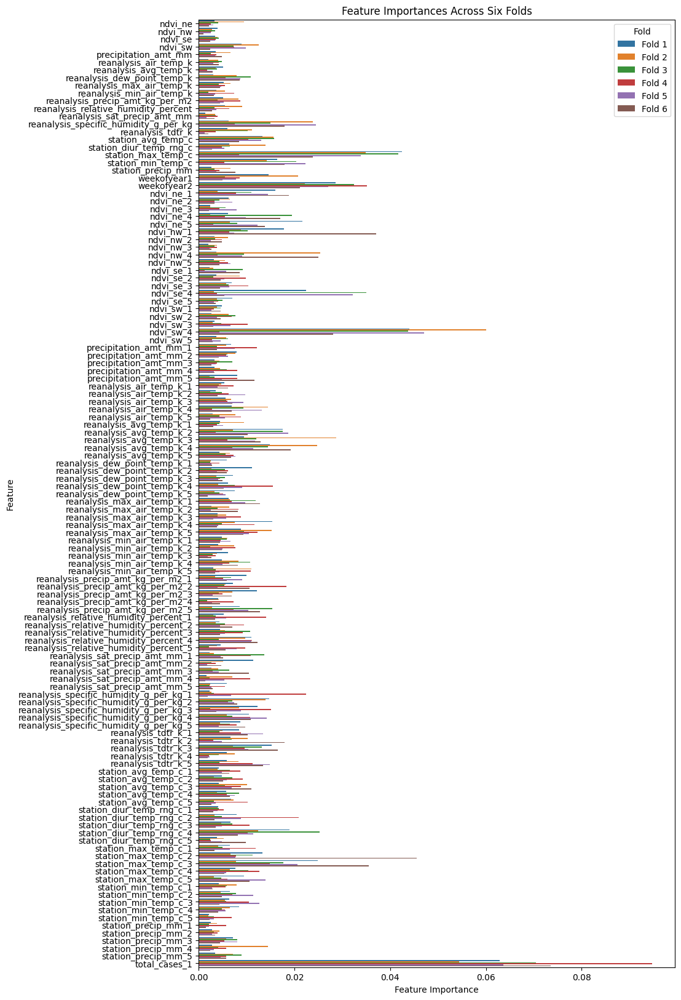

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


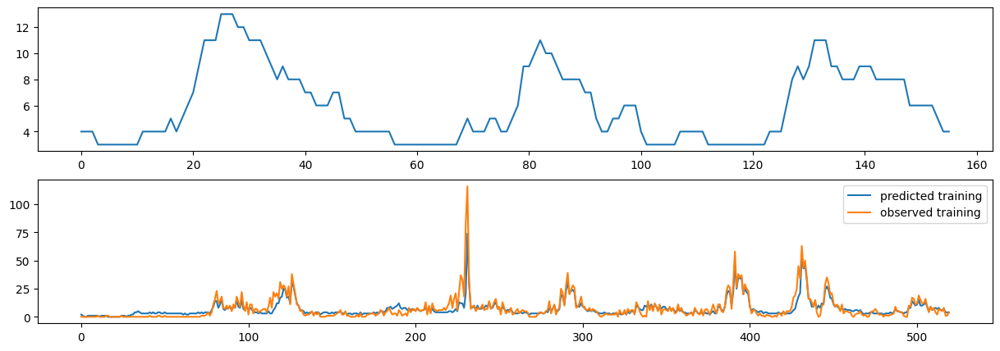

In [53]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(1,)
# label_lags=None

feature_lags = (1,2,3,4,5)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

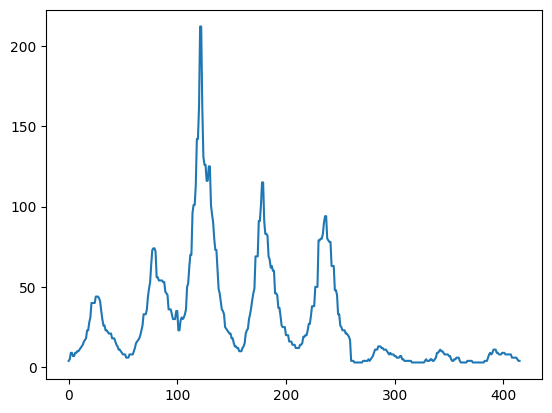

In [54]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_28.csv")

### Sub 29 - closer than sub 28 to best case earlier, for reference

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d599

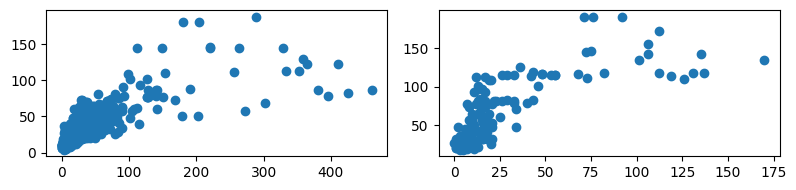

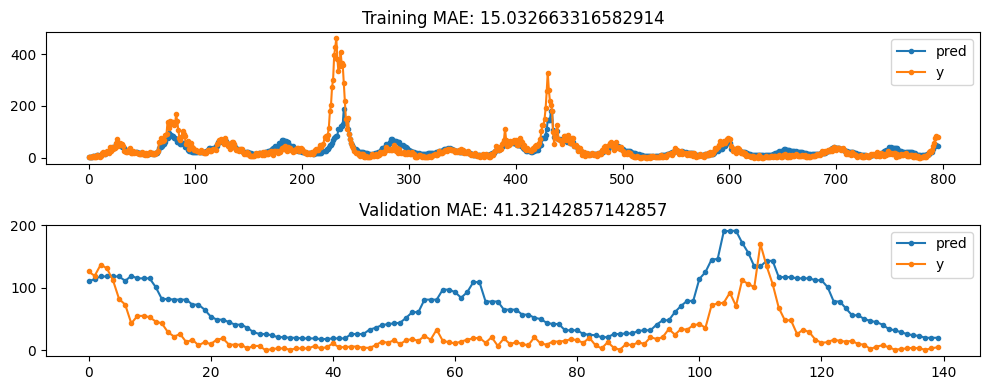

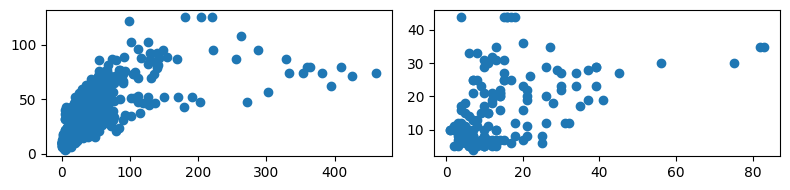

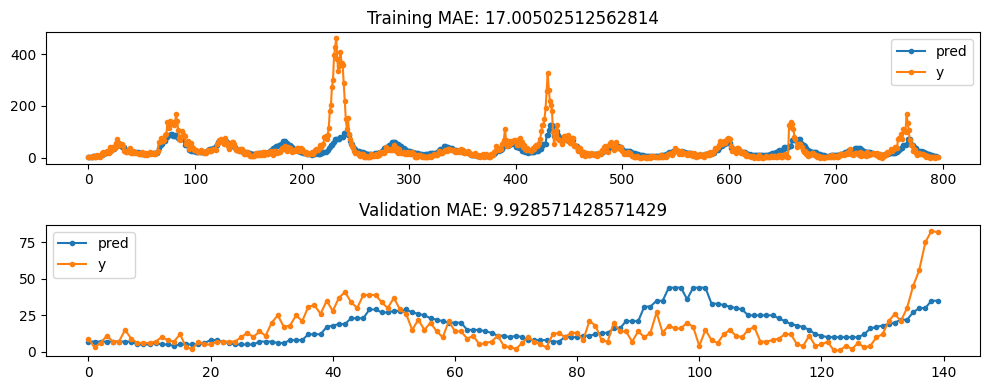

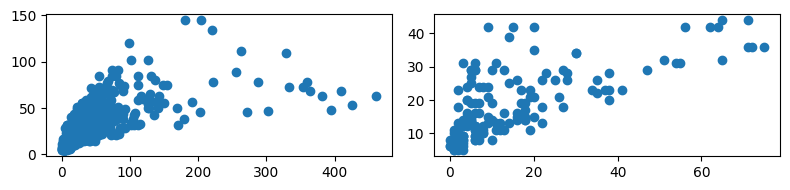

...

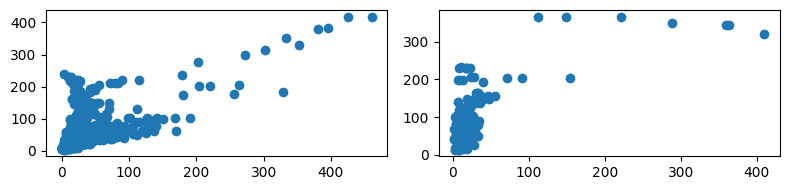

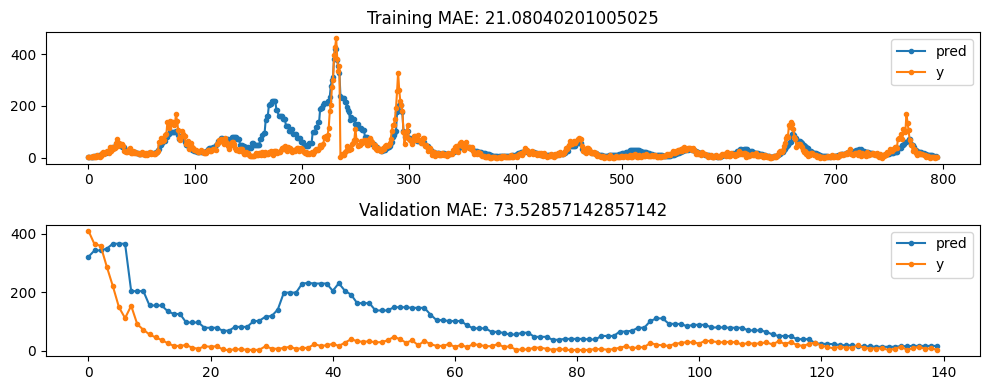

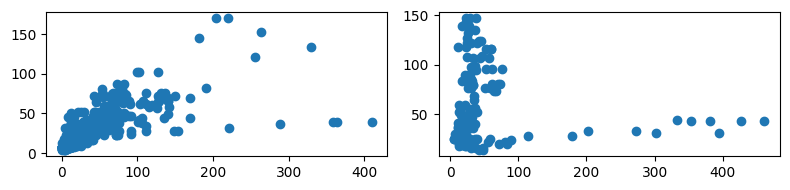

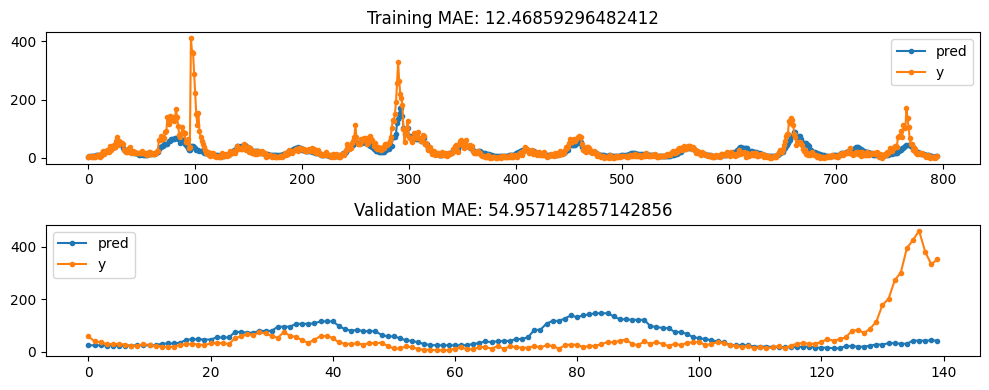

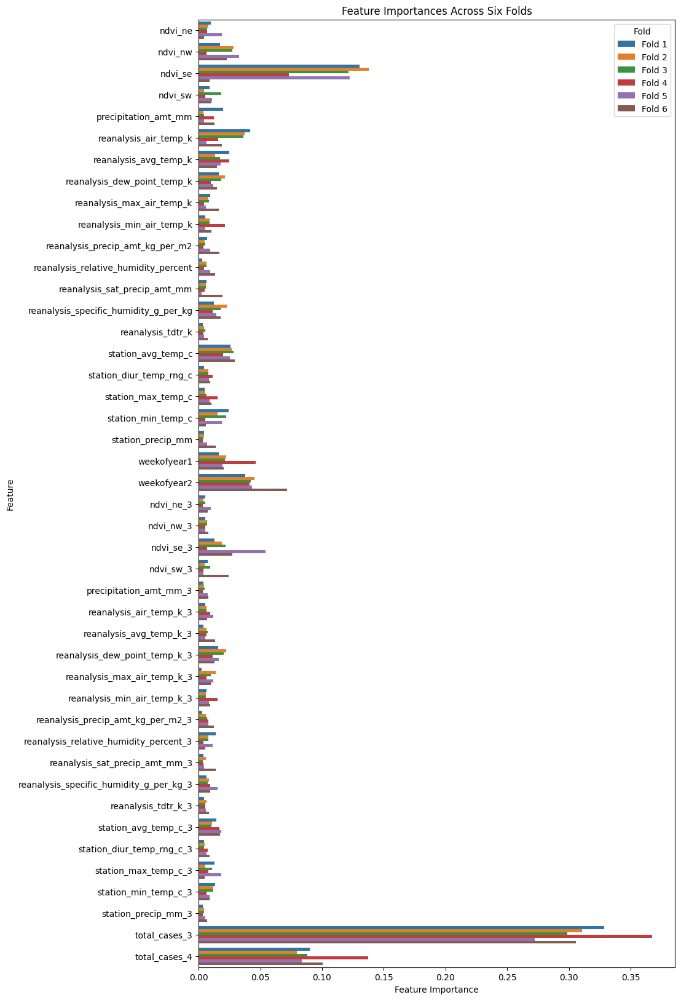

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


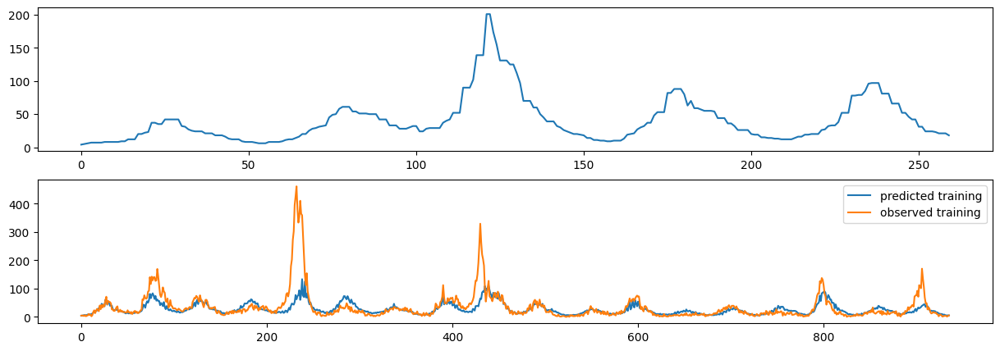

In [6]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

feature_lags = (3,)
lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    # feature_weights[-len(label_lags):] = 100
    feature_weights[-len(label_lags)] = 100
    feature_weights[-1] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

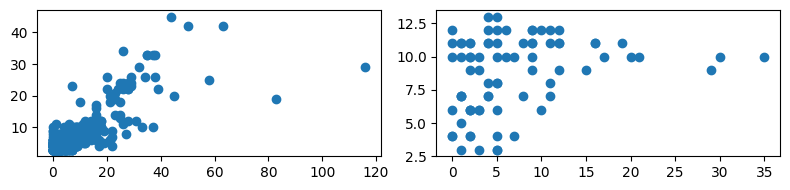

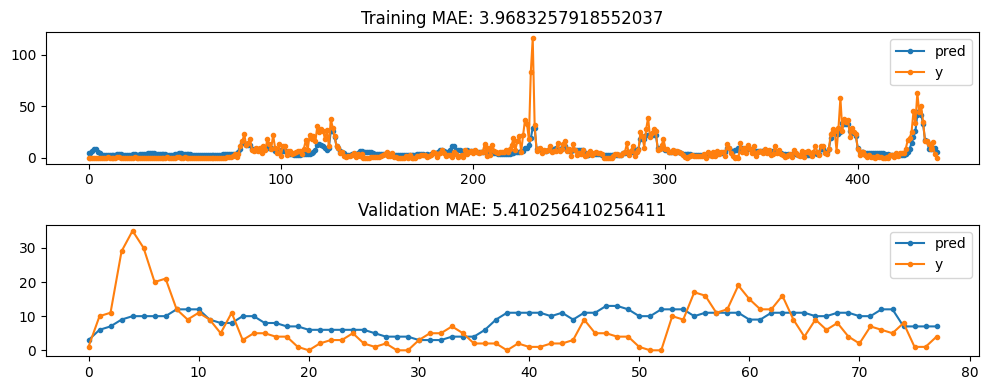

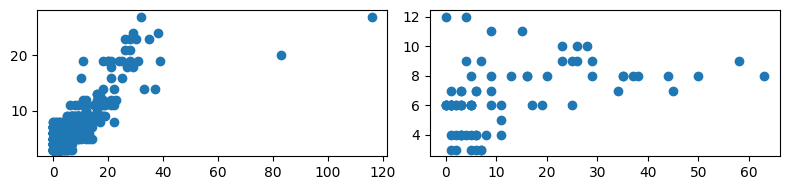

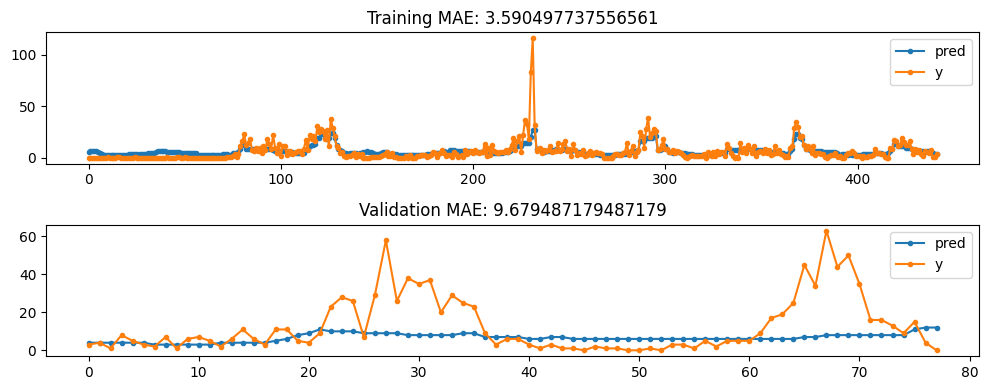

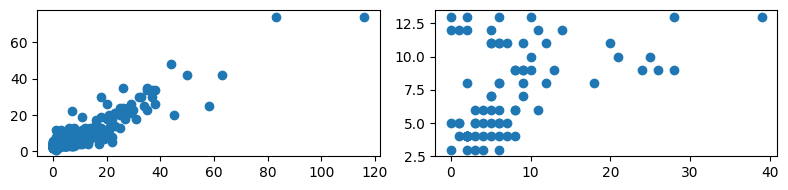

...

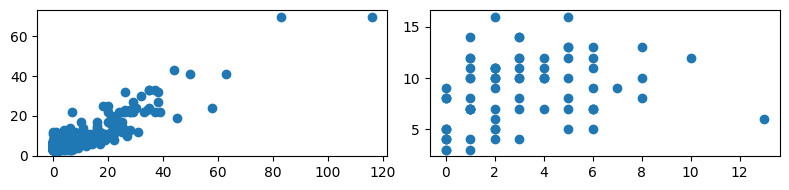

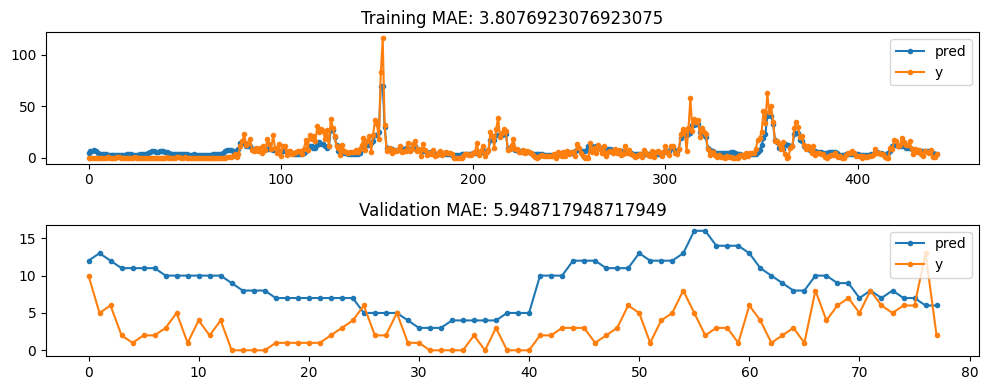

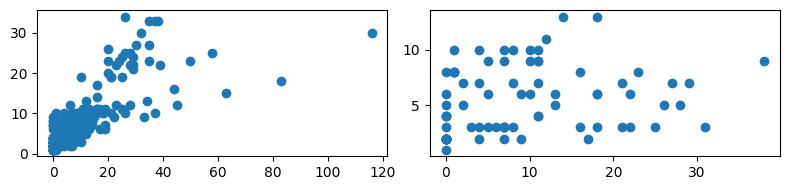

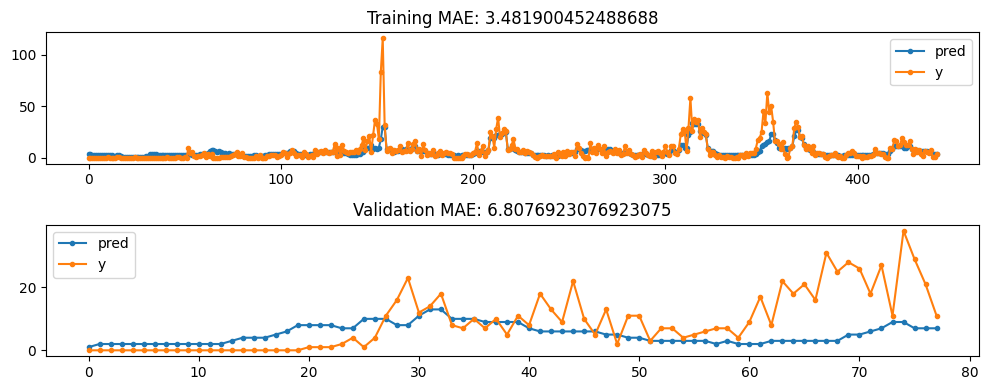

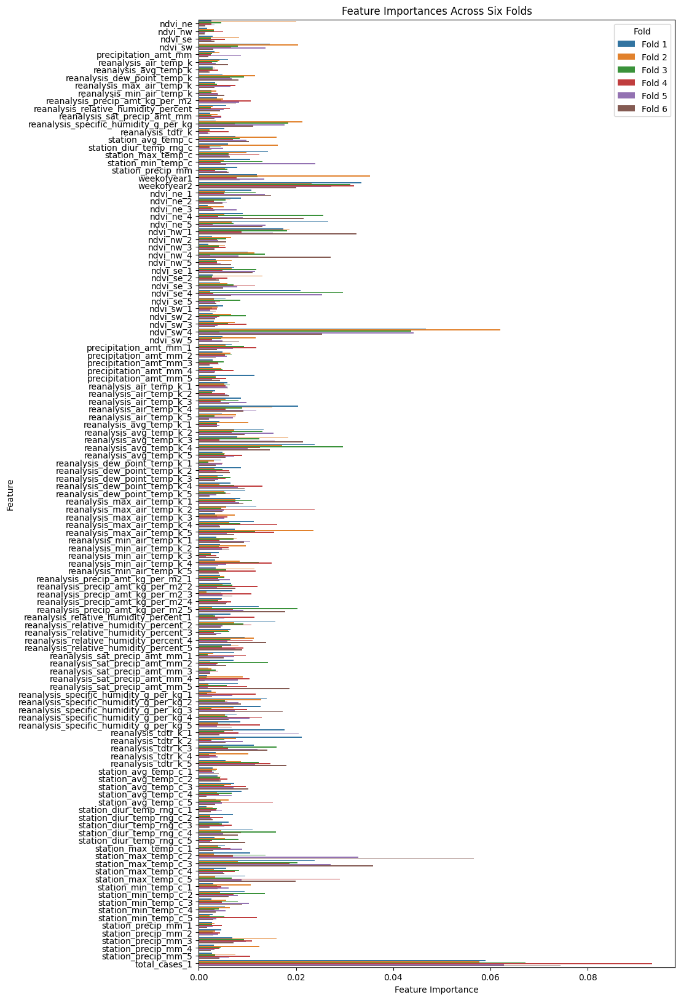

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


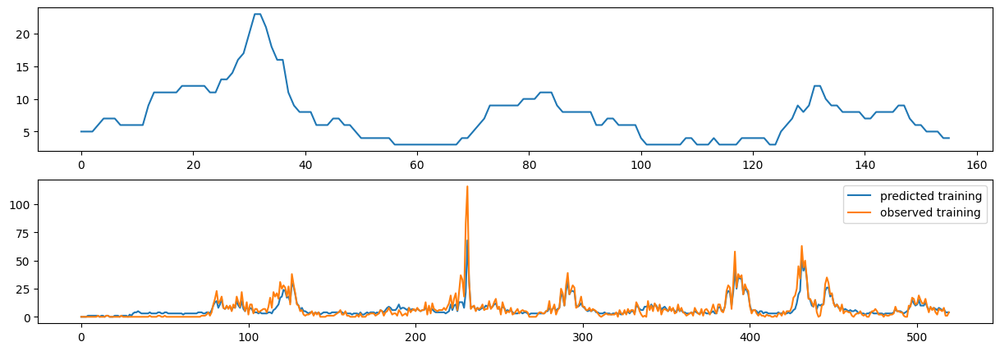

In [7]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(1,)
# label_lags=None

feature_lags = (1,2,3,4,5)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

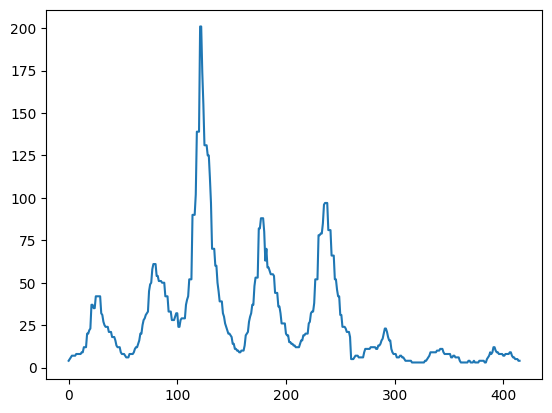

In [8]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_29.csv")

### Sub 30 - working from best case in sub 29


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

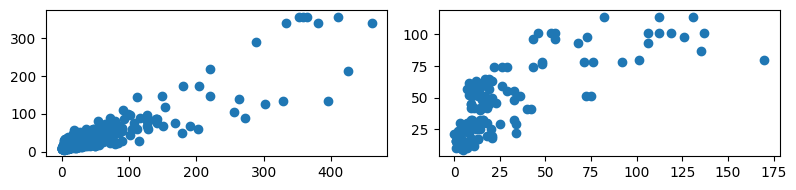

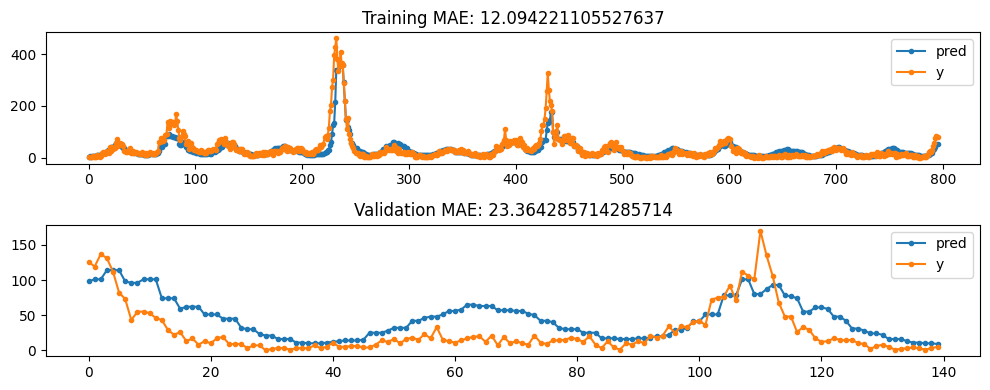

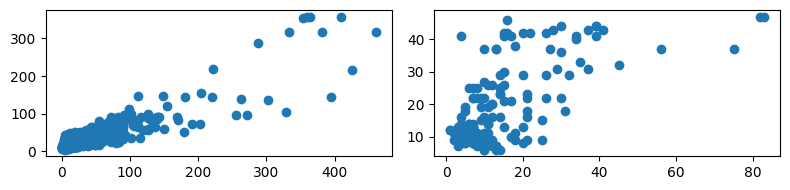

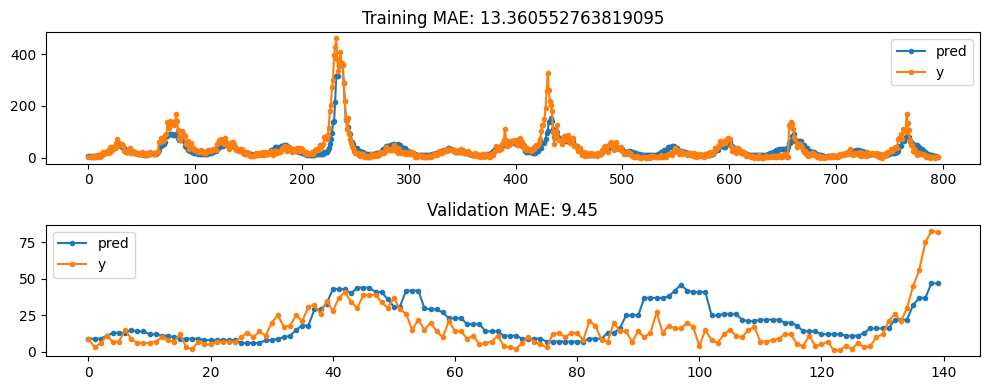

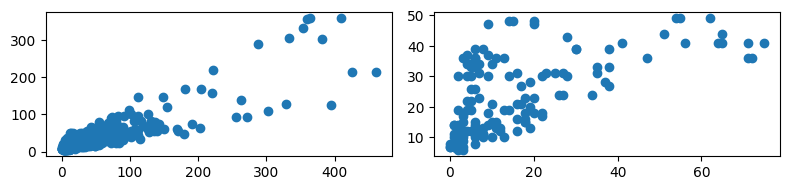

...

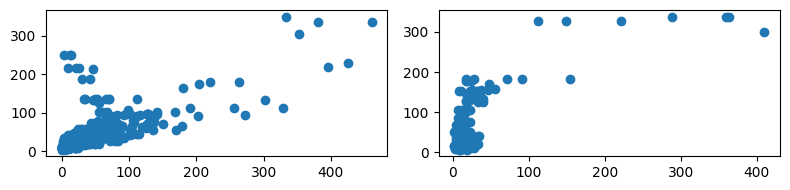

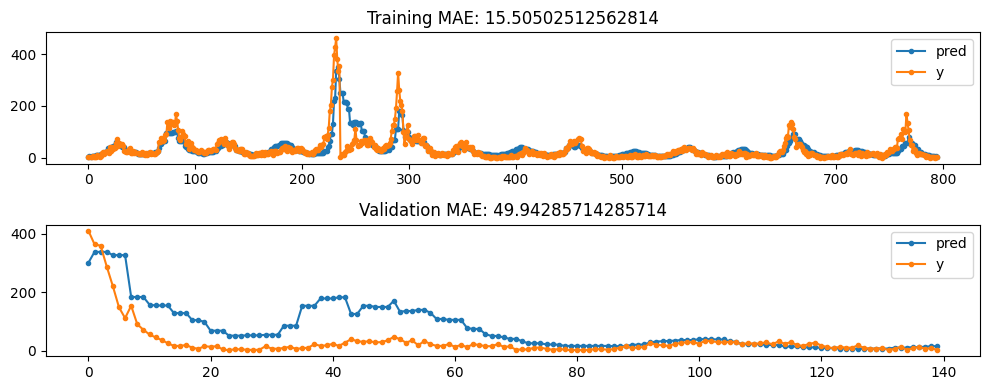

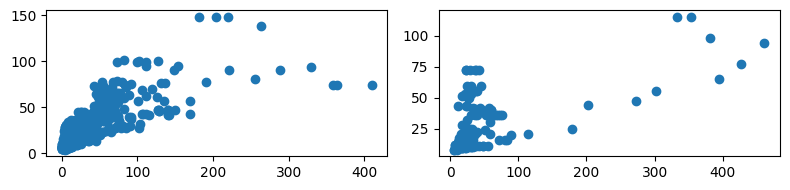

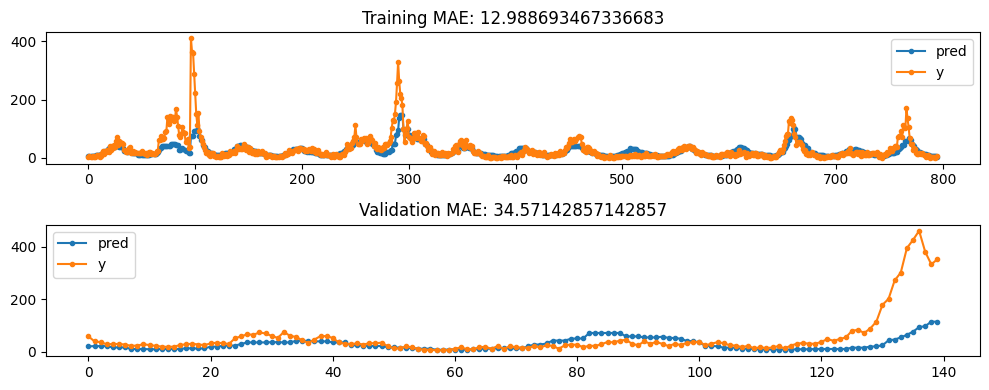

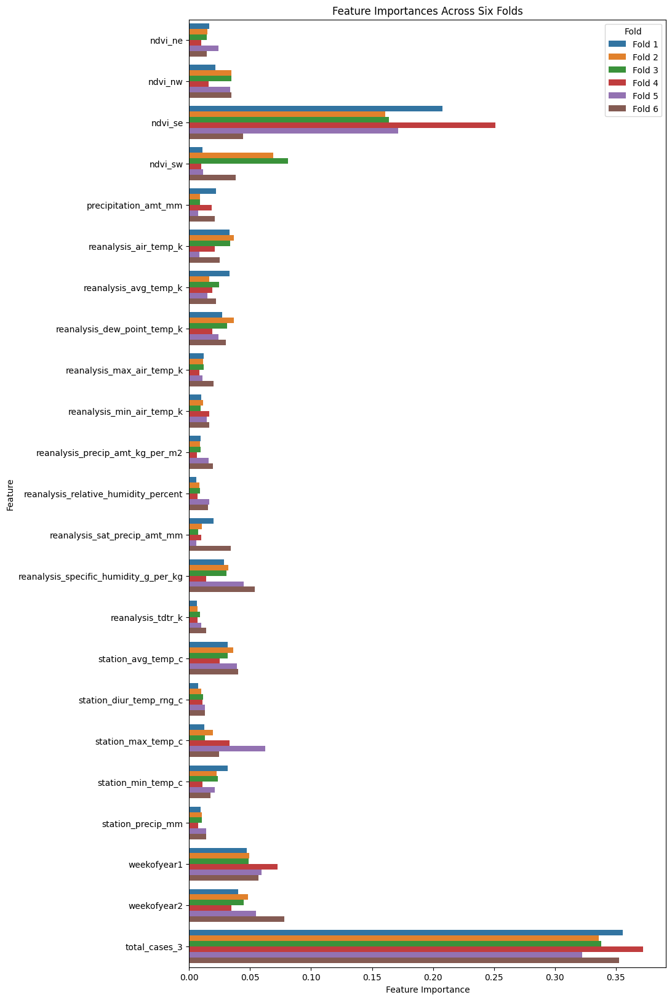

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


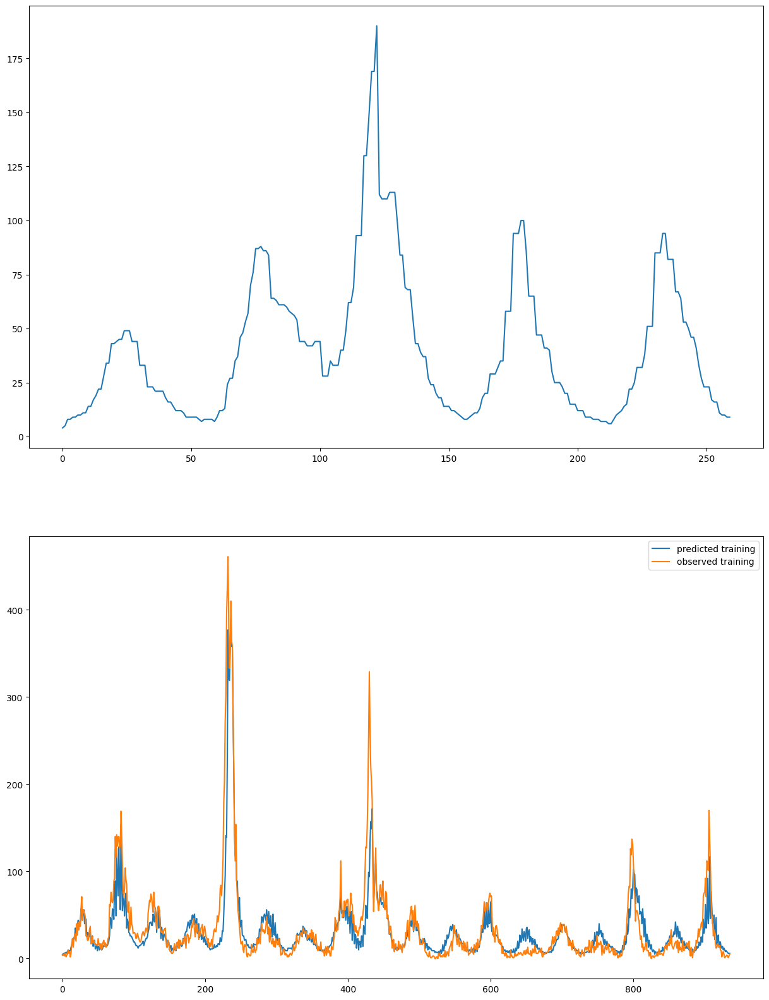

In [43]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,)
# label_lags=None

# feature_lags = (1,2,3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']
feature_lags = ()
lagged_features = []


# feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features={
#     'ndvi_ne':[3],
#     'ndvi_nw':[3],
#     'ndvi_se':[1,2,3],
#     'ndvi_sw':[1,2,3],
#     'precipitation_amt_mm':[3],
#     'reanalysis_air_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_avg_temp_k':[3],
#     'reanalysis_dew_point_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_max_air_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_min_air_temp_k':[3],
#     'reanalysis_precip_amt_kg_per_m2':[3],
#     'reanalysis_relative_humidity_percent':[3],
#     'reanalysis_sat_precip_amt_mm':[3],
#     'reanalysis_specific_humidity_g_per_kg':[12,13,14,15,16,17],
#     'reanalysis_tdtr_k':[3],
#     'station_avg_temp_c':[3],
#     'station_diur_temp_rng_c':[3],
#     'station_max_temp_c':[3],
#     'station_min_temp_c':[9,10],
#     'station_precip_mm':[3]
# }

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100
    # feature_weights[-len(label_lags)] = 100
    # feature_weights[-1] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,20))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

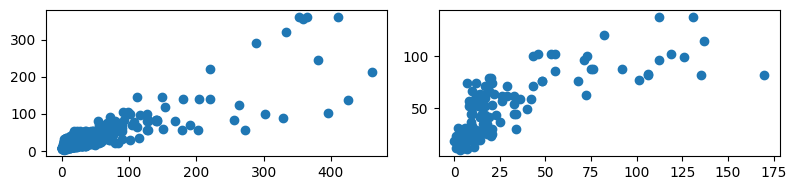

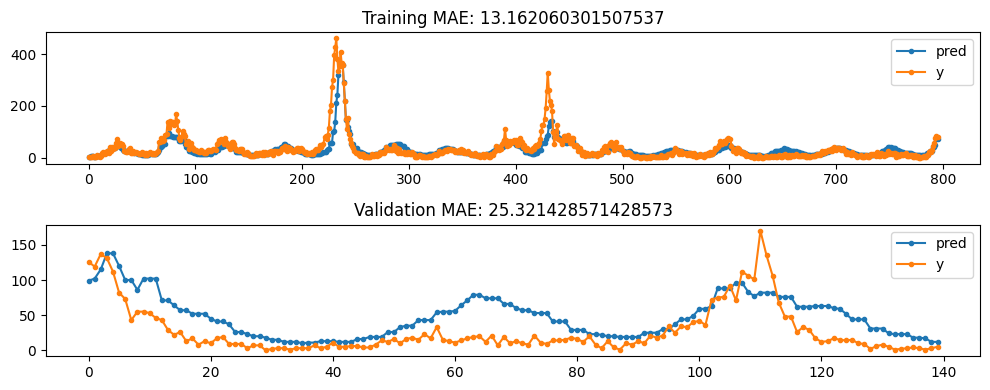

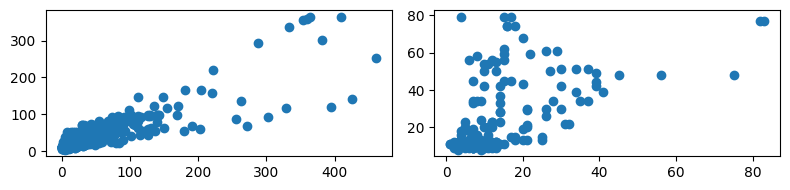

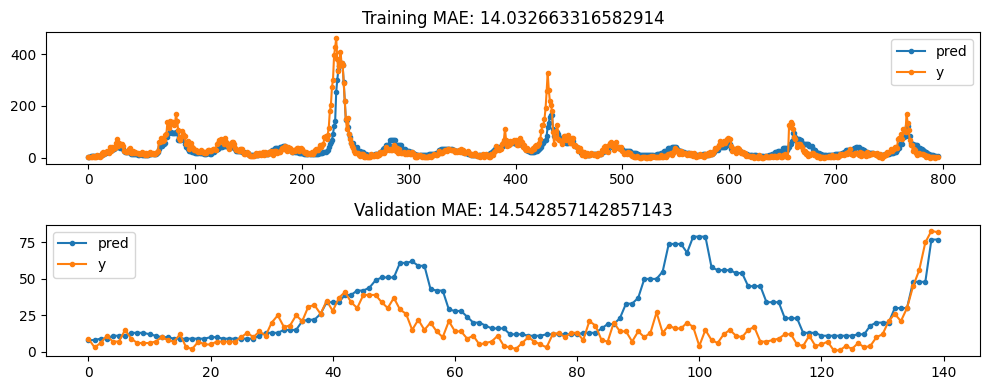

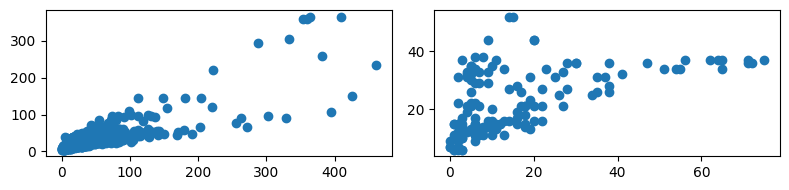

...

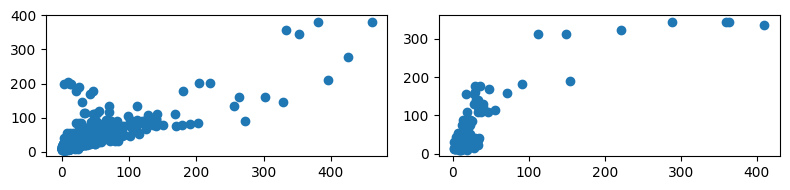

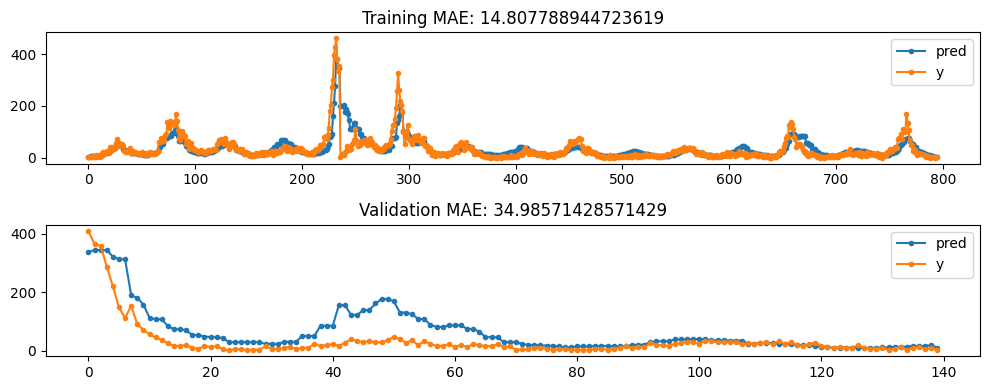

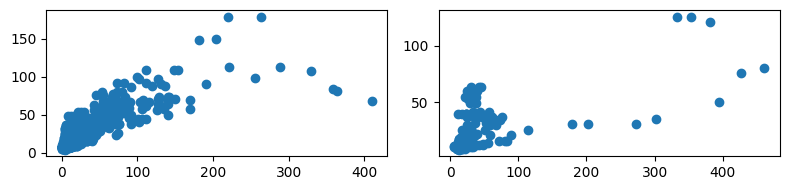

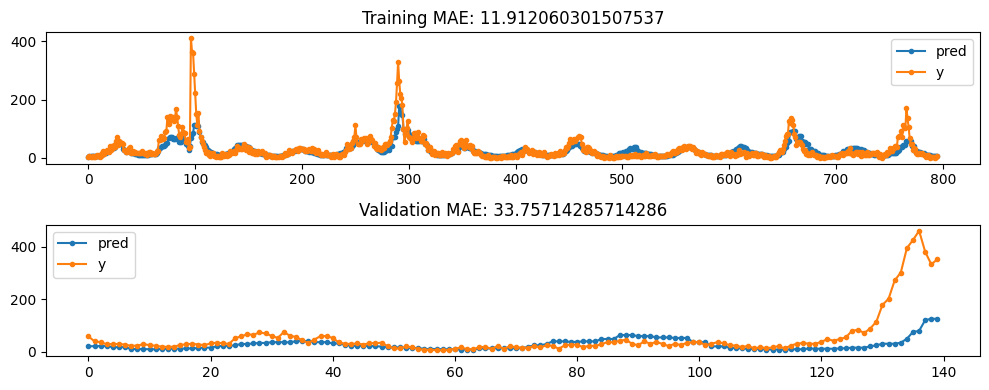

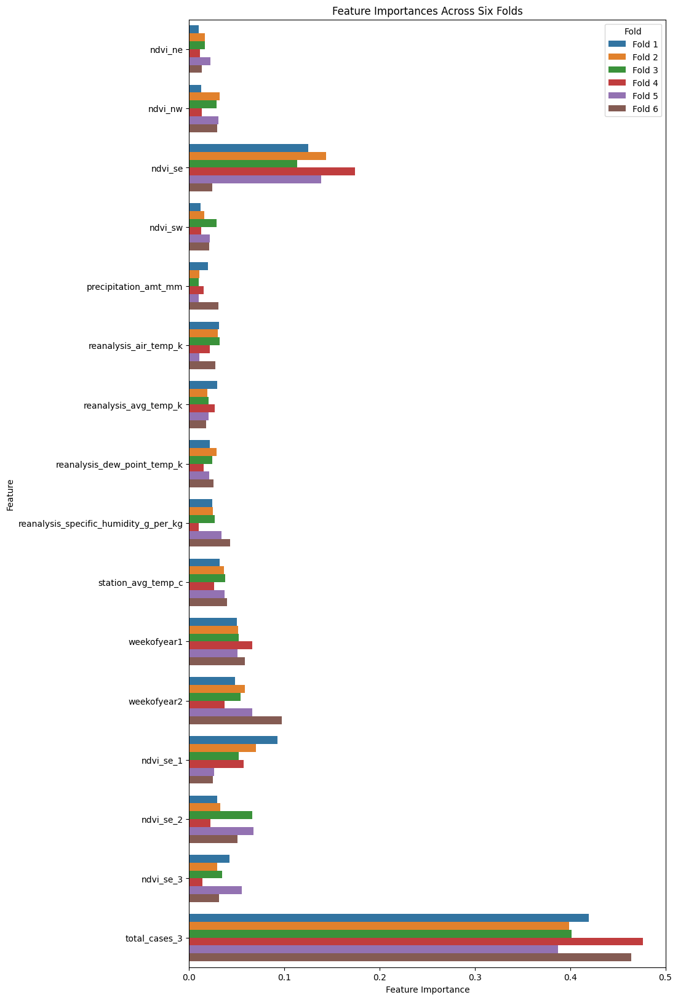

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


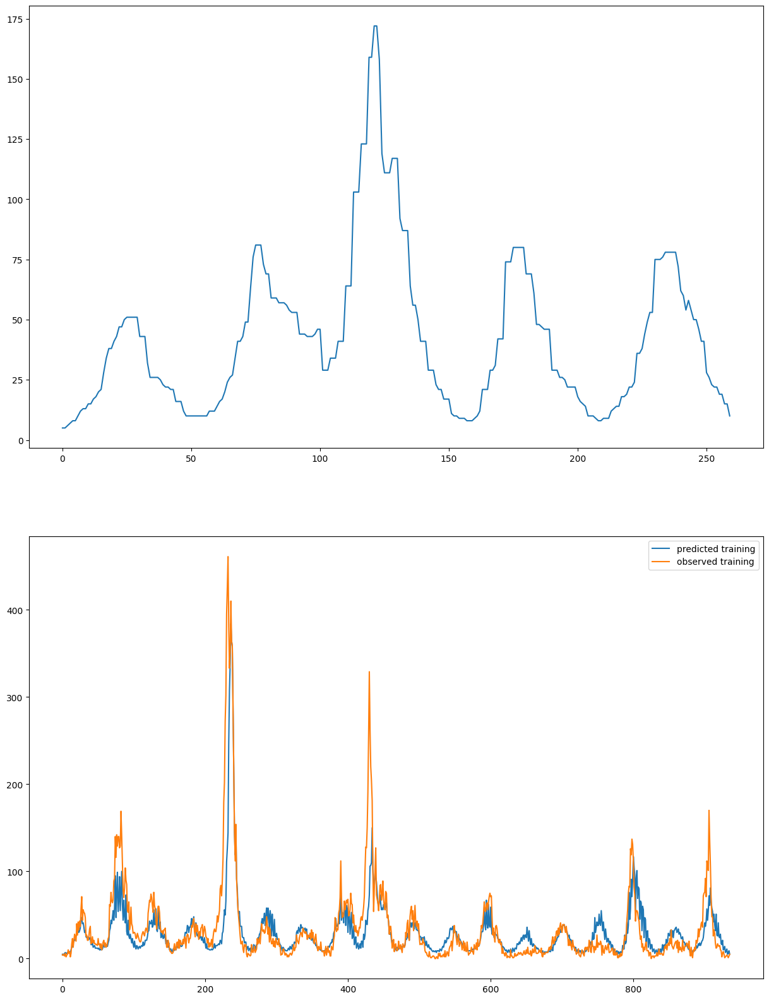

In [29]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []


feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
feature_names.remove('reanalysis_max_air_temp_k')
feature_names.remove('reanalysis_min_air_temp_k')
feature_names.remove('reanalysis_precip_amt_kg_per_m2')
feature_names.remove('reanalysis_relative_humidity_percent')
feature_names.remove('reanalysis_sat_precip_amt_mm')
feature_names.remove('reanalysis_tdtr_k')
feature_names.remove('station_diur_temp_rng_c')
feature_names.remove('station_max_temp_c')
feature_names.remove('station_min_temp_c')
feature_names.remove('station_precip_mm')



label_lags=(3,)
# label_lags=None

# feature_lags = (1,2,3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']
# feature_lags = ()
# lagged_features = []


lagged_features={
#     'ndvi_ne':[3],
#     'ndvi_nw':[3],
    'ndvi_se':[1,2,3],
    # 'ndvi_sw':[1,2,3],
#     'precipitation_amt_mm':[3],
#     'reanalysis_air_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_avg_temp_k':[3],
    # 'reanalysis_dew_point_temp_k':[14,15,16,17],
    # 'reanalysis_max_air_temp_k':[11,12,13,14,15,16,17],
    # 'reanalysis_min_air_temp_k':[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18],
#     'reanalysis_precip_amt_kg_per_m2':[3],
#     'reanalysis_relative_humidity_percent':[3],
#     'reanalysis_sat_precip_amt_mm':[3],
#     'reanalysis_specific_humidity_g_per_kg':[12,13,14,15,16,17],
#     'reanalysis_tdtr_k':[3],
    # 'station_avg_temp_c':[7,8,9],
#     'station_diur_temp_rng_c':[3],
#     'station_max_temp_c':[3],
#     'station_min_temp_c':[9,10],
#     'station_precip_mm':[3]
}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100
    # feature_weights[-len(label_lags)] = 100
    # feature_weights[-1] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,20))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

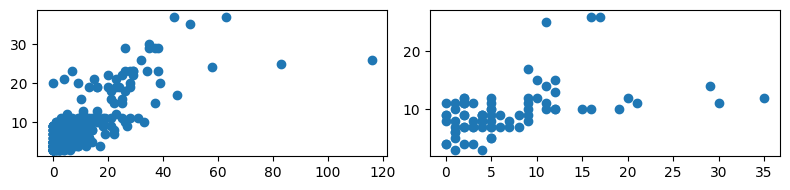

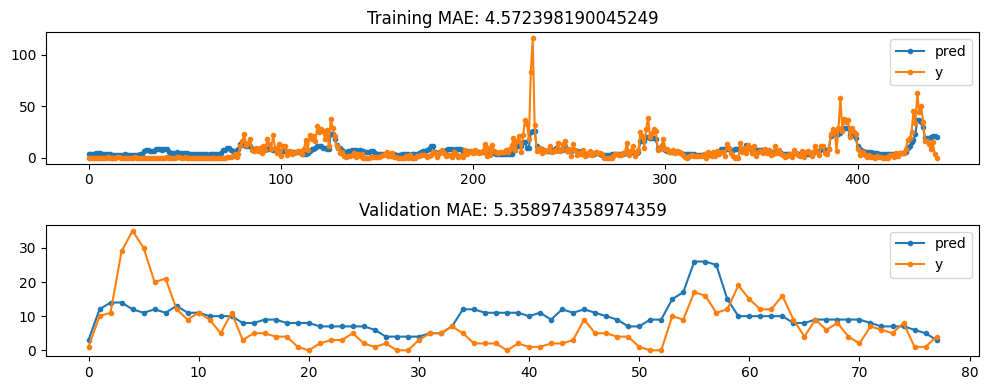

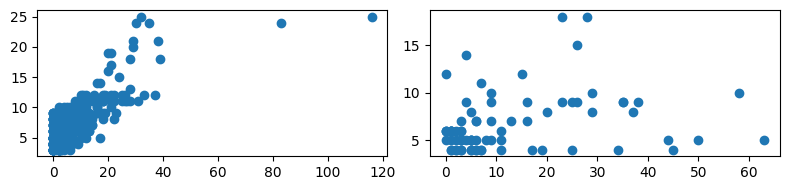

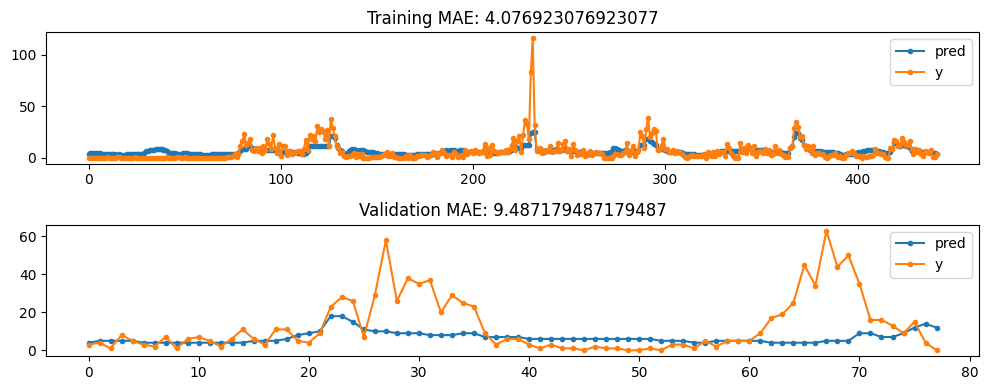

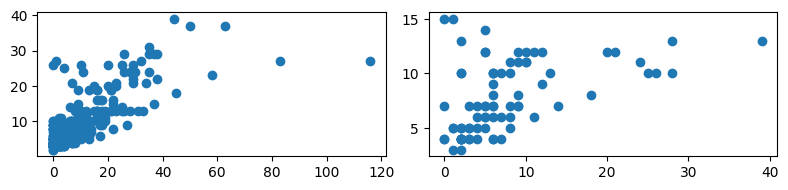

...

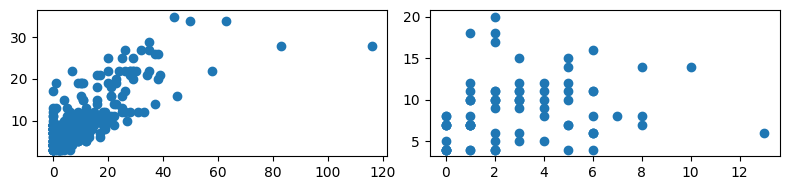

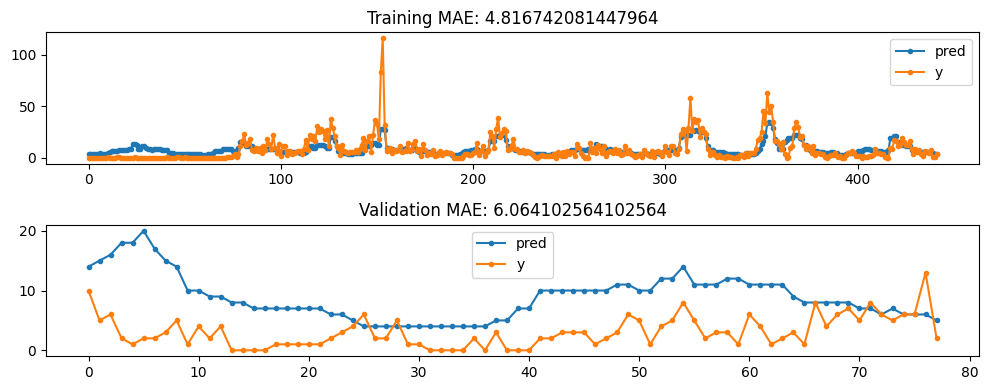

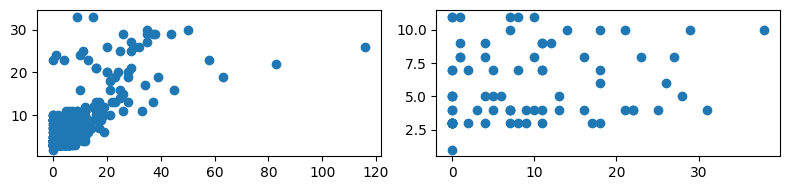

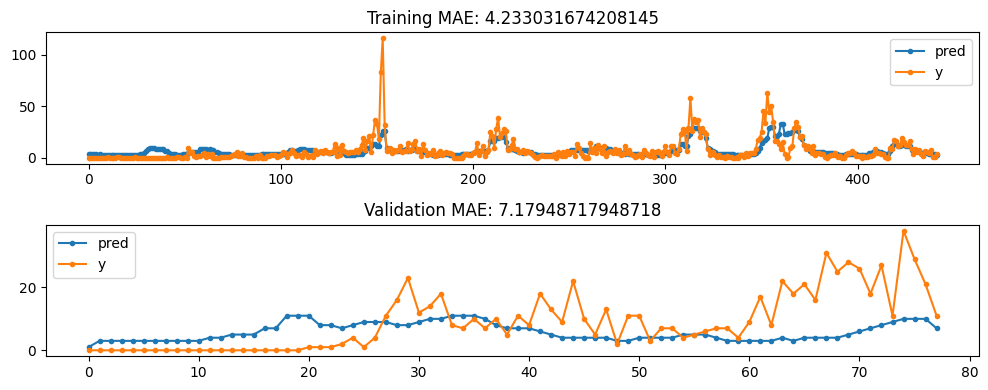

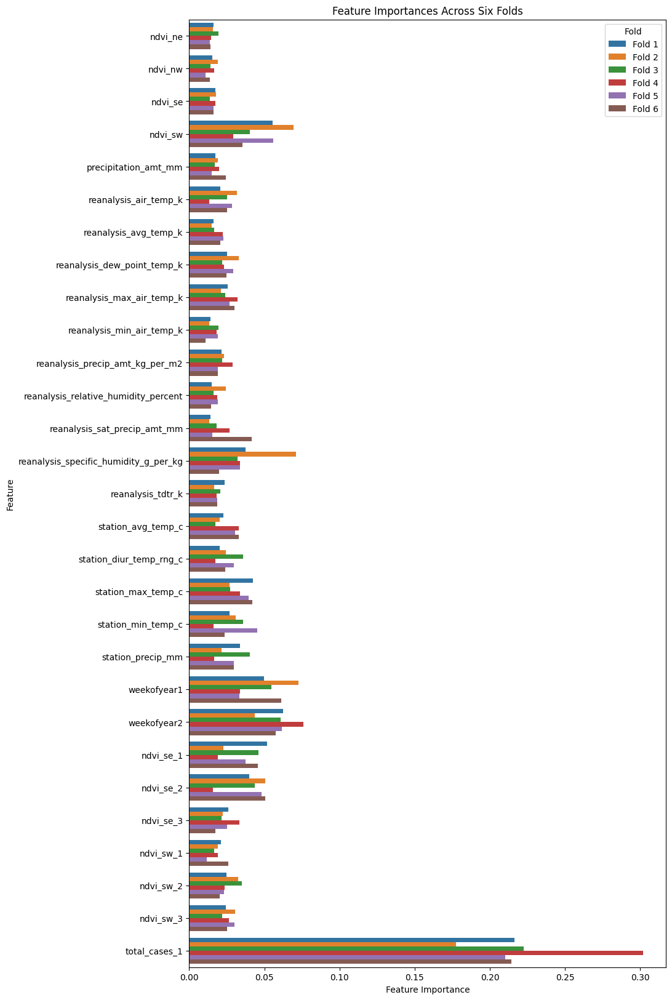

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


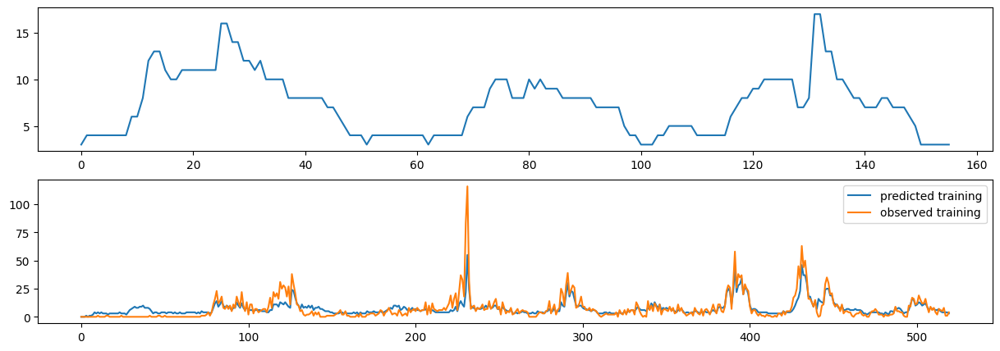

In [39]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []


feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]


label_lags=(1,)
# label_lags=None

# feature_lags = (1,2,3,4,5)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_lags = ()
lagged_features = []


lagged_features = {
    # 'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
    # 'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
    # 'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
    # 'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],
    # 'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]
}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=800
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

    

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

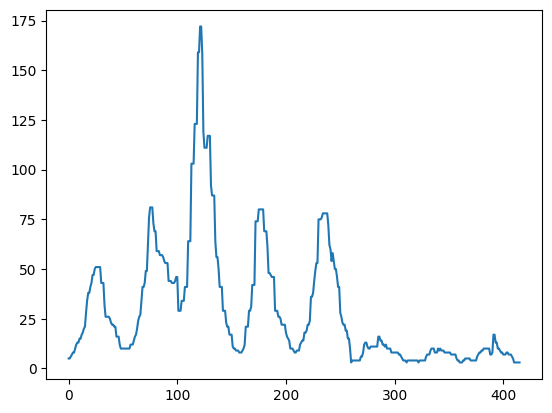

In [40]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_30.csv")

### check earlier values

In [15]:
def create_XGBmodel(eta=0.01,n_estimators=1000,
                    max_depth=5,objective='reg:squarederror',**kwargs):
    return xgb.XGBRegressor(
        learning_rate =eta,
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_child_weight=1.02,
        gamma=0.51,
        subsample=0.86,
        colsample_bytree=0.84,
        objective= objective,
        scale_pos_weight=1,
        seed=42,
        **kwargs)


def modelfit(alg, X_train, y_train, useTrainCV=True, cv_folds=5, early_stopping_rounds=50,trainCV_metrics = 'mae',
             eval_metric = 'mae',report_metric =  metrics.mean_absolute_error, verbose=True,
             weights=None, feature_weights = None):

    if useTrainCV:
        xgb_param = alg.get_xgb_params()
        xgtrain = xgb.DMatrix(X_train, label=y_train,feature_weights=feature_weights)
        xgtrain.set_info(feature_weights=feature_weights)

        if weights is not None:
            xgtrain.set_weight(weights)

        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics=trainCV_metrics, early_stopping_rounds=early_stopping_rounds, verbose_eval=False)
        alg.set_params(n_estimators=cvresult.shape[0])
    
    #Fit the algorithm on the data
    # alg.fit(X_train, y_train, eval_metric=eval_metric, feature_weights=feature_weights)
    alg.fit(X_train, y_train, feature_weights=feature_weights)
        
    #Predict training set:
    X_train_predictions = alg.predict(X_train)
        
    #Print model report:
    if verbose:
        print("\nModel Report")
        print(report_metric)
        print(report_metric(y_train, X_train_predictions))
                    
    # feat_imp = pd.Series(alg.booster().get_fscore()).sort_values(ascending=False)
    # feat_imp.plot(kind='bar', title='Feature Importances')
    # plt.ylabel('Feature Importance Score')


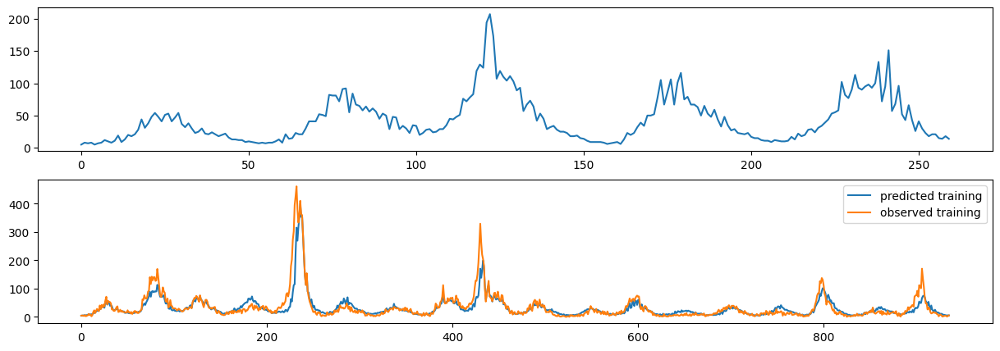

In [21]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = feature_names

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj','weekofyear_3'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 40
else:
    lagged_label_names = []

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)
sj_pred_features_aug.drop(columns='weekofyear_3',inplace=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)

# sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

In [12]:
model_sj_new = model_sj
sj_pred_features_new = sj_pred_features_aug

In [7]:
with open('./temp/model_sj_old.pkl','rb') as f:
    model_sj_old = pickle.load(f)
sj_pred_features_old = pd.read_csv('./temp/sj_test_features_aug_old.csv')
sj_train_labels_old = pd.read_csv('./temp/sj_train_labels_old.csv')
sj_train_features_old = pd.read_csv('./temp/sj_train_features_old.csv')

# issue not with data cleaning or processing, difference in model trained itself.

# plt.plot(get_predictions(model_sj_new, sj_pred_features_old[sj_pred_features_new.columns], label_lags))
# plt.plot(get_predictions(model_sj_old, sj_pred_features_new[sj_pred_features_old.columns], label_lags))
# plt.plot(get_predictions(model_sj_old, sj_pred_features_old, label_lags))
# plt.plot(get_predictions(model_sj_new, sj_pred_features_new, label_lags))

# plt.plot(get_predictions(model_sj_new, X_train_sj.sort_index(), label_lags))
# plt.plot(get_predictions(model_sj_old, X_train_sj.sort_index()[sj_pred_features_old.columns], label_lags))


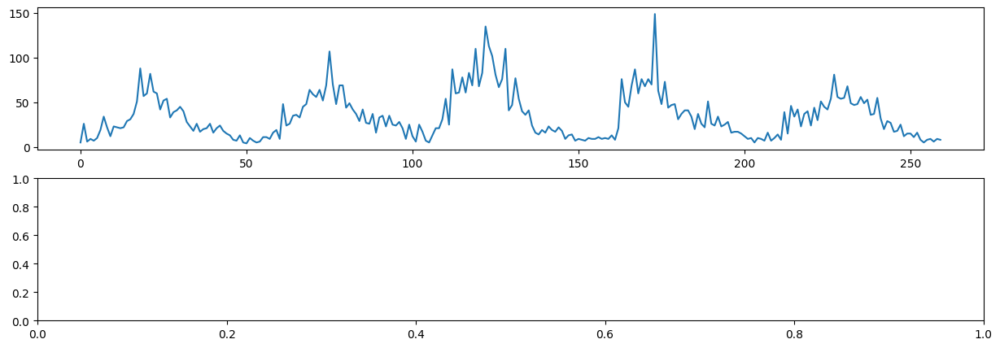

In [9]:
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = feature_names

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj','weekofyear_3'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 1
else:
    lagged_label_names = []

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, sj_train_features_old, sj_train_labels_old,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)


if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)
sj_pred_features_aug.drop(columns='weekofyear_3',inplace=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_old, label_lags)

# sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
# sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
# axs[1].plot(sj_train_pred,label='predicted training')
# axs[1].plot(sj_labels,label='observed training')
# axs[1].legend()

In [20]:
sj_pred_features_aug.to_csv('sj_test_features_aug_new.csv',index=None)
y_train_sj.sort_index().to_csv('sj_train_labels_new.csv',index=None)
X_train_sj.sort_index().to_csv('sj_train_features_new.csv',index=None)
with open('model_sj_new.pkl','wb') as f:
    pickle.dump(model_sj,f)

## Predict and Submit

### San Juan

In [36]:
# sj training data
label_lags=(3,4)
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13)

lagged_features = temp_feature_names
train_features = preprocess(train_features_or,temp_feature_names,
                            lagged_features,feature_lags,is_label_lagged=True,label_lags=label_lags,labels=train_labels)

feature_weights = 100*np.ones(train_features.shape[1])
feature_weights[-len(label_lags):] = 0.1

sj_mask = train_features['city_sj']
iq_mask = ~sj_mask
sj_train_features = train_features.copy().loc[sj_mask,[col for col in train_features.columns if col != 'city_sj']]
sj_train_labels = train_labels[sj_mask]

# sj load augmented (with lagged labels) test features
lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
datapath = '/kaggle/input/data/' # kaggle
test_features_aug_or = pd.read_csv(datapath+'/dengue_features_test2.csv',
                             index_col=[1,2])
test_features_aug = preprocess(test_features_aug_or,
                               temp_feature_names+lagged_label_names,
                               lagged_features,feature_lags,is_label_lagged=False)
sj_mask = test_features_aug['city_sj']
iq_mask = ~sj_mask
sj_test_features_aug = test_features_aug.copy().loc[sj_mask,[col for col in test_features_aug.columns if col != 'city_sj']]
order_needed = sj_train_features.columns.to_list()
sj_test_features_aug = sj_test_features_aug[order_needed]

# sj. Predict and submit
xg_reg_sj = create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=6,objective='reg:squarederror',reg_alpha=10,reg_lambda=1)
modelfit(xg_reg_sj, sj_train_features, sj_train_labels, useTrainCV=True,
         cv_folds=5, early_stopping_rounds=50,trainCV_metrics = 'mae',
         eval_metric = 'mae',report_metric = metrics.mean_absolute_error,
         feature_weights=feature_weights)
sj_pred_val = get_predictions(xg_reg_sj,sj_test_features_aug,label_lags,is_label_lagged=True,MC=None)

Found 1 CUDA devices
id 0    b'Tesla P100-PCIE-16GB'                              [SUPPORTED]
                      Compute Capability: 6.0
                           PCI Device ID: 4
                              PCI Bus ID: 0
                                    UUID: GPU-4c95d397-4f06-4129-9c0f-8da5091dcd4d
                                Watchdog: Disabled
             FP32/FP64 Performance Ratio: 2
Summary:
	1/1 devices are supported

Model Report
<function mean_absolute_error at 0x7a7226166b00>
1.1997620672242255


In [37]:
sj_pred_val2 = get_predictions(xg_reg_sj,
                               pd.concat([sj_train_features,sj_test_features_aug]),
                               label_lags,is_label_lagged=True,MC=None)

In [38]:
sj_pred_val3 = get_predictions(xg_reg_sj,
                               sj_train_features,
                               label_lags,is_label_lagged=True,MC=None)

3.751068376068376


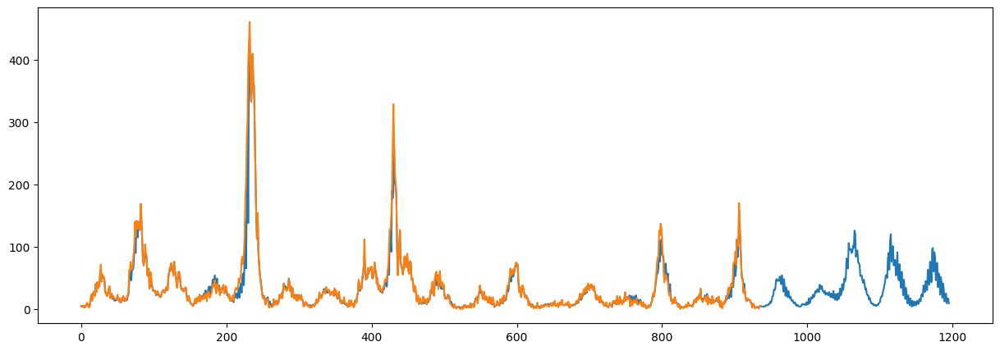

In [39]:
fig,ax = plt.subplots(1,1,figsize=(15,5))
ax.plot(sj_pred_val2)
ax.plot(sj_train_labels)
# ax.plot(xg_reg_sj.predict(sj_train_features),linestyle='dotted')
print(mean_absolute_error(sj_pred_val3,sj_train_labels))

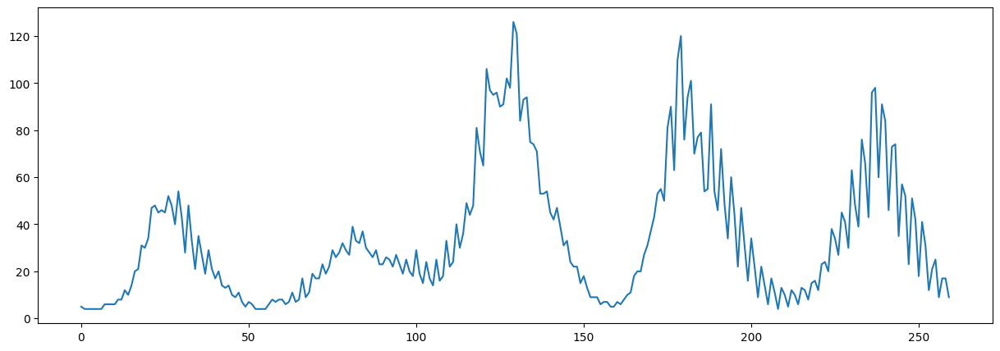

In [40]:
fig,ax = plt.subplots(1,1,figsize=(15,5))
ax.plot(sj_pred_val)
# ax.plot(sj_train_labels)

### Iquitos

In [24]:
# iq training data
label_lags=(3,4)
feature_lags=(1,4)

lagged_features = temp_feature_names
train_features = preprocess(train_features_or,temp_feature_names,
                            lagged_features,feature_lags,is_label_lagged=True,label_lags=label_lags,labels=train_labels)

feature_weights = 100*np.ones(train_features.shape[1])
feature_weights[-len(label_lags):] =1

sj_mask = train_features['city_sj']
iq_mask = ~sj_mask

iq_train_features = train_features.copy().loc[iq_mask,[col for col in train_features.columns if col != 'city_sj']]
iq_train_labels = train_labels[iq_mask]
sj_train_features_new = train_features.copy().loc[sj_mask,[col for col in train_features.columns if col != 'city_sj']]
sj_train_labels_new = train_labels[sj_mask]

# iq load augmented (with lagged labels) test features
lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
datapath = '/kaggle/input/data/' # kaggle
test_features_aug_or = pd.read_csv(datapath+'/dengue_features_test2.csv',
                             index_col=[1,2])
test_features_aug = preprocess(test_features_aug_or,
                               temp_feature_names+lagged_label_names,
                               lagged_features,feature_lags,is_label_lagged=False)
sj_mask = test_features_aug['city_sj']
iq_mask = ~sj_mask
iq_test_features_aug = test_features_aug.copy().loc[iq_mask,[col for col in test_features_aug.columns if col != 'city_sj']]
order_needed = iq_train_features.columns.to_list()
iq_test_features_aug = iq_test_features_aug[order_needed]

# iq. Predict and submit
xg_reg_iq = create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=6,objective='reg:squarederror',reg_alpha=1,reg_lambda=1)
modelfit(xg_reg_iq,
         pd.concat([sj_train_features_new,iq_train_features]),
         pd.concat([sj_train_labels_new,iq_train_labels]),
         useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
         trainCV_metrics = 'mae', eval_metric = 'mae',
         report_metric = metrics.mean_absolute_error,feature_weights=feature_weights)
iq_pred_val = get_predictions(xg_reg_iq,iq_test_features_aug,label_lags,is_label_lagged=True,MC=None)


Found 1 CUDA devices
id 0    b'Tesla P100-PCIE-16GB'                              [SUPPORTED]
                      Compute Capability: 6.0
                           PCI Device ID: 4
                              PCI Bus ID: 0
                                    UUID: GPU-a9069107-d436-0b32-e83a-678b4b4aaa06
                                Watchdog: Disabled
             FP32/FP64 Performance Ratio: 2
Summary:
	1/1 devices are supported

Model Report
<function mean_absolute_error at 0x7d913354a440>
2.621568126337869


In [25]:
iq_pred_val2 = get_predictions(xg_reg_iq,
                               pd.concat([iq_train_features,iq_test_features_aug]),
                               label_lags,is_label_lagged=True,MC=None)
iq_pred_val3 = get_predictions(xg_reg_iq,
                               iq_train_features,
                               label_lags,is_label_lagged=True,MC=None)

4.157692307692308


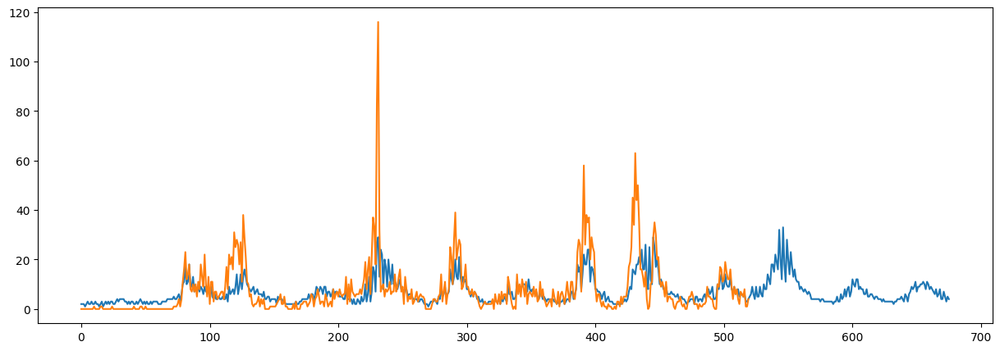

In [26]:
fig,ax = plt.subplots(1,1,figsize=(15,5))
ax.plot(iq_pred_val2)
ax.plot(iq_train_labels.reset_index(drop=True))
print(mean_absolute_error(iq_pred_val3,iq_train_labels))

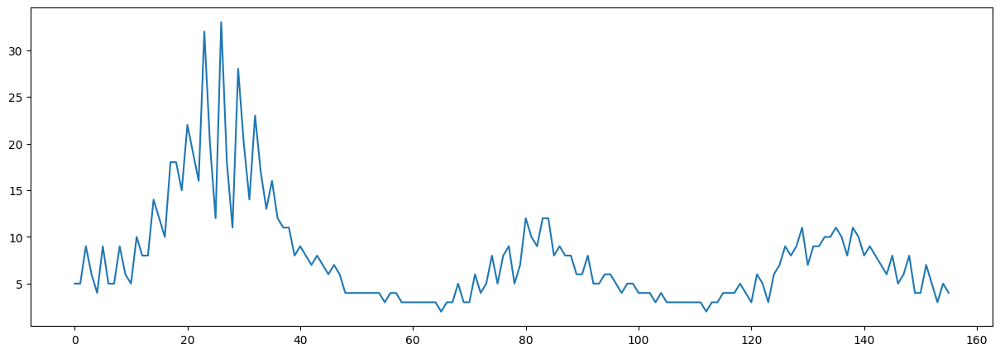

In [27]:
fig,ax = plt.subplots(1,1,figsize=(15,5))
ax.plot(iq_pred_val)

In [ ]:
# pred_sj = np.round(sj_pred_val).astype('int')
# pred_iq = np.round(iq_pred_val).astype('int')
# pred_all = np.concatenate([pred_sj,pred_iq])
# plt.plot(pred_all)

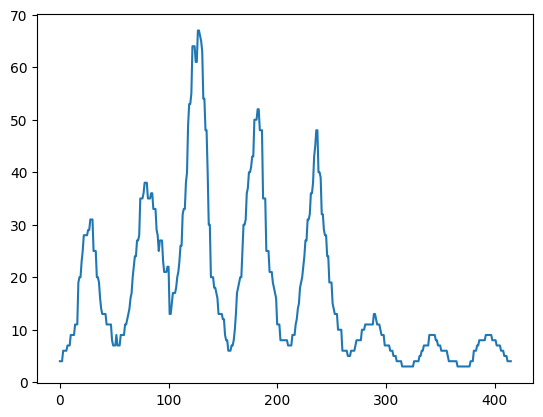

In [31]:
from scipy.signal import medfilt

pred_all_filt = medfilt(pred_all,3)
plt.plot(pred_all_filt)

In [33]:
# with medfilt
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])

submission.total_cases = pred_all.astype(int)
submission.to_csv("./submission_18.csv")